# AirBnb in London price prediction

# Contents

- [Data Cleaning](#data-cleaning)
- [Initial Analysis](#dropping-initial-columns)
- [Collinearity of Minimum and Maximum nights columns](#nights-columns)
- [Host Related Columns](#host-related-columns)
- [Property Type](#property_type)
- [Bathrooms, Bedrooms, and Beds](#bathrooms-bedrooms-beds)
- [First_review and last_review](#first-last-review)
- [Review Scores](#review_scores)
- [Amenities](#amenities)
- [Host Response](#host-response)
- [Dealing with outliers in prices](#price-outliers)
- [Colinearity in Features containing listings_count](#listings_count)


- [Exploratory Data Analysis](#eda)
    - [1. What does the overall price distribution in Airbnb, London?](#q1)
    - [2. For listings without bookings, what does their price distribution look like?](#q2)
    - [3.Is incorrect pricing the reason for those listings that had no bookings?](#q3)
        - [3a. ](#q3a)
         - [3b. ](#q3b)
          - [](#q3b_price)
          - [](#q3b_price_rooms)
  
- [Correlation Analysis](#correlation-analysis)
    - [Pearson correlation with Price](#pearson)
- [Modeling](#modeling)
- [Previous workings](#previous)

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from datetime import datetime, timedelta
import re

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Ridge,Lasso
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import ExtraTreesRegressor, RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from matplotlib.dates import DateFormatter


In [5]:
#import data:
raw_listings = pd.read_csv('06 Nov 2020 listings.csv') # (76984, 74)


# Data Cleaning <a class="anchor" id="data-cleaning"></a>

In [6]:
pd.set_option("display.max_columns", raw_listings.shape[1]) #display all columns
print(raw_listings.shape)
raw_listings.head()

(76984, 74)


,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,11551,https://www.airbnb.com/rooms/11551,2.020110e+13,07/11/2020,Arty and Bright London Apartment in Zone 2,Unlike most rental apartments out there my fla...,Not even 10 minutes by metro from Victoria Sta...,https://a0.muscache.com/pictures/b7afccf4-18e5...,43039,https://www.airbnb.com/users/show/43039,Adriano,03/10/2009,"London, England, United Kingdom","Hello, I'm a friendly Italian man with a very ...",within an hour,100%,100%,f,https://a0.muscache.com/im/pictures/user/47773...,https://a0.muscache.com/im/pictures/user/47773...,Brixton,3.0,3.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...",t,t,"London, United Kingdom",Lambeth,NaN,51.46225,-0.11732,Entire apartment,Entire home/apt,4,NaN,1 bath,1.0,3.0,"[""Cable TV"", ""Coffee maker"", ""Carbon monoxide ...",$97.00,7,190,7,28,1125,1125,8.4,1125.0,NaN,t,0,0,4,279,07/11/2020,192,7,0,21/03/2010,26/03/2020,91.0,9.0,9.0,10.0,10.0,9.0,9.0,NaN,t,2,2,0,0,1.48
1,13913,https://www.airbnb.com/rooms/13913,2.020110e+13,07/11/2020,Holiday London DB Room Let-on going,My bright double bedroom with a large window h...,Finsbury Park is a friendly melting pot commun...,https://a0.muscache.com/pictures/miso/Hosting-...,54730,https://www.airbnb.com/users/show/54730,Alina,16/11/2009,"London, England, United Kingdom",I am a Multi-Media Visual Artist and Creative ...,within a day,83%,71%,f,https://a0.muscache.com/im/users/54730/profile...,https://a0.muscache.com/im/users/54730/profile...,LB of Islington,3.0,3.0,"['email', 'phone', 'facebook', 'reviews', 'off...",t,t,"Islington, Greater London, United Kingdom",Islington,NaN,51.56802,-0.11121,Private room in apartment,Private room,2,NaN,1 shared bath,1.0,0.0,"[""Cable TV"", ""Bed linens"", ""Coffee maker"", ""Pa...",$40.00,1,29,1,28,29,29,2.8,29.0,NaN,t,30,60,90,365,07/11/2020,21,2,0,18/08/2010,22/02/2020,97.0,10.0,10.0,10.0,10.0,9.0,9.0,NaN,f,2,1,1,0,0.17
2,15400,https://www.airbnb.com/rooms/15400,2.020110e+13,07/11/2020,Bright Chelsea Apartment. Chelsea!,Lots of windows and light. St Luke's Gardens ...,It is Chelsea.,https://a0.muscache.com/pictures/428392/462d26...,60302,https://www.airbnb.com/users/show/60302,Philippa,05/12/2009,"Kensington, England, United Kingdom","English, grandmother, I have travelled quite ...",within a day,100%,100%,f,https://a0.muscache.com/im/users/60302/profile...,https://a0.muscache.com/im/users/60302/profile...,Chelsea,1.0,1.0,"['email', 'phone', 'reviews', 'jumio', 'govern...",t,t,"London, United Kingdom",Kensington and Chelsea,NaN,51.48796,-0.16898,Entire apartment,Entire home/apt,2,NaN,1 bath,1.0,1.0,"[""Cable TV"", ""Coffee maker"", ""Dryer"", ""Dishes ...",$75.00,10,50,10,28,50,50,11.2,50.0,NaN,t,0,20,50,150,07/11/20

In [132]:
raw_listings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 76984 entries, 0 to 76983
Data columns (total 74 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            76984 non-null  int64  
 1   listing_url                                   76984 non-null  object 
 2   scrape_id                                     76984 non-null  float64
 3   last_scraped                                  76984 non-null  object 
 4   name                                          76961 non-null  object 
 5   description                                   73931 non-null  object 
 6   neighborhood_overview                         47836 non-null  object 
 7   picture_url                                   76984 non-null  object 
 8   host_id                                       76984 non-null  int64  
 9   host_url                                      76984 non-null 

In [133]:
raw_listings.dtypes.value_counts() 

object     33
float64    21
int64      20
dtype: int64

In [136]:
objectColumns = raw_listings.dtypes[raw_listings.dtypes == np.object]
objectColumns

listing_url               object
last_scraped              object
name                      object
description               object
neighborhood_overview     object
picture_url               object
host_url                  object
host_name                 object
host_since                object
host_location             object
host_about                object
host_response_time        object
host_response_rate        object
host_acceptance_rate      object
host_is_superhost         object
host_thumbnail_url        object
host_picture_url          object
host_neighbourhood        object
host_verifications        object
host_has_profile_pic      object
host_identity_verified    object
neighbourhood             object
neighbourhood_cleansed    object
property_type             object
room_type                 object
bathrooms_text            object
amenities                 object
price                     object
has_availability          object
calendar_last_scraped     object
first_revi

In [137]:
nonObjectCol = raw_listings.dtypes[raw_listings.dtypes != np.object]
nonObjectCol

id                                                int64
scrape_id                                       float64
host_id                                           int64
host_listings_count                             float64
host_total_listings_count                       float64
neighbourhood_group_cleansed                    float64
latitude                                        float64
longitude                                       float64
accommodates                                      int64
bathrooms                                       float64
bedrooms                                        float64
beds                                            float64
minimum_nights                                    int64
maximum_nights                                    int64
minimum_minimum_nights                            int64
maximum_minimum_nights                            int64
minimum_maximum_nights                            int64
maximum_maximum_nights                          

In [6]:
pd.set_option("display.max_rows", raw_listings.shape[0])
raw_listings.isnull().sum().sort_values(ascending=False)

neighbourhood_group_cleansed                    76984
license                                         76984
bathrooms                                       76984
calendar_updated                                76984
host_response_time                              37618
host_response_rate                              37618
host_about                                      33765
neighborhood_overview                           29148
neighbourhood                                   29147
host_acceptance_rate                            28432
review_scores_checkin                           23603
review_scores_value                             23602
review_scores_location                          23601
review_scores_accuracy                          23555
review_scores_communication                     23552
review_scores_cleanliness                       23545
review_scores_rating                            23490
first_review                                    21733
last_review                 

In [224]:
#Brief Insight of listing

print("Number of properties:")
print(len(raw_listings["id"]))

print("Number of unique host:")
print(len(raw_listings["host_name"].unique()))

print("Number of unique host id:")
print(len(raw_listings["host_id"].unique()))

print("Number of Room Type:")
print(len(raw_listings["room_type"].unique()))

print("Number of Borough:")
print(len(raw_listings["neighbourhood_cleansed"].unique()))

print("Average Price for All London:")
print(round(listings.price.mean(),2))

print("Number of 0 (Zero) Price:")
print(len(listings[listings["price"]==0]))

print("Average Number of Reviews for All London:")
print(round(listings.number_of_reviews.mean(),2))

Number of properties:
76984
Number of unique host:
14309
Number of unique host id:
51141
Number of Room Type:
4
Number of Borough:
33
Average Price for All London:
90.35
Number of 0 (Zero) Price:
10
Average Number of Revies for All London:
15.78


In [23]:
print("Average Price for All London:")
print(round(listing.price.mean(),2))

print("Number of 0 (Zero) Price:")
print(len(listing[listing["price"]==0]))

print("Average Number of Reviews for All London:")
print(round(listing.number_of_reviews.mean(),2))

Average Price for All London:
100.07
Number of 0 (Zero) Price:
0
Average Number of Revies for All London:
15.58


In [35]:
raw_listings[['first_review','last_review']].isnull().sum()

first_review    21733
last_review     21733
dtype: int64

In [7]:
raw_listings[['first_review','last_review']]

,first_review,last_review
0,21/03/2010,26/03/2020
1,18/08/2010,22/02/2020
2,21/12/2009,16/03/2020
3,21/03/2011,02/11/2019
4,NaN,NaN
...,...,...
76979,NaN,NaN
76980,NaN,NaN
76981,NaN,NaN
76982,NaN,NaN


# Initial analysis <a class="anchor" id="dropping-initial-columns"></a>
Due to time constraints I did not do any natural language processing (NLP) in this model, so all the features with free text were dropped. The plot above illustrates that we have columns where most of the values are missing. We will drop these columns as well. We will also be dropping the columns related to the scraping of this dataset as they don't add value to my analysis.

An interesting avenue of future development for this model would be to augment it with NLP — perhaps for sentiment analysis, or looking for keywords, or some sort of fancy Word2Vec type situation that looks for similar listing descriptions and uses this to help guess price based on similar listings.

In [139]:
#Note: host_response_time was dropped in first row at this point. But subsequent results show that this feature contributed to prediction

to_drop = ['listing_url', 'scrape_id', 'name', 'description', 'neighborhood_overview', 'picture_url',
              'host_url', 'host_name', 'host_location', 'host_about', 'host_thumbnail_url', 
               'host_verifications', 'neighbourhood', 'neighbourhood_group_cleansed',
               'bathrooms', 'calendar_updated', 'calendar_last_scraped', 'license', 'host_picture_url', 
               'host_neighbourhood'
              ]

listings = raw_listings.drop(to_drop, axis=1)

In [9]:
#Print out the sum of missing values for every column. 
#While we've dropped free text columns, we still need to do a lot of work in regards to missing data.
print(listings.shape)
listings.isna().sum().sort_values(ascending=False)

(76984, 54)


host_response_time                              37618
host_response_rate                              37618
host_acceptance_rate                            28432
review_scores_checkin                           23603
review_scores_value                             23602
review_scores_location                          23601
review_scores_accuracy                          23555
review_scores_communication                     23552
review_scores_cleanliness                       23545
review_scores_rating                            23490
first_review                                    21733
last_review                                     21733
reviews_per_month                               21733
bedrooms                                         4746
beds                                             1080
bathrooms_text                                    160
host_total_listings_count                          11
host_identity_verified                             11
host_has_profile_pic        

# Colinearity of Minimum and Maximum nights columns <a class="anchor" id="nights-columns"></a>
We can see that there are multiple columns for minimum and maximum night stays. Multiple columns are presumably due to the fact that minimum or maximum stays vary throughout the year. 

We found that more than 85% of the maximum_maximum_nights and maximum_nights_avg_ntm are the same as the maximum_nights. 

Similarly for the minimum nights features, more than 95% of minimum_minimum_nights is the same as minimum_nights. 

It looks like these features are highly correlated to the **minimum_nights** and **maximum_nights** features respectively. Therefore we will not include them in our analysis as we are not getting any extra information from these features.

In [5]:
print(100 * sum(listings.maximum_nights_avg_ntm == listings.maximum_nights) / len(listings)) 
print(100 * sum(listings.maximum_maximum_nights == listings.maximum_nights) / len(listings))

86.78946274550556
87.77797983996675


In [140]:
print(100 * sum(listings.minimum_minimum_nights == listings.minimum_nights) / len(listings))


listings = listings.drop(['maximum_nights_avg_ntm', 'minimum_minimum_nights', 'minimum_maximum_nights',
                          'maximum_minimum_nights', 'minimum_maximum_nights', 'maximum_maximum_nights',
                          'minimum_nights_avg_ntm'], axis=1)
print(listings.shape)
listings.describe().T

95.47438428764418
(76984, 48)


,count,mean,std,min,25%,50%,75%,max
id,76984.0,2.562503e+07,1.319053e+07,11551.00000,1.509091e+07,2.585057e+07,3.760606e+07,4.626152e+07
host_id,76984.0,9.517164e+07,1.001727e+08,2010.00000,1.612489e+07,4.947226e+07,1.529558e+08,3.745225e+08
host_listings_count,76973.0,2.359588e+01,1.243611e+02,0.00000,1.000000e+00,1.000000e+00,3.000000e+00,1.490000e+03
host_total_listings_count,76973.0,2.359588e+01,1.243611e+02,0.00000,1.000000e+00,1.000000e+00,3.000000e+00,1.490000e+03
latitude,76984.0,5.150993e+01,4.751437e-02,51.28337,5.148414e+01,5.151403e+01,5.153924e+01,5.168523e+01
longitude,76984.0,-1.282558e-01,9.481499e-02,-0.49687,-1.886225e-01,-1.260000e-01,-6.948000e-02,2.885700e-01
accommodates,76984.0,3.077393e+00,1.947671e+00,1.00000,2.000000e+00,2.000000e+00,4.000000e+00,1.600000e+01
bedrooms,72238.0,1.487818e+00,8.849293e-01,1.00000,1.000000e+00,1.000000e+00,2.000000e+00,5.000000e+01
beds,75904.0,1.706814e+00,1.275783e+00,0.00000,1.000000e+00,1.000000e+00,2.000000e+00,5.000000e+01
minimum_nights,76984.0,5.142120e+00,2.247701e+01,1.00000,1.000000e+00,2.000000e+00,3.000000e+00,1.125000e+03


In [14]:
listings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 76984 entries, 0 to 76983
Data columns (total 48 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            76984 non-null  int64  
 1   last_scraped                                  76984 non-null  object 
 2   host_id                                       76984 non-null  int64  
 3   host_since                                    76973 non-null  object 
 4   host_response_time                            39366 non-null  object 
 5   host_response_rate                            39366 non-null  object 
 6   host_acceptance_rate                          48552 non-null  object 
 7   host_is_superhost                             76973 non-null  object 
 8   host_listings_count                           76973 non-null  float64
 9   host_total_listings_count                     76973 non-null 

array([[<AxesSubplot:title={'center':'id'}>,
        <AxesSubplot:title={'center':'host_id'}>,
        <AxesSubplot:title={'center':'host_is_superhost'}>,
        <AxesSubplot:title={'center':'host_listings_count'}>,
        <AxesSubplot:title={'center':'host_total_listings_count'}>,
        <AxesSubplot:title={'center':'host_has_profile_pic'}>],
       [<AxesSubplot:title={'center':'host_identity_verified'}>,
        <AxesSubplot:title={'center':'latitude'}>,
        <AxesSubplot:title={'center':'longitude'}>,
        <AxesSubplot:title={'center':'accommodates'}>,
        <AxesSubplot:title={'center':'bedrooms'}>,
        <AxesSubplot:title={'center':'beds'}>],
       [<AxesSubplot:title={'center':'minimum_nights'}>,
        <AxesSubplot:title={'center':'maximum_nights'}>,
        <AxesSubplot:title={'center':'has_availability'}>,
        <AxesSubplot:title={'center':'availability_30'}>,
        <AxesSubplot:title={'center':'availability_60'}>,
        <AxesSubplot:title={'center':'av

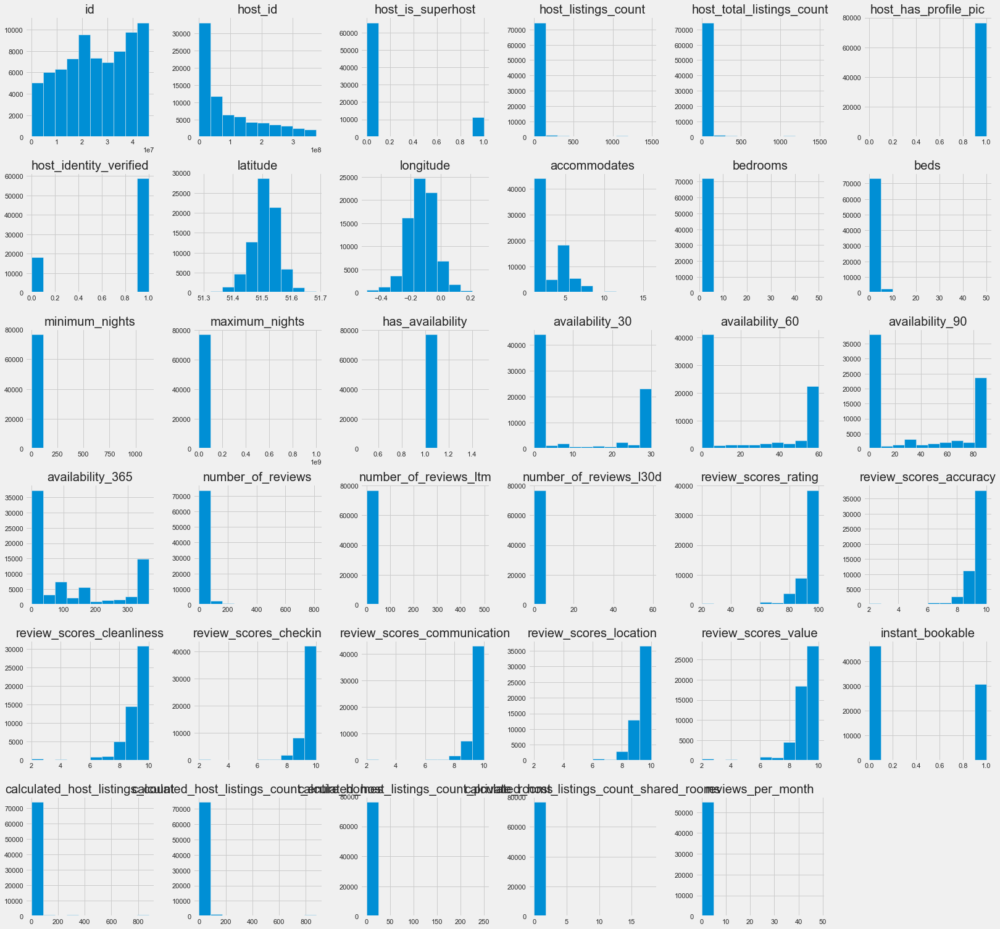

In [141]:
#Check if boolean and numeric columns have enough varibility to make them worth including
#host_is_superhost, host_has_profile_pic, host_identity_verified,has_availability, instant_bookable are boolean values

# Replace columns with categorical values t and f with 1 and 0
listings = listings.replace({'f': 0, 't': 1})

# Plot the histogram of numerical and boolean columns
listings.hist(figsize=(25, 25))

In [142]:
listings['has_availability'].unique() #only 1 value of 't'. no variation. does not tell us much. Can drop

array([1], dtype=int64)

In [143]:
listings['calculated_host_listings_count_shared_rooms'].unique()

array([ 0,  2,  1, 11,  8,  7,  3,  4, 18,  6,  9, 12], dtype=int64)

In [144]:
listings.calculated_host_listings_count_shared_rooms.value_counts() # majority zero. not much variation should drop
# 75913 /76984 = 98.6% of values are zeroes

0     75913
1       709
2        78
4        52
7        44
3        39
11       37
8        27
9        23
6        22
18       22
12       18
Name: calculated_host_listings_count_shared_rooms, dtype: int64

In [145]:
listings.calculated_host_listings_count_private_rooms.value_counts()

0      36385
1      25189
2       6444
3       2742
4       1622
5        891
6        578
9        520
7        378
249      279
13       218
10       195
8        195
22       163
12       161
37       152
11       131
15       116
18        86
14        59
58        58
38        51
21        42
40        42
28        39
35        38
34        35
16        35
27        27
24        26
26        26
23        25
19        19
17        17
Name: calculated_host_listings_count_private_rooms, dtype: int64

In [146]:
listings.number_of_reviews_l30d.value_counts() # # majority zero. not much variation should drop
#72050/76984 = 93.6% are zeroes

0     72050
1      3489
2       885
3       319
4       103
5        51
6        31
7        18
8        11
9         6
12        4
16        3
11        3
10        3
14        1
17        1
18        1
23        1
31        1
38        1
51        1
59        1
Name: number_of_reviews_l30d, dtype: int64

In [147]:
listings.number_of_reviews_ltm.value_counts()

0     47098
1      8514
2      4727
3      3231
4      2332
      ...  
85        1
84        1
74        1
76        1
63        1
Name: number_of_reviews_ltm, Length: 88, dtype: int64

In [148]:
listings.maximum_nights.value_counts().sort_values()

105         1
826         1
132         1
117         1
1044        1
        ...  
90       2396
14       2741
30       4046
365      4149
1125    42864
Name: maximum_nights, Length: 311, dtype: int64

In [149]:
listings.host_has_profile_pic.value_counts() 
# 76666/76984 = 99.6% are ones.

1.0    76666
0.0      307
Name: host_has_profile_pic, dtype: int64

From the above, it can be seen that Column **has_availability** contains only one category - 't'. There is no variation and does not add much to our analysis.

There is very little variability in **calculated_host_listings_count_shared_rooms** columns with 98.6% of values are zeroes.

So we decided to drop these two columns as they are not correlated to price after the analysis.

We are keeping host_has_profile_pic (99.6% are ones) and number_of_reviews_l30d (93.6% are zeroes) for time being. 


In [157]:
listings = listings.drop(['has_availability', 'calculated_host_listings_count_shared_rooms'], axis=1)


We further cleaned the data by removing special characters and converting to float **host_response_rate**, **host_acceptance_rate**, **bathrooms_text** and **price**. We also renamed **bathrooms_text** to **bathrooms**.

In [158]:
# Lambda function to remove special characters and convert to float
strip_and_convert = lambda col: col.str.extract('(\d+)', expand=False).astype(float, errors='ignore')

# strip_and_convert function wil be applied on the below columns
cols_to_numeric = ['host_response_rate', 'host_acceptance_rate', 'bathrooms_text', 'price']
listings[cols_to_numeric] = listings[cols_to_numeric].apply(strip_and_convert)
# Rename bathrooms_text column
listings = listings.rename(columns={'bathrooms_text': 'bathrooms'})
print(listings.shape)
listings.head()

(76984, 46)


,id,last_scraped,host_id,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,host_has_profile_pic,host_identity_verified,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,reviews_per_month
0,11551,07/11/2020,43039,03/10/2009,within an hour,100.0,100.0,0.0,3.0,3.0,1.0,1.0,Lambeth,51.46225,-0.11732,Entire apartment,Entire home/apt,4,1.0,1.0,3.0,"[""Cable TV"", ""Coffee maker"", ""Carbon monoxide ...",97.0,7,190,0,0,4,279,192,7,0,21/03/2010,26/03/2020,91.0,9.0,9.0,10.0,10.0,9.0,9.0,1,2,2,0,1.48
1,13913,07/11/2020,54730,16/11/2009,within a day,83.0,71.0,0.0,3.0,3.0,1.0,1.0,Islington,51.56802,-0.11121,Private room in apartment,Private room,2,1.0,1.0,0.0,"[""Cable TV"", ""Bed linens"", ""Coffee maker"", ""Pa...",40.0,1,29,30,60,90,365,21,2,0,18/08/2010,22/02/2020,97.0,10.0,10.0,10.0,10.0,9.0,9.0,0,2,1,1,0.17
2,15400,07/11/2020,60302,05/12/2009,within a day,100.0,100.0,0.0,1.0,1.0,1.0,1.0,Kensington and Chelsea,51.48796,-0.16898,Entire apartment,Entire home/apt,2,1.0,1.0,1.0,"[""Cable TV"", ""Coffee maker"", ""Dryer"", ""Dishes ...",75.0,10,50,0,20,50,150,89,1,0,21/12/2009,16/03/2020,96.0,10.0,10.0,10.0,10.0,10.0,9.0,1,1,1,0,0.67
3,17402,06/11/2020,67564,04/01/2010,within an hour,67.0,100.0,1.0,18.0,18.0,1.0,1.0,Westminster,51.52195,-0.14094,Entire apartment,Entire home/apt,6,2.0,3.0,3.0,"[""Bed linens"", ""Coffee maker"", ""Dryer"", ""Paid ...",307.0,4,365,25,55,85,330,42,0,0,21/03/2011,02/11/2019,94.0,10.0,9.0,9.0,9.0,10.0,9.0,0,15,15,0,0.36
4,17506,07/11/2020,67915,05/01/2010,NaN,NaN,NaN,0.0,3.0,3.0,1.0,1.0,Hammersmith and Fulham,51.47935,-0.19743,Private room in bed and breakfast,Private room,2,1.0,1.0,1.0,"[""TV"", ""Heating"", ""Shower gel"", ""Wifi"", ""Smoke...",150.0,3,21,29,59,89,364,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,2,0,2,NaN


# Host related columns <a class="anchor" id="host-related-columns"></a>
As seen from the output below, there are 11 rows with missing values in some host related columns.

In [159]:
listings[['host_since', 'host_is_superhost', 'host_listings_count', 'host_has_profile_pic', 'host_identity_verified']].isnull().sum()

host_since                11
host_is_superhost         11
host_listings_count       11
host_has_profile_pic      11
host_identity_verified    11
dtype: int64

In [160]:
#Since it's a small number, we will drop these rows.
listings = listings.dropna(subset=['host_since', 'host_is_superhost', 'host_listings_count', 'host_has_profile_pic', 'host_identity_verified'], axis=0)

listings[['host_since', 'host_is_superhost', 'host_listings_count', 'host_has_profile_pic', 'host_identity_verified']].isnull().sum()

print(listings.shape)

(76973, 46)


In addition, the **host_since** column contains dates in the format **YYYY-MM-DD**.

**Feature engineering**
To be able to use the column in our model, we will transform the **host_since** column to numerical: the new column will be the difference (in days) between the date the dataset was scraped and host_since column.

In [161]:
# Convert to datetime object
listings['last_scraped'] = pd.to_datetime(listings['last_scraped'])
listings['host_since'] = pd.to_datetime(listings['host_since'])

#Created a new feature to calculate the difference in days:
listings['days_host_since'] = (listings['last_scraped'] - listings['host_since']).dt.days

# Remove host_since and other unnecessary columns
#listings = listings.drop(['host_since', 'id', 'host_id'], axis=1)

#listings['days_host_since'].describe()
listings.head()

,id,last_scraped,host_id,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,host_has_profile_pic,host_identity_verified,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,reviews_per_month,days_host_since
0,11551,2020-07-11,43039,2009-03-10,within an hour,100.0,100.0,0.0,3.0,3.0,1.0,1.0,Lambeth,51.46225,-0.11732,Entire apartment,Entire home/apt,4,1.0,1.0,3.0,"[""Cable TV"", ""Coffee maker"", ""Carbon monoxide ...",97.0,7,190,0,0,4,279,192,7,0,21/03/2010,26/03/2020,91.0,9.0,9.0,10.0,10.0,9.0,9.0,1,2,2,0,1.48,4141
1,13913,2020-07-11,54730,2009-11-16,within a day,83.0,71.0,0.0,3.0,3.0,1.0,1.0,Islington,51.56802,-0.11121,Private room in apartment,Private room,2,1.0,1.0,0.0,"[""Cable TV"", ""Bed linens"", ""Coffee maker"", ""Pa...",40.0,1,29,30,60,90,365,21,2,0,18/08/2010,22/02/2020,97.0,10.0,10.0,10.0,10.0,9.0,9.0,0,2,1,1,0.17,3890
2,15400,2020-07-11,60302,2009-05-12,within a day,100.0,100.0,0.0,1.0,1.0,1.0,1.0,Kensington and Chelsea,51.48796,-0.16898,Entire apartment,Entire home/apt,2,1.0,1.0,1.0,"[""Cable TV"", ""Coffee maker"", ""Dryer"", ""Dishes ...",75.0,10,50,0,20,50,150,89,1,0,21/12/2009,16/03/2020,96.0,10.0,10.0,10.0,10.0,10.0,9.0,1,1,1,0,0.67,4078
3,17402,2020-06-11,67564,2010-04-01,within an hour,67.0,100.0,1.0,18.0,18.0,1.0,1.0,Westminster,51.52195,-0.14094,Entire apartment,Entire home/apt,6,2.0,3.0,3.0,"[""Bed linens"", ""Coffee maker"", ""Dryer"", ""Paid ...",307.0,4,365,25,55,85,330,42,0,0,21/03/2011,02/11/2019,94.0,10.0,9.0,9.0,9.0,10.0,9.0,0,15,15,0,0.36,3724
4,17506,2020-07-11,67915,2010-05-01,NaN,NaN,NaN,0.0,3.0,3.0,1.0,1.0,Hammersmith and Fulham,51.47935,-0.19743,Private room in bed and breakfast,Private room,2,1.0,1.0,1.0,"[""TV"", ""Heating"", ""Shower gel"", ""Wifi"", ""Smoke...",150.0,3,21,29,59,89,364,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,2,0,2,NaN,3724


# Property Type <a class="anchor" id="property_type"></a>
We also need to perform some cleaning in property_type columns as there are too many categories whilst the majority of property types (~80%) belong to 3 categories only, i.e. Entire apartment, Private room in apartment and Private room in house.

In [240]:
prob = listings['property_type'].value_counts(normalize=True)
len(prob)

92

Entire apartment                  0.419669
Private room in apartment         0.233242
Private room in house             0.144693
Entire house                      0.073217
Private room in townhouse         0.020166
                                    ...   
Private room in tent              0.000013
Dome house                        0.000013
Private room in shepherd's hut    0.000013
Shared room in earth house        0.000013
Private room in bus               0.000013
Name: property_type, Length: 92, dtype: float64

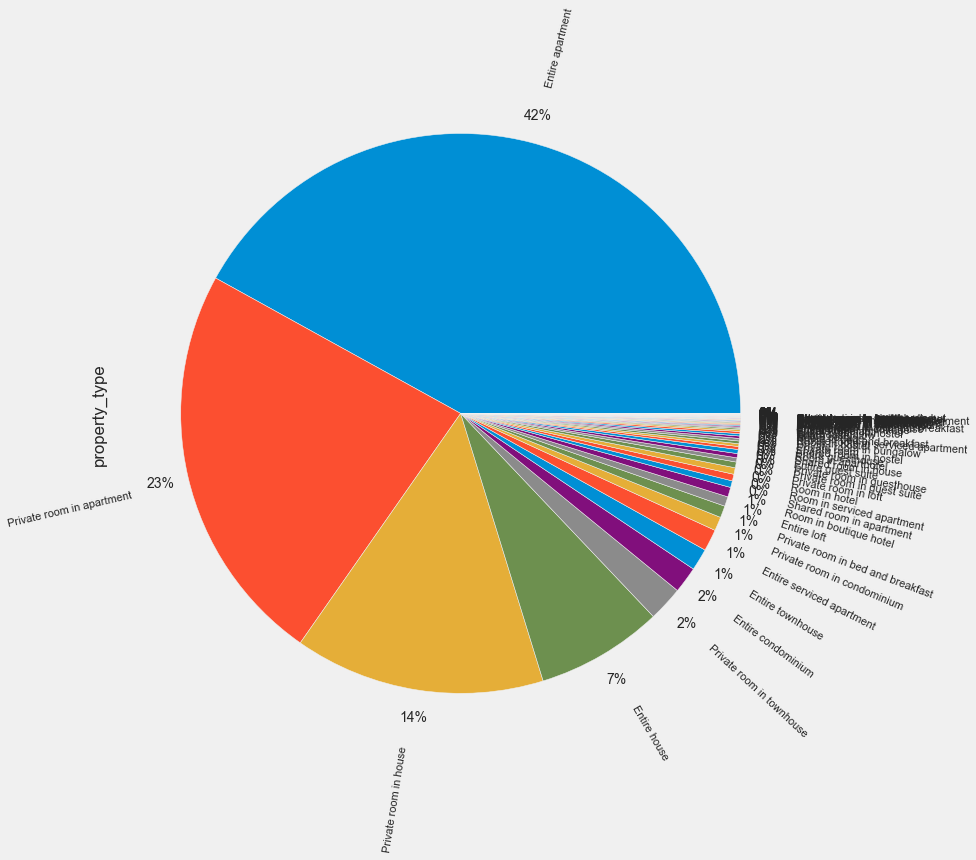

In [102]:
# calculate the percentage of each property type.
display(listings['property_type'].value_counts(normalize=True))

# plot the pie chart of property categories
plt.figure(figsize = (20, 12))
listings['property_type'].value_counts(normalize=True).plot.pie(autopct='%1.0f%%', pctdistance=1.1, labeldistance=1.2, rotatelabels=True)
plt.show()

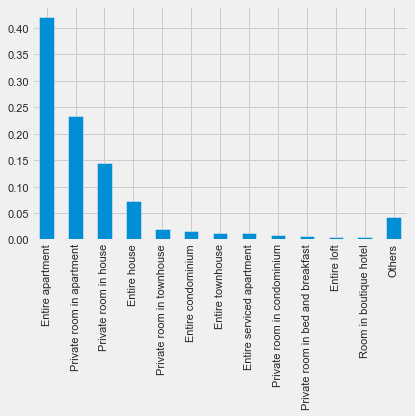

Property types: ['Entire apartment', 'Private room in apartment', 'Private room in house'] make up 79.75 % of the total property types


In [162]:

prob = listings['property_type'].value_counts(normalize=True)
# Setting a threshold. This threshold means that if the frequency of the property types that is less than this value, they will be categorised as 'Others'
threshold = 0.005
mask = prob > threshold
tail_prob = prob.loc[~mask].sum()
prob = prob.loc[mask]
prob['Others'] = tail_prob
prob.plot(kind='bar')
plt.xticks(rotation=90)
plt.show()

print("Property types: {} make up {} % of the total property types".format(
    list(prob[:3].index), 
    round(prob[:3].sum(), 4) * 100
))

In [163]:
# Replace with Other if the frequency of the category is below set threshold (we set it at 0.005, refer to above) 
listings.loc[~listings['property_type'].isin(prob.index.drop('Others')), 'property_type'] = 'Others'
listings['property_type'].value_counts()

Entire apartment                     32299
Private room in apartment            17952
Private room in house                11136
Entire house                          5635
Others                                3283
Private room in townhouse             1552
Entire condominium                    1171
Entire townhouse                       976
Entire serviced apartment              966
Private room in condominium            622
Private room in bed and breakfast      524
Entire loft                            429
Room in boutique hotel                 428
Name: property_type, dtype: int64

# Bathrooms, bedrooms and beds <a class="anchor" id="bathrooms-bedrooms-beds"></a>
Since these are integer values, the missing values will be replaced with median as we want whole number without decimals. Median is the middlemost numerical in a sorted list of those numerical.

In [164]:
fill_median = lambda col: col.fillna(col.median())
listings[['bathrooms', 'bedrooms', 'beds']] = listings[['bathrooms', 'bedrooms', 'beds']].apply(fill_median)

listings[['bathrooms', 'bedrooms', 'beds']].isnull().sum()


bathrooms    0
bedrooms     0
beds         0
dtype: int64

# First_review and last_review <a class="anchor" id="first-last-review"></a>
More than 28% of the listings do not have any reviews. This is too many rows to drop. Furthermore, inputing the missing values is also not the best idea since this may skew the distribution significantly. However, the fact that there are missing values may give us meaningful information. This explains that listings with missing values are new bookings that have not yet have reviews. Hence, these values will be kept and will be categorised as 'No reviews'. These columns will be transformed to categorical


This is also too large a proportion of the dataset to simply replace with median/mean values, as this would skew the distribution substantially. Also, the missing values here are not really missing values, as the fact that they are NaNs is meaningful - it tells us that these are new or previously unbooked listings that have not had reviews yet. In order to make the resulting model work able to predict prices for any Airbnb listing, including brand new listings, is is actually beneficial to keep them in. Therefore, these will be kept as an unknown category, and the feature will have to be treated as categorical (and therefore one-hot encoded) rather than numerical.

In [341]:
100 * listings[['first_review', 'last_review']].isnull().sum() / len(listings)

first_review    28.225482
last_review     28.225482
dtype: float64

In [165]:
listings[['first_review','last_review']].isnull().sum()

first_review    21726
last_review     21726
dtype: int64

In [343]:
print(f"Null values in 'first_review': {round(100*listings.first_review.isna().sum()/len(listings),1)}%")
print(f"Null values in 'review_scores_rating': {round(100*listings.review_scores_rating .isna().sum()/len(listings),1)}%")

Null values in 'first_review': 28.2%
Null values in 'review_scores_rating': 30.5%


In [166]:
# Convert to datetime object
listings['first_review'] = pd.to_datetime(listings['first_review'])
listings['last_review'] = pd.to_datetime(listings['last_review'])

# New feature to calculate number of days between review date and the date the dataset was scrapped
listings['days_since_first_review'] = (listings['last_scraped'] - listings['first_review'])
listings['days_since_last_review'] = (listings['last_scraped'] - listings['last_review'])

In [167]:
def bin_column(col, bins, labels, nan_label='unknown'):
    """
    Takes in a column name, bin cut points and labels, replaces the original column with a
    binned version, and replaces nulls (with 'unknown' if unspecified).
    """
    listings[col] = pd.cut(listings[col], bins=bins, labels=labels, include_lowest=True)
    listings[col] = listings[col].astype('str')
    listings[col].fillna(nan_label, inplace=True)

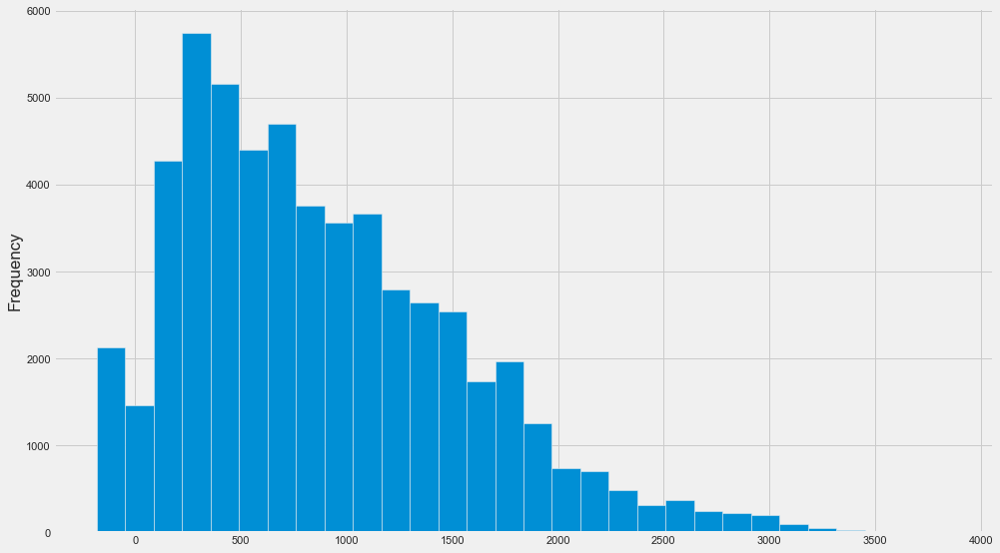

In [168]:
# Distribution of the number of days since first review
listings['days_since_first_review'].dt.days.plot(kind='hist', bins=30, figsize=(15,9));

In [169]:
# Binning time since first review
bin_column('days_since_first_review',
           bins=pd.to_timedelta([0, 182, 365, 730, 1460, max(listings['days_since_first_review'])], unit='days'),
           labels=['0-6 months',
                   '6-12 months',
                   '1-2 years',
                   '2-3 years',
                   '4+ years'],
           nan_label='no reviews')



0

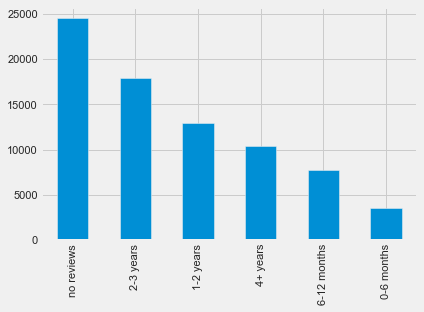

In [170]:
plt.style.use('fivethirtyeight')

listings['days_since_first_review'].value_counts().plot(kind='bar')
listings['days_since_first_review'].isnull().sum()

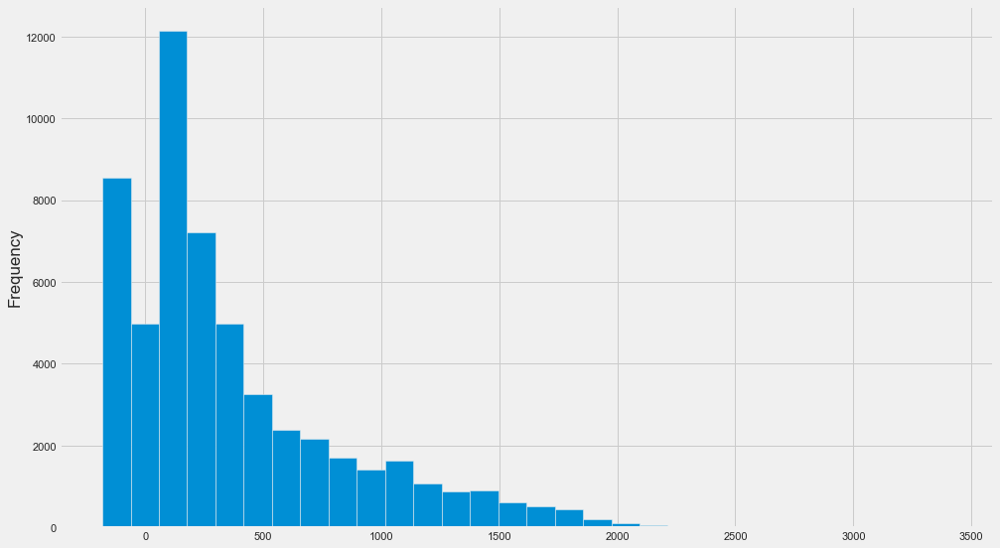

In [171]:
# Distribution of the number of days since last review
listings['days_since_last_review'].dt.days.plot(kind='hist', bins=30, figsize=(15,9));

In [172]:
# Binning time since last review
bin_column('days_since_last_review',
           bins=pd.to_timedelta([0, 14, 60, 182, 365, max(listings['days_since_last_review'])], unit='days'),
           labels=['0-2 weeks',
                   '2-8 weeks',
                   '2-6 months',
                   '6-12 months',
                   '1+ year'],
           nan_label='no reviews')

0

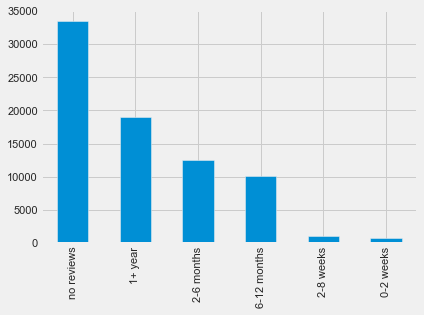

In [173]:
listings['days_since_last_review'].value_counts().plot(kind='bar')
listings['days_since_last_review'].isnull().sum()

In [174]:
listings[['days_since_first_review','days_since_last_review']].isnull().sum()

days_since_first_review    0
days_since_last_review     0
dtype: int64

In [ ]:
## Dropping last_review - first_review will be kept for EDA and dropped later
#listings.drop('last_review', axis=1, inplace=True)

In [175]:
listings[['days_since_first_review','days_since_last_review']]

,days_since_first_review,days_since_last_review
0,4+ years,2-6 months
1,4+ years,2-6 months
2,4+ years,2-6 months
3,4+ years,1+ year
4,no reviews,no reviews
...,...,...
76979,no reviews,no reviews
76980,no reviews,no reviews
76981,no reviews,no reviews
76982,no reviews,no reviews


# Review scores columns <a class="anchor" id="review_scores"></a>
Like above, ratings without reviews will be replaced by No reviews value, and we will also categorise these columns. The histrograms below will be a useful reference for us to decide on bins. Most of the ratings are above 9 points out of 10. reviews_scores_rating is a mean of other columns multiplied by 100 to represent the ratings in percentage.

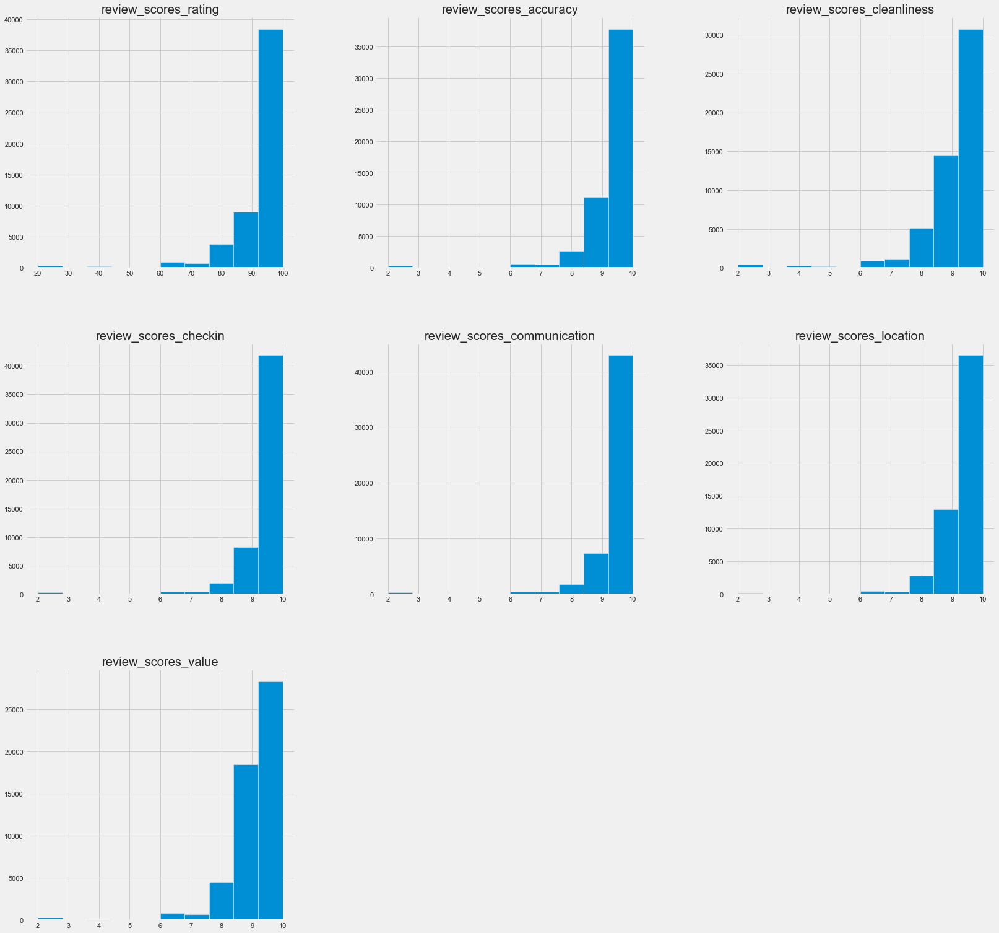

In [176]:
listings.isnull().sum().sort_values(ascending=False)
review_cols = listings.columns[listings.columns.str.startswith("review_scores")]
listings[review_cols].hist(figsize=(25, 25));

In [31]:
# Categorising columns out of 10
review_cols_10 = ['review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'review_scores_value']

for col in review_cols_10:
    bin_column(col,
               bins=[0, 8, 9, 10],
               labels=['0-8/10', '9/10', '10/10'],
               nan_label='no reviews')



<AxesSubplot:>

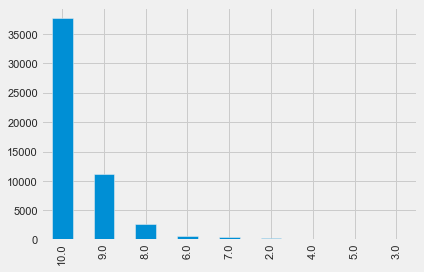

In [177]:
listings['review_scores_accuracy'].value_counts().plot(kind='bar')


In [178]:
# Binning column scored out of 100
bin_column('review_scores_rating',
           bins=[0, 80, 95, 100],
           labels=['0-79/100', '80-94/100', '95-100/100'],
           nan_label='no reviews')

<AxesSubplot:>

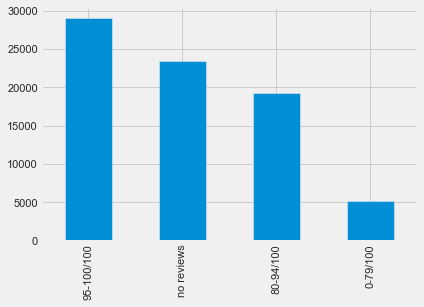

In [179]:
listings['review_scores_rating'].value_counts().plot(kind='bar')

In [35]:
listings[review_cols]

,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
0,80-94/100,9/10,9/10,10/10,10/10,9/10,9/10
1,95-100/100,10/10,10/10,10/10,10/10,9/10,9/10
2,95-100/100,10/10,10/10,10/10,10/10,10/10,9/10
3,80-94/100,10/10,9/10,9/10,9/10,10/10,9/10
4,no reviews,no reviews,no reviews,no reviews,no reviews,no reviews,no reviews
...,...,...,...,...,...,...,...
76979,no reviews,no reviews,no reviews,no reviews,no reviews,no reviews,no reviews
76980,no reviews,no reviews,no reviews,no reviews,no reviews,no reviews,no reviews
76981,no reviews,no reviews,no reviews,no reviews,no reviews,no reviews,no reviews
76982,no reviews,no reviews,no reviews,no reviews,no reviews,no reviews,no reviews


In [36]:
listings.shape

(76973, 49)

# Host_response_rate, host_acceptance_rate, reviews_per_month <a class="anchor" id="host-response"></a>
Empty host_response_rate, host_acceptance_rate, reviews_per_month will be filled by mean values

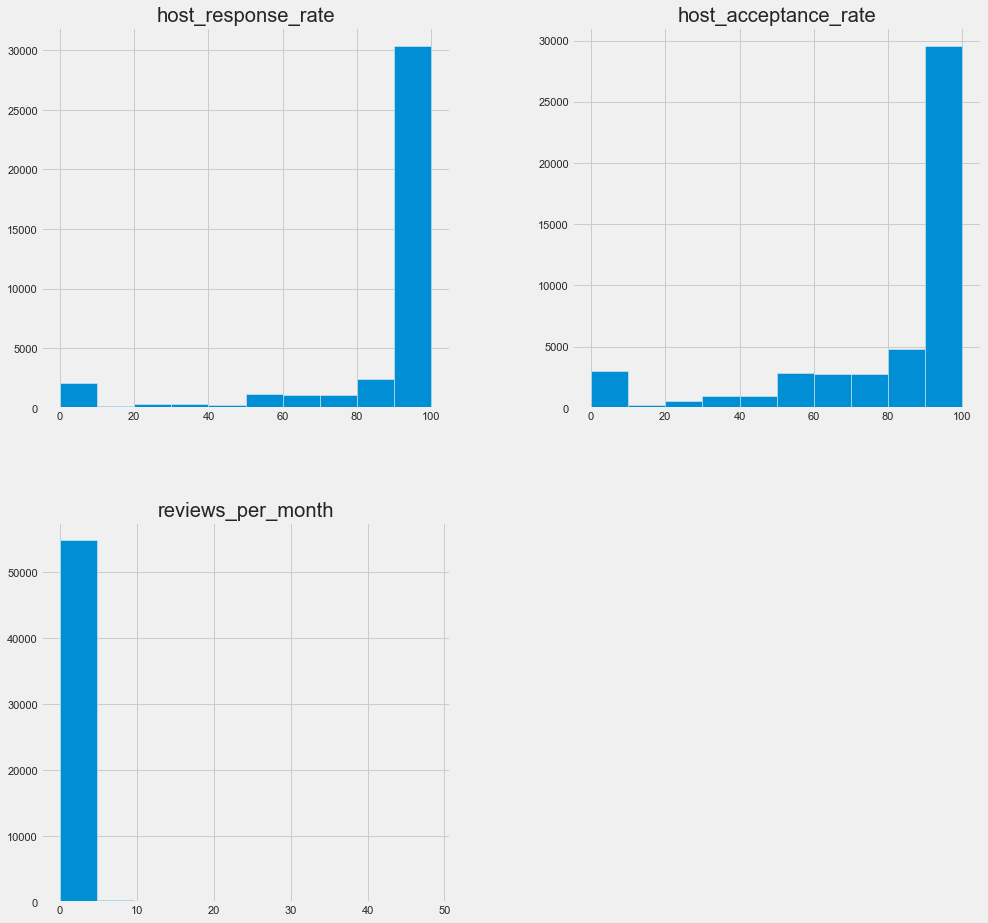

In [180]:
fill_mean = lambda col: col.fillna(col.mean())
listings[['host_response_rate', 'host_acceptance_rate', 'reviews_per_month']].hist(figsize=(15, 15));
listings[['host_response_rate', 'host_acceptance_rate', 'reviews_per_month']] = listings[['host_response_rate', 'host_acceptance_rate', 'reviews_per_month']].apply(fill_mean)

In [181]:
listings[['host_response_rate', 'host_acceptance_rate', 'reviews_per_month']].isnull().sum()


host_response_rate      0
host_acceptance_rate    0
reviews_per_month       0
dtype: int64

array([[<AxesSubplot:title={'center':'host_response_rate'}>,
        <AxesSubplot:title={'center':'host_acceptance_rate'}>],
       [<AxesSubplot:title={'center':'reviews_per_month'}>,
        <AxesSubplot:>]], dtype=object)

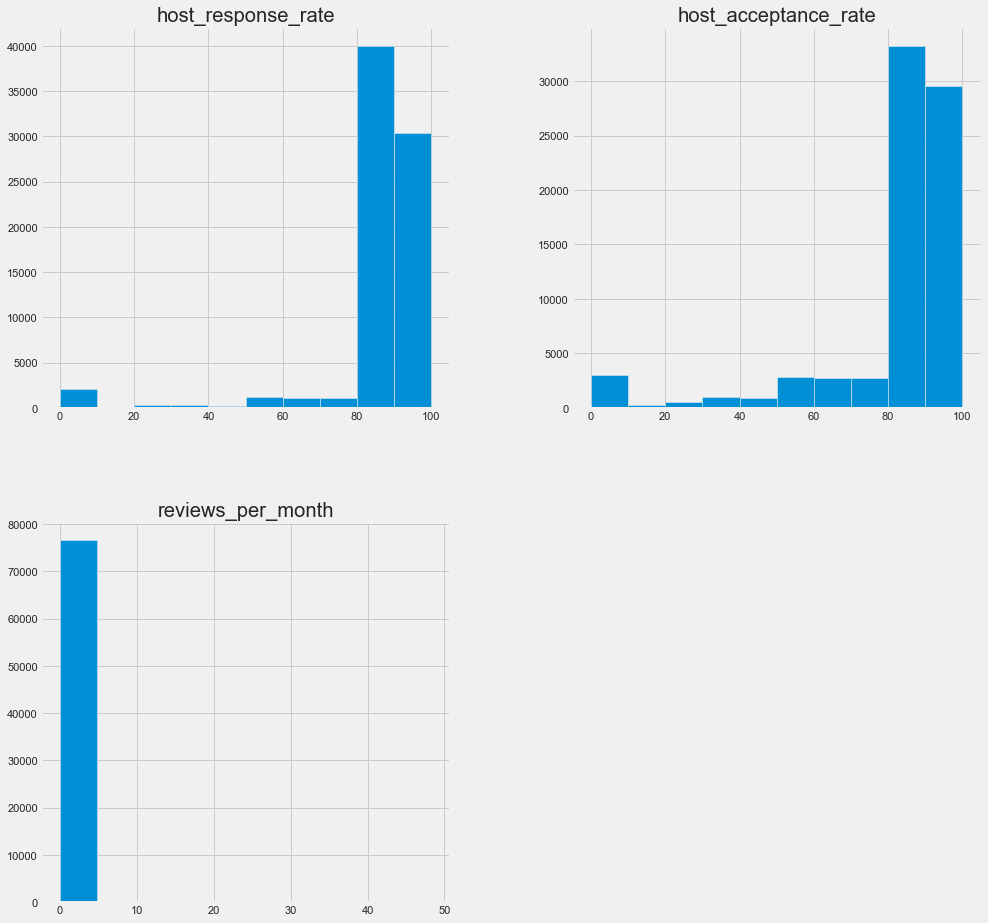

In [182]:
listings[['host_response_rate', 'host_acceptance_rate', 'reviews_per_month']].hist(figsize=(15, 15))

In [183]:
#fill missing values on host_response_time with not provided
listings.host_response_time.isnull().sum()

listings['host_response_time'] = listings['host_response_time'].fillna('not provided')

In [184]:
#Overview of non numerical features

df_not_num = listings.select_dtypes(include = ['O'])
print('There are {} non numerical features including:\n{}'.format(len(df_not_num.columns), df_not_num.columns.tolist()))
df_not_num.head(4)

There are 8 non numerical features including:
['host_response_time', 'neighbourhood_cleansed', 'property_type', 'room_type', 'amenities', 'review_scores_rating', 'days_since_first_review', 'days_since_last_review']


,host_response_time,neighbourhood_cleansed,property_type,room_type,amenities,review_scores_rating,days_since_first_review,days_since_last_review
0,within an hour,Lambeth,Entire apartment,Entire home/apt,"[""Cable TV"", ""Coffee maker"", ""Carbon monoxide ...",80-94/100,4+ years,2-6 months
1,within a day,Islington,Private room in apartment,Private room,"[""Cable TV"", ""Bed linens"", ""Coffee maker"", ""Pa...",95-100/100,4+ years,2-6 months
2,within a day,Kensington and Chelsea,Entire apartment,Entire home/apt,"[""Cable TV"", ""Coffee maker"", ""Dryer"", ""Dishes ...",95-100/100,4+ years,2-6 months
3,within an hour,Westminster,Entire apartment,Entire home/apt,"[""Bed linens"", ""Coffee maker"", ""Dryer"", ""Paid ...",80-94/100,4+ years,1+ year


<ipython-input-98-d4c229e8ad55>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.xaxis.get_majorticklabels(), rotation=45)
<ipython-input-98-d4c229e8ad55>:15: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, ha="right")
<ipython-input-98-d4c229e8ad55>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.xaxis.get_majorticklabels(), rotation=45)
<ipython-input-98-d4c229e8ad55>:15: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, ha="right")
<ipython-input-98-d4c229e8ad55>:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.xaxis.get_majorticklabels(), rotation=45)
<ipython-input-98-d4c229e8ad55>:15: UserWarning: FixedFormatter should only be used together with FixedLoca

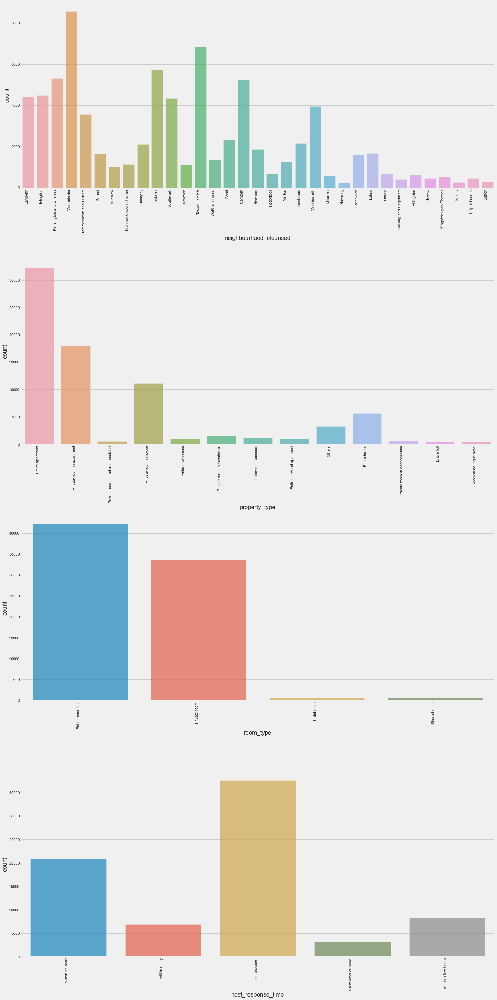

In [98]:
#We are excluding 'amentities' as it is a multi-value feature.

df_not_num = df_not_num[['neighbourhood_cleansed', 'property_type', 'room_type', 'host_response_time']]

#Let's see their distribution

ncols = 1

fig, axes = plt.subplots(round(len(df_not_num.columns) / ncols), ncols, figsize=(20, 40))
#plt.xticks(rotation=90)

for i, ax in enumerate(fig.axes):
    if i < len(df_not_num.columns):
        ax.set_xticklabels(ax.xaxis.get_majorticklabels(), rotation=45)
        ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, ha="right")
        sns.countplot(x=df_not_num.columns[i], alpha=0.7, data=df_not_num, ax=ax)

fig.tight_layout()

# Amenities <a class="anchor" id="amenities"></a>
Given that amenities are stored in a list, we will split the amenities and one-hot encoding them

In [185]:
#This code was taken from https://github.com/es-g/airbnb_london/blob/master/Data_cleaning.py
def one_hot_encode_amenities(df):
    '''
    INPUT: 
    df - Original dataframe
    OUTPUT: 
    df_amenities - One-hot encoded dataframe of amenities
        
    Create dummies from list of amenities
    
    '''
    def clean_amenities(row):
        '''
        Remove special characters and split the strings
        '''
        row = re.sub('[^A-Za-z,]+', '_', row).split(",")
        return row
        
    df['amenities'] = df['amenities'].apply(clean_amenities)
    
    # Create columns from list of amenities
    df_amenities = df.amenities.str.join('|').str.get_dummies().add_prefix('amenity')
        
    # Include only those amenities that are found in >5% of the listings
    df_amenities = df_amenities[df_amenities.columns[df_amenities.sum() > 0.05 * len(df_amenities)]]
        
    return df_amenities

In [186]:
amenities_df = one_hot_encode_amenities(listings)

In [187]:
listings.shape

(76973, 49)

In [188]:
# Remove amenities column
listings = listings.drop(['amenities'], axis=1)

#Concatenate dataframes
listings = pd.concat([listings, amenities_df], axis=1)
print(listings.shape)
listings.head()

(76973, 95)


,id,last_scraped,host_id,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,host_has_profile_pic,host_identity_verified,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bedrooms,beds,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,...,amenity_Dryer_,amenity_Elevator_,amenity_Essentials_,amenity_Extra_pillows_and_blankets_,amenity_Fire_extinguisher_,amenity_First_aid_kit_,amenity_Free_parking_on_premises_,amenity_Free_street_parking_,amenity_Garden_or_backyard_,amenity_Hair_dryer_,amenity_Hangers_,amenity_Heating_,amenity_Host_greets_you_,amenity_Hot_water_,amenity_Indoor_fireplace_,amenity_Iron_,amenity_Kitchen_,amenity_Laptop_friendly_workspace_,amenity_Lock_on_bedroom_door_,amenity_Lockbox_,amenity_Long_term_stays_allowed_,amenity_Luggage_dropoff_allowed_,amenity_Microwave_,amenity_Oven_,amenity_Paid_parking_off_premises_,amenity_Patio_or_balcony_,amenity_Private_entrance_,amenity_Private_living_room_,amenity_Refrigerator_,amenity_Shampoo_,amenity_Shower_gel_,amenity_Single_level_home_,amenity_Smoke_alarm_,amenity_Stove_,amenity_TV_,amenity_Washer_,amenity_Wifi_
0,11551,2020-07-11,43039,2009-03-10,within an hour,100.000000,100.000000,0.0,3.0,3.0,1.0,1.0,Lambeth,51.46225,-0.11732,Entire apartment,Entire home/apt,4,1.0,1.0,3.0,97.0,7,190,0,0,4,279,192,7,0,2010-03-21,2020-03-26,80-94/100,9.0,9.0,10.0,...,0,0,1,0,1,0,0,0,0,1,1,1,0,1,0,1,1,1,0,1,1,0,1,1,1,0,0,0,1,0,0,0,1,1,1,1,1
1,13913,2020-07-11,54730,2009-11-16,within a day,83.000000,71.000000,0.0,3.0,3.0,1.0,1.0,Islington,51.56802,-0.11121,Private room in apartment,Private room,2,1.0,1.0,0.0,40.0,1,29,30,60,90,365,21,2,0,2010-08-18,2020-02-22,95-100/100,10.0,10.0,10.0,...,1,0,1,1,1,0,0,1,0,1,1,1,1,1,0,1,1,1,1,0,1,1,0,1,1,1,0,0,1,1,0,0,1,1,1,1,1
2,15400,2020-07-11,60302,2009-05-12,within a day,100.000000,100.000000,0.0,1.0,1.0,1.0,1.0,Kensington and Chelsea,51.48796,-0.16898,Entire apartment,Entire home/apt,2,1.0,1.0,1.0,75.0,10,50,0,20,50,150,89,1,0,2009-12-21,2020-03-16,95-100/100,10.0,10.0,10.0,...,1,0,1,0,1,0,0,0,0,1,1,1,0,1,0,1,1,1,0,0,1,1,1,0,0,0,0,0,1,1,0,0,1,0,1,1,1
3,17402,2020-06-11,67564,2010-04-01,within an hour,67.000000,100.000000,1.0,18.0,18.0,1.0,1.0,Westminster,51.52195,-0.14094,Entire apartment,Entire home/apt,6,2.0,3.0,3.0,307.0,4,365,25,55,85,330,42,0,0,2011-03-21,2019-02-11,80-94/100,10.0,9.0,9.0,...,1,1,1,0,0,0,0,0,0,1,1,1,0,1,0,1,1,1,0,1,1,0,1,1,1,0,0,0,1,1,0,0,1,1,1,1,1
4,17506,2020-07-11,67915,2010-05-01,not provided,87.645506,81.269505,0.0,3.0,3.0,1.0,1.0,Hammersmith and Fulham,51.47935,-0.19743,Private room in bed and breakfast,Private room,2,1.0,1.0,1.0,150.0,3,21,29,59,89,364,0,0,0,NaT,NaT,no reviews,NaN,NaN,NaN,...,0,0,1,0,0,0,0,0,0,1,1,1,0,1,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,1,0,1


# Dealing with outliers in prices <a class="anchor" id="price-outliers"></a>
Around 2.1% of listings' prices are greater than 4 times the standard deviation of price. So we will remove the rows with values greater than that.

In [43]:
print("Number of 0 (Zero) Price:")
print(len(listings[listings["price"]==0]))

Number of 0 (Zero) Price:
10


In [44]:
data = listings[(listings["price"]==0)]
data.T

,67251,68394,68514,...,75001,75132,76416
id,42065766,42535216,42583348,...,45589684,45646362,46060845
last_scraped,2020-06-11 00:00:00,2020-07-11 00:00:00,2020-07-11 00:00:00,...,2020-07-11 00:00:00,2020-06-11 00:00:00,2020-07-11 00:00:00
host_id,315016947,316083765,316779511,...,3010498,3010498,3010498
host_since,2019-06-12 00:00:00,2019-10-12 00:00:00,2019-12-12 00:00:00,...,2012-07-21 00:00:00,2012-07-21 00:00:00,2012-07-21 00:00:00
host_response_time,not provided,within an hour,within an hour,...,within a few hours,within a few hours,within a few hours
...,...,...,...,...,...,...,...
amenity_Smoke_alarm_,1,1,1,...,1,1,1
amenity_Stove_,0,0,0,...,1,1,1
amenity_TV_,1,0,0,...,0,0,0
amenity_Washer_,0,0,0,...,1,1,1


In [189]:
#Drop listings with price = 0 
listings = listings[(listings["price"]>0)]
len(listings)

76963

Mean price: £ 100.06614866884087
Median price: £ 74.0
Standard Deviation of Price: £ 94.79698965496547
Four times Standard Deviation: £ 379.1879586198619
Number of outliers:  922
Percentage greater than 4X standard deviation:  2.1789691150293


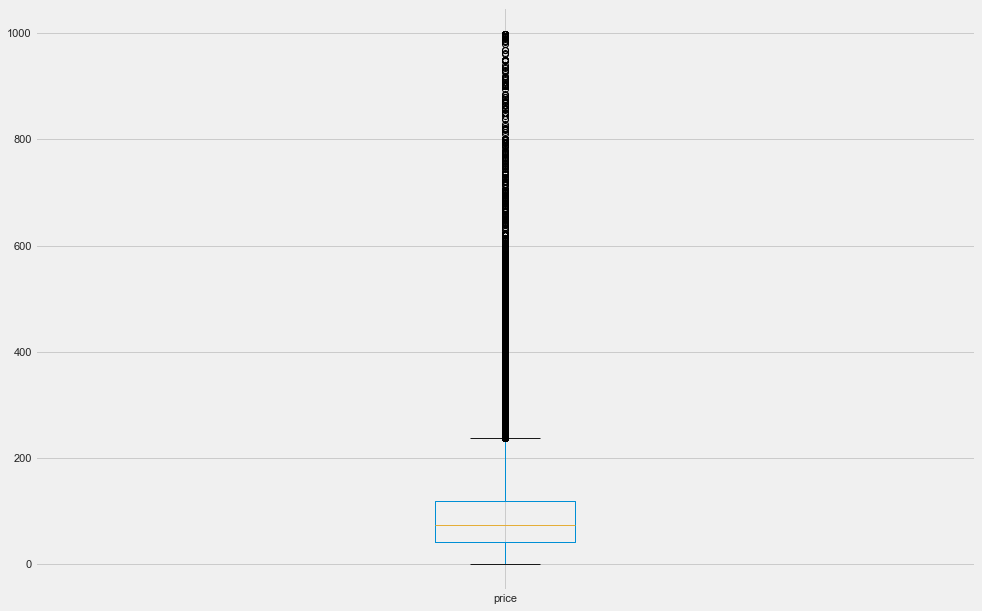

In [190]:
listings['price'].plot(kind='box', figsize=(15, 10));

meanPrice = listings['price'].mean()
medianPrice = listings['price'].median()
stdDevPrice = listings['price'].std()
print('Mean price: £', meanPrice)
print('Median price: £', medianPrice)
print('Standard Deviation of Price: £', stdDevPrice)
print('Four times Standard Deviation: £', 4 *stdDevPrice)

outliers = abs(listings['price'] - meanPrice) >= 4 * stdDevPrice

print('Number of outliers: ', outliers.sum())

#6 *std = 568.7611414677139 plus mean = 668 ==> there's 306 above this price
#5 *std = 473.9676178897616 plus mean = 573 ==> there's 477 above this price
#4 *std = 379.17409431180926 plus mean = 479 ==> there's 922 above this price
#3.5 *std = 284.3805707338569 plus mean = 384 ==> there's 1641 above this price
print('Percentage greater than 4X standard deviation: ', 100 * (len(listings[listings['price'] >4 *stdDevPrice]) / len(listings)))

listings = listings[listings['price'] < 4 *stdDevPrice]

In [105]:
listings.shape

(75286, 96)

# Colinearity in Features containing listings_count<a class="anchor" id="listings_count"></a>

We can see that host_total_listings_count and host_listings_count is 100% identical. So we can drop **host_listings_count**. We will leave the other features for further analysis.

In [48]:
print(100 * sum(listings.host_total_listings_count == listings.host_listings_count) / len(listings)) 
print(100 * sum(listings.calculated_host_listings_count == listings.host_listings_count) / len(listings))
print(100 * sum(listings.calculated_host_listings_count_entire_homes == listings.host_listings_count) / len(listings))
print(100 * sum(listings.calculated_host_listings_count_private_rooms == listings.host_listings_count) / len(listings))

print(100 * sum(listings.calculated_host_listings_count_entire_homes == listings.calculated_host_listings_count) / len(listings))
print(100 * sum(listings.calculated_host_listings_count_private_rooms == listings.calculated_host_listings_count) / len(listings))
print(100 * sum(listings.calculated_host_listings_count_shared_rooms == listings.calculated_host_listings_count) / len(listings))


100.0
62.31008287292818
32.98581597960051
33.17573310667233
45.237462813429666
37.06040161495962
0.4581916702082448


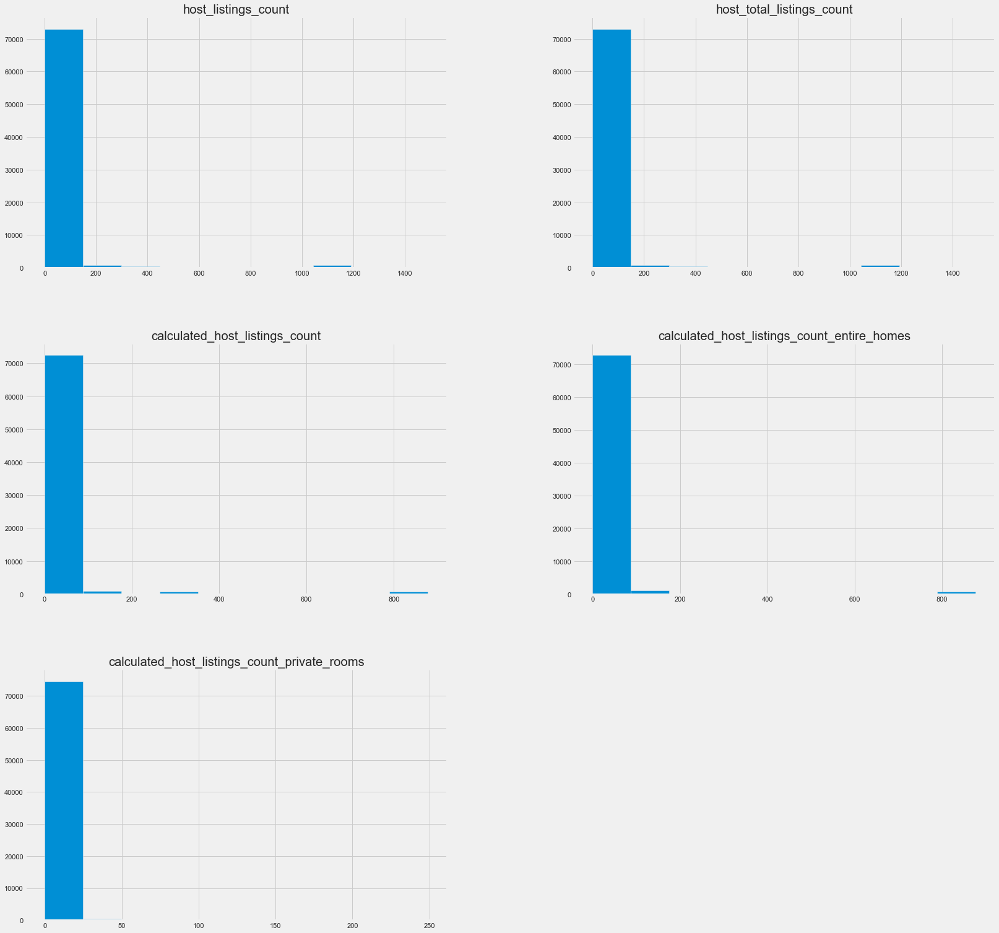

In [191]:
listing_count_cols = listings.columns[listings.columns.str.contains("listings_count")]
listing_count_cols
listings[listing_count_cols].hist(figsize=(25, 25));

In [192]:
print(listings.shape)
listings = listings.drop(columns=['host_listings_count'])
listings.shape

(75286, 95)


(75286, 94)

# Exploratory Data Analysis <a class="anchor" id="eda"></a>

# 1. Price exploration<a class="anchor" id="q1"></a>



In [150]:
#We also want to look at the full picture of price by using the orginal dataset without removal of outliers
df_1 = raw_listings[['id','property_type', 'price', 'neighbourhood_cleansed', 'room_type', 'accommodates', 'bedrooms', 'beds', 'last_review', 'first_review']].copy()
df_1[['price']] = df_1[['price']].apply(strip_and_convert)
df_1

,id,property_type,price,neighbourhood_cleansed,room_type,accommodates,bedrooms,beds,last_review,first_review
0,11551,Entire apartment,97.0,Lambeth,Entire home/apt,4,1.0,3.0,26/03/2020,21/03/2010
1,13913,Private room in apartment,40.0,Islington,Private room,2,1.0,0.0,22/02/2020,18/08/2010
2,15400,Entire apartment,75.0,Kensington and Chelsea,Entire home/apt,2,1.0,1.0,16/03/2020,21/12/2009
3,17402,Entire apartment,307.0,Westminster,Entire home/apt,6,3.0,3.0,02/11/2019,21/03/2011
4,17506,Private room in bed and breakfast,150.0,Hammersmith and Fulham,Private room,2,1.0,1.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
76979,46259322,Entire apartment,90.0,Westminster,Entire home/apt,2,1.0,1.0,NaN,NaN
76980,46259459,Private room in apartment,87.0,Westminster,Private room,2,1.0,2.0,NaN,NaN
76981,46259503,Private room in house,26.0,Redbridge,Private room,2,1.0,1.0,NaN,NaN
76982,46259530,Private room in apartment,59.0,Hammersmith and Fulham,Private room,2,1.0,NaN,NaN,NaN


In [151]:
#w/o removing outliers
print("Average Price for All London:")
print(round(df_1.price.mean(),2))

Average Price for All London:
100.05


In [193]:
#after removing outliers
print("Average Price for All London:")
print(round(listings.price.mean(),2))

Average Price for All London:
90.4


In [120]:
first_review_count = listings.groupby("days_since_first_review").id.count().sort_values(ascending=False)
first_review_count = first_review_count.reset_index()
first_review_count.rename(columns={"id":"count"}, inplace=True)
first_review_count["percentage"]=round(first_review_count["count"]/first_review_count["count"].sum()*100,2)
first_review_count.head(10)

,days_since_first_review,count,percentage
0,no reviews,23628,31.38
1,2-3 years,17654,23.45
2,1-2 years,12713,16.89
3,4+ years,10314,13.70
4,6-12 months,7543,10.02
5,0-6 months,3434,4.56


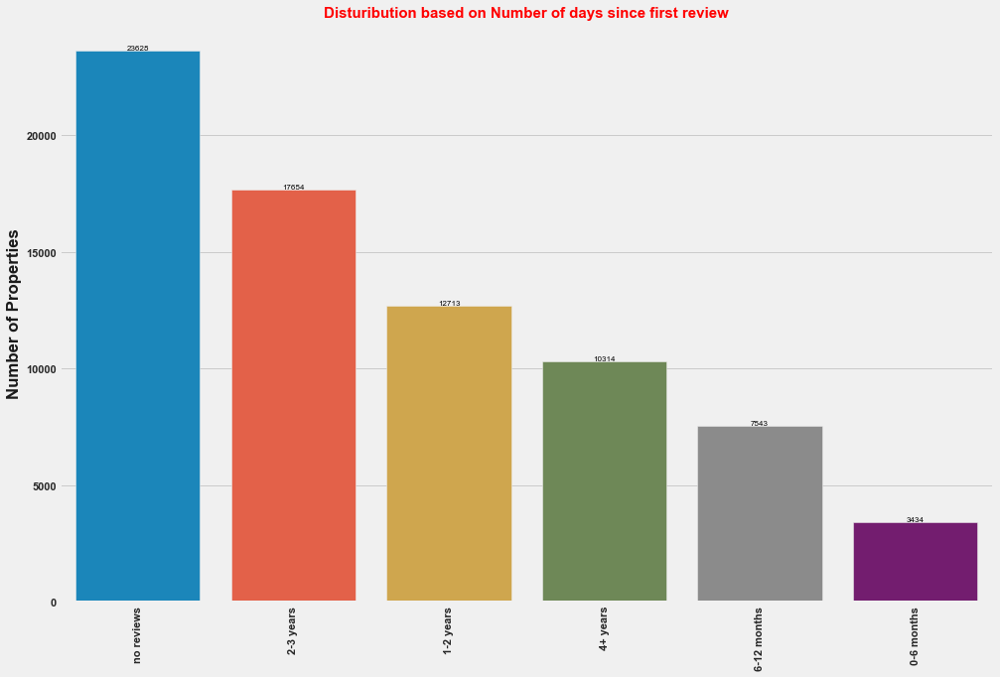

In [121]:
#Barplot of days_since_first_review 

plt.figure(figsize=(15,10)),

ax = sns.barplot(x="days_since_first_review", y="count", data=first_review_count)
plt.title("Disturibution based on Number of days since first review", weight="bold", c="red", fontsize=15)
plt.xlabel("",weight="bold",c="k")
plt.xticks(rotation=90, weight="bold")
plt.ylabel("Number of Properties",weight= "bold",c="k")
plt.yticks(weight="bold")
for p in ax.patches:
        ax.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()),
                    ha='center', va='bottom',
                    color= 'black', size=8)

plt.show()

We can see that majority of the properties have no first reviews. Let's look at the last reviews:

In [122]:
last_review_count = listings.groupby("days_since_last_review").id.count().sort_values(ascending=False)
last_review_count = last_review_count.reset_index()
last_review_count.rename(columns={"id":"count"}, inplace=True)
last_review_count["percentage"]=round(last_review_count["count"]/last_review_count["count"].sum()*100,2)
last_review_count.head(10)

,days_since_last_review,count,percentage
0,no reviews,32465,43.12
1,1+ year,18824,25.00
2,2-6 months,12375,16.44
3,6-12 months,9887,13.13
4,2-8 weeks,1053,1.40
5,0-2 weeks,682,0.91


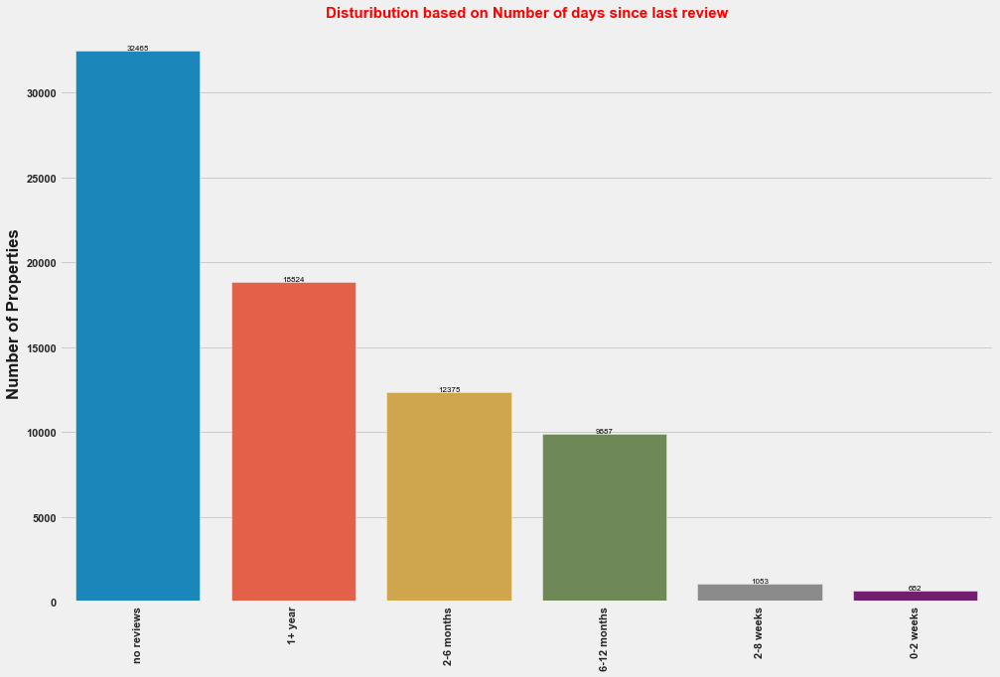

In [123]:
#Barplot of days_since_last_review

plt.figure(figsize=(15,10)),

ax = sns.barplot(x="days_since_last_review", y="count", data=last_review_count)
plt.title("Disturibution based on Number of days since last review", weight="bold", c="red", fontsize=15)
plt.xlabel("",weight="bold",c="k")
plt.xticks(rotation=90, weight="bold")
plt.ylabel("Number of Properties",weight= "bold",c="k")
plt.yticks(weight="bold")
for p in ax.patches:
        ax.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()),
                    ha='center', va='bottom',
                    color= 'black', size=8)

plt.show()

The same is true for last review. We assume that the listings with no reviews has no bookings. Let's investigate the pricing of these listings without reviews. 

In [125]:
#selecting only features we want to analysis for this exploration.
#look at the data we had prepared from above.
df = listings[['id','property_type', 'price', 'neighbourhood_cleansed', 'room_type', 'accommodates', 'bedrooms', 'beds', 'last_review', 'first_review' ]].copy()
df

,id,property_type,price,neighbourhood_cleansed,room_type,accommodates,bedrooms,beds,last_review,first_review
0,11551,Entire apartment,97.0,Lambeth,Entire home/apt,4,1.0,3.0,2020-03-26,2010-03-21
1,13913,Private room in apartment,40.0,Islington,Private room,2,1.0,0.0,2020-02-22,2010-08-18
2,15400,Entire apartment,75.0,Kensington and Chelsea,Entire home/apt,2,1.0,1.0,2020-03-16,2009-12-21
3,17402,Entire apartment,307.0,Westminster,Entire home/apt,6,3.0,3.0,2019-02-11,2011-03-21
4,17506,Private room in bed and breakfast,150.0,Hammersmith and Fulham,Private room,2,1.0,1.0,NaT,NaT
...,...,...,...,...,...,...,...,...,...,...
76979,46259322,Entire apartment,90.0,Westminster,Entire home/apt,2,1.0,1.0,NaT,NaT
76980,46259459,Private room in apartment,87.0,Westminster,Private room,2,1.0,2.0,NaT,NaT
76981,46259503,Private room in house,26.0,Redbridge,Private room,2,1.0,1.0,NaT,NaT
76982,46259530,Private room in apartment,59.0,Hammersmith and Fulham,Private room,2,1.0,1.0,NaT,NaT


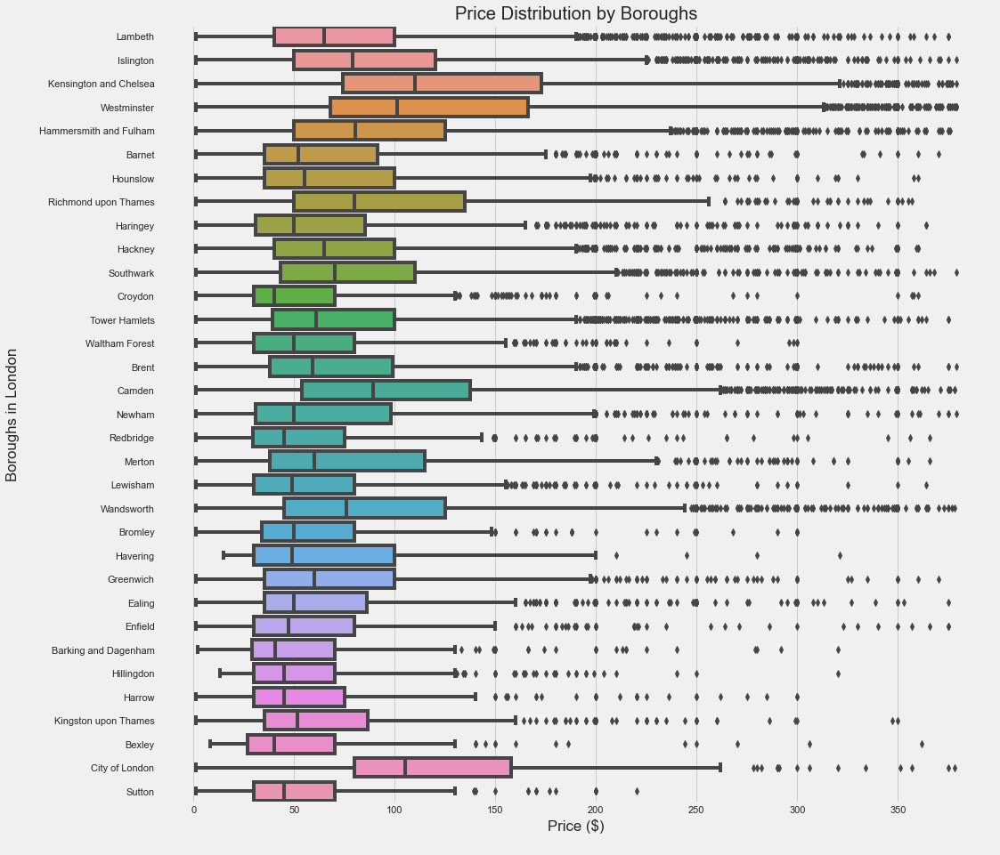

In [53]:
# Plot price Distribution by Borough
fig, ax = plt.subplots(figsize=(15, 15))

sns.boxplot(x='price', y='neighbourhood_cleansed',  
            data=df, orient='h', ax=ax).set(xlabel='Price ($)\n', ylabel='Boroughs in London\n')
ax.set_title('Price Distribution by Boroughs')
plt.show()

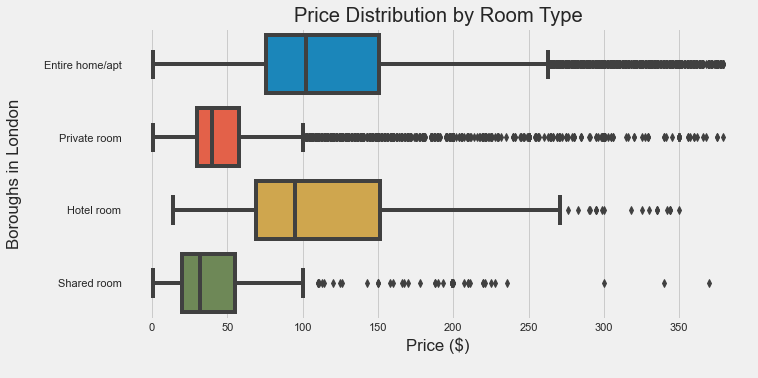

In [60]:
# Plot price Distribution by room type
fig, ax = plt.subplots(figsize=(10, 5))

sns.boxplot(x='price', y='room_type',  
            data=df, orient='h', ax=ax).set(xlabel='Price ($)\n', ylabel='Boroughs in London\n')
ax.set_title('Price Distribution by Room Type')
plt.show()

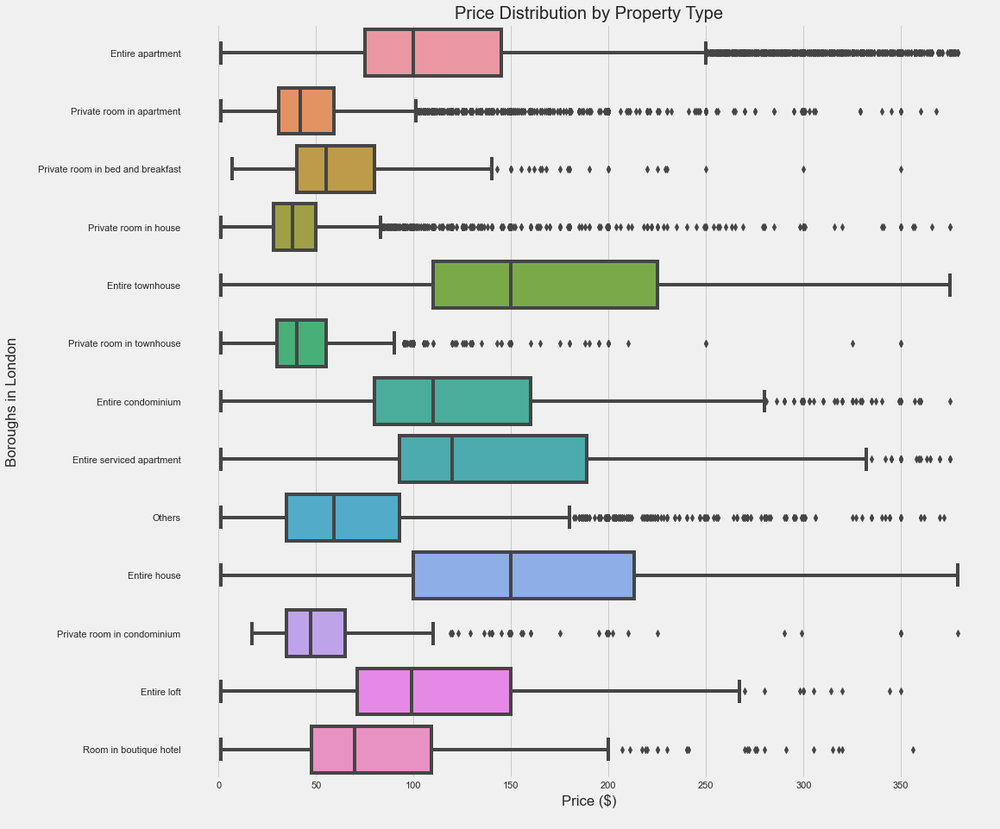

In [59]:
# Plot price Distribution by Property type
fig, ax = plt.subplots(figsize=(15, 15))

sns.boxplot(x='price', y='property_type',  
            data=df, orient='h', ax=ax).set(xlabel='Price ($)\n', ylabel='Boroughs in London\n')
ax.set_title('Price Distribution by Property Type')
plt.show()

In [63]:
df = df.sort_values(by='price',ascending=False)
df.head(50)

,id,price,neighbourhood_cleansed,room_type,property_type
48318,32210312,379.0,Westminster,Entire home/apt,Entire apartment
52889,35063577,379.0,Newham,Entire home/apt,Entire apartment
14853,12323550,379.0,Brent,Entire home/apt,Entire house
40923,27410427,379.0,Westminster,Entire home/apt,Entire apartment
63205,40257277,379.0,Westminster,Entire home/apt,Entire apartment
54740,36059507,379.0,Southwark,Private room,Private room in condominium
46694,31096654,379.0,Kensington and Chelsea,Entire home/apt,Entire apartment
22116,16943808,379.0,Islington,Entire home/apt,Entire house
36370,24383442,379.0,Westminster,Entire home/apt,Entire apartment
45622,30349737,378.0,Westminster,Entire home/apt,Entire apartment


In [68]:
#We also want to look at the full picture of price by using the orginal dataset without removal of outliers
df_1 = raw_listings[['id','property_type', 'price', 'neighbourhood_cleansed', 'room_type', 'accommodates', 'bedrooms', 'beds', 'last_review', 'first_review']].copy()
df_1[['price']] = df_1[['price']].apply(strip_and_convert)
df_1

,id,property_type,price,neighbourhood_cleansed,room_type,accommodates,bedrooms,beds,last_review
0,11551,Entire apartment,97.0,Lambeth,Entire home/apt,4,1.0,3.0,26/03/2020
1,13913,Private room in apartment,40.0,Islington,Private room,2,1.0,0.0,22/02/2020
2,15400,Entire apartment,75.0,Kensington and Chelsea,Entire home/apt,2,1.0,1.0,16/03/2020
3,17402,Entire apartment,307.0,Westminster,Entire home/apt,6,3.0,3.0,02/11/2019
4,17506,Private room in bed and breakfast,150.0,Hammersmith and Fulham,Private room,2,1.0,1.0,NaN
...,...,...,...,...,...,...,...,...,...
76979,46259322,Entire apartment,90.0,Westminster,Entire home/apt,2,1.0,1.0,NaN
76980,46259459,Private room in apartment,87.0,Westminster,Private room,2,1.0,2.0,NaN
76981,46259503,Private room in house,26.0,Redbridge,Private room,2,1.0,1.0,NaN
76982,46259530,Private room in apartment,59.0,Hammersmith and Fulham,Private room,2,1.0,NaN,NaN


In [69]:
df_1 = df_1.sort_values(by='price',ascending=False)
df_1.head(50)

,id,property_type,price,neighbourhood_cleansed,room_type,accommodates,bedrooms,beds,last_review
32177,21965077,Entire apartment,999.0,Tower Hamlets,Entire home/apt,1,1.0,3.0,NaN
33037,22399546,Entire townhouse,999.0,Kensington and Chelsea,Entire home/apt,12,6.0,7.0,06/08/2020
70573,43541085,Private room in apartment,999.0,Islington,Private room,6,NaN,12.0,NaN
17482,13905660,Entire townhouse,999.0,Westminster,Entire home/apt,16,8.0,19.0,10/09/2020
38626,25932168,Room in boutique hotel,999.0,Kensington and Chelsea,Hotel room,2,1.0,2.0,NaN
53847,35598448,Entire apartment,999.0,Camden,Entire home/apt,2,1.0,1.0,07/09/2019
57281,37380064,Entire serviced apartment,999.0,Kensington and Chelsea,Entire home/apt,6,2.0,3.0,29/09/2019
21869,16787058,Entire apartment,999.0,Kensington and Chelsea,Entire home/apt,2,1.0,1.0,19/05/2017
56051,36757390,Entire apartment,999.0,Lambeth,Entire home/apt,5,3.0,3.0,25/08/2019
45594,30339461,Entire apartment,995.0,Camden,Entire home/apt,10,3.0,5.0,01/12/2019


In [75]:
#Checking for listings with no last reviews.
df_2 = df_1[df_1['last_review'].isna()]
df_2

,id,property_type,price,neighbourhood_cleansed,room_type,accommodates,bedrooms,beds,last_review
32177,21965077,Entire apartment,999.0,Tower Hamlets,Entire home/apt,1,1.0,3.0,NaN
70573,43541085,Private room in apartment,999.0,Islington,Private room,6,NaN,12.0,NaN
38626,25932168,Room in boutique hotel,999.0,Kensington and Chelsea,Hotel room,2,1.0,2.0,NaN
48481,32327505,Entire house,995.0,Kensington and Chelsea,Entire home/apt,8,4.0,4.0,NaN
41640,27775083,Entire serviced apartment,992.0,Kensington and Chelsea,Entire home/apt,7,3.0,4.0,NaN
...,...,...,...,...,...,...,...,...,...
76416,46060845,Private room in condominium,0.0,Hackney,Private room,1,1.0,1.0,NaN
75001,45589684,Private room in condominium,0.0,Hackney,Private room,1,1.0,1.0,NaN
67251,42065766,Room in serviced apartment,0.0,Kensington and Chelsea,Hotel room,4,NaN,NaN,NaN
73623,45148705,Private room in condominium,0.0,Tower Hamlets,Private room,1,1.0,1.0,NaN


In [79]:
df_3 = df_2.sort_values(by='price',ascending=False)
df_3.head(50)

,id,property_type,price,neighbourhood_cleansed,room_type,accommodates,bedrooms,beds,last_review
32177,21965077,Entire apartment,999.0,Tower Hamlets,Entire home/apt,1,1.0,3.0,NaN
38626,25932168,Room in boutique hotel,999.0,Kensington and Chelsea,Hotel room,2,1.0,2.0,NaN
70573,43541085,Private room in apartment,999.0,Islington,Private room,6,NaN,12.0,NaN
48481,32327505,Entire house,995.0,Kensington and Chelsea,Entire home/apt,8,4.0,4.0,NaN
41640,27775083,Entire serviced apartment,992.0,Kensington and Chelsea,Entire home/apt,7,3.0,4.0,NaN
34611,23325697,Entire villa,992.0,Lambeth,Entire home/apt,8,5.0,6.0,NaN
34247,23146634,Entire apartment,989.0,Westminster,Entire home/apt,6,3.0,3.0,NaN
66459,41705658,Entire apartment,984.0,Kensington and Chelsea,Entire home/apt,8,5.0,6.0,NaN
61453,39492501,Entire house,980.0,Westminster,Entire home/apt,8,4.0,4.0,NaN
60301,38947559,Entire serviced apartment,962.0,Westminster,Entire home/apt,4,2.0,2.0,NaN


In [80]:
df_3.tail(50)

,id,property_type,price,neighbourhood_cleansed,room_type,accommodates,bedrooms,beds,last_review
67414,42136512,Entire apartment,1.0,Kensington and Chelsea,Entire home/apt,8,4.0,4.0,NaN
56554,37001494,Room in boutique hotel,1.0,Sutton,Private room,2,1.0,1.0,NaN
41598,27753866,Entire apartment,1.0,Kensington and Chelsea,Entire home/apt,11,5.0,6.0,NaN
64774,40856597,Entire apartment,1.0,Kensington and Chelsea,Entire home/apt,6,3.0,3.0,NaN
67720,42264077,Entire house,1.0,Kensington and Chelsea,Entire home/apt,7,4.0,4.0,NaN
56573,37011387,Room in hotel,1.0,Westminster,Private room,2,1.0,1.0,NaN
14255,11837706,Entire house,1.0,Kensington and Chelsea,Entire home/apt,9,4.0,7.0,NaN
56553,37001203,Room in boutique hotel,1.0,Sutton,Private room,3,1.0,2.0,NaN
56327,36905399,Room in hotel,1.0,Westminster,Private room,2,1.0,1.0,NaN
61338,39436239,Entire serviced apartment,1.0,Westminster,Entire home/apt,4,2.0,3.0,NaN


In [82]:
df_3 = df_3[df_3.price>10]
df_3.tail(50)

,id,property_type,price,neighbourhood_cleansed,room_type,accommodates,bedrooms,beds,last_review
17451,13893185,Private room in townhouse,15.0,Lambeth,Private room,1,1.0,1.0,NaN
33066,22429373,Private room in house,15.0,Greenwich,Private room,1,1.0,1.0,NaN
68553,42596087,Private room in apartment,15.0,Tower Hamlets,Private room,2,1.0,1.0,NaN
70048,43138626,Private room in apartment,15.0,Brent,Private room,1,1.0,0.0,NaN
42496,28345358,Private room in apartment,15.0,Tower Hamlets,Private room,1,1.0,1.0,NaN
16834,13614606,Private room in apartment,15.0,Waltham Forest,Private room,2,1.0,1.0,NaN
70785,43711255,Private room in house,15.0,Ealing,Private room,2,1.0,1.0,NaN
76886,46208223,Private room in apartment,15.0,Islington,Private room,1,1.0,1.0,NaN
76953,46242506,Shared room in apartment,15.0,Hackney,Shared room,2,1.0,1.0,NaN
49681,33075484,Private room in apartment,15.0,Harrow,Private room,1,1.0,1.0,NaN


In [83]:
df_3

,id,property_type,price,neighbourhood_cleansed,room_type,accommodates,bedrooms,beds,last_review
32177,21965077,Entire apartment,999.0,Tower Hamlets,Entire home/apt,1,1.0,3.0,NaN
38626,25932168,Room in boutique hotel,999.0,Kensington and Chelsea,Hotel room,2,1.0,2.0,NaN
70573,43541085,Private room in apartment,999.0,Islington,Private room,6,NaN,12.0,NaN
48481,32327505,Entire house,995.0,Kensington and Chelsea,Entire home/apt,8,4.0,4.0,NaN
41640,27775083,Entire serviced apartment,992.0,Kensington and Chelsea,Entire home/apt,7,3.0,4.0,NaN
...,...,...,...,...,...,...,...,...,...
76448,46068797,Shared room in hostel,11.0,Barnet,Shared room,1,1.0,1.0,NaN
5666,5102977,Private room,11.0,Haringey,Private room,2,1.0,1.0,NaN
16935,13655648,Private room in apartment,11.0,Hackney,Private room,1,1.0,1.0,NaN
76449,46069243,Shared room in hostel,11.0,Barnet,Shared room,1,1.0,1.0,NaN


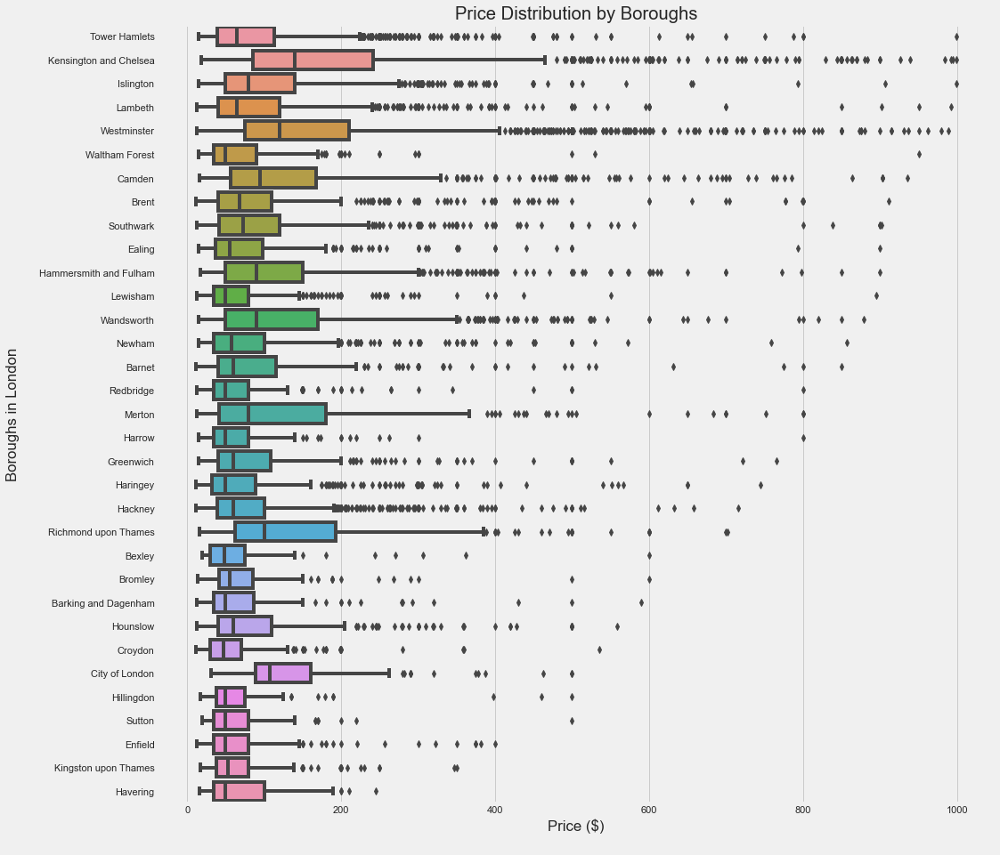

In [84]:
# Plot price Distribution by Borough
fig, ax = plt.subplots(figsize=(15, 15))

sns.boxplot(x='price', y='neighbourhood_cleansed',  
            data=df_3, orient='h', ax=ax).set(xlabel='Price ($)\n', ylabel='Boroughs in London\n')
ax.set_title('Price Distribution by Boroughs ')
plt.show()

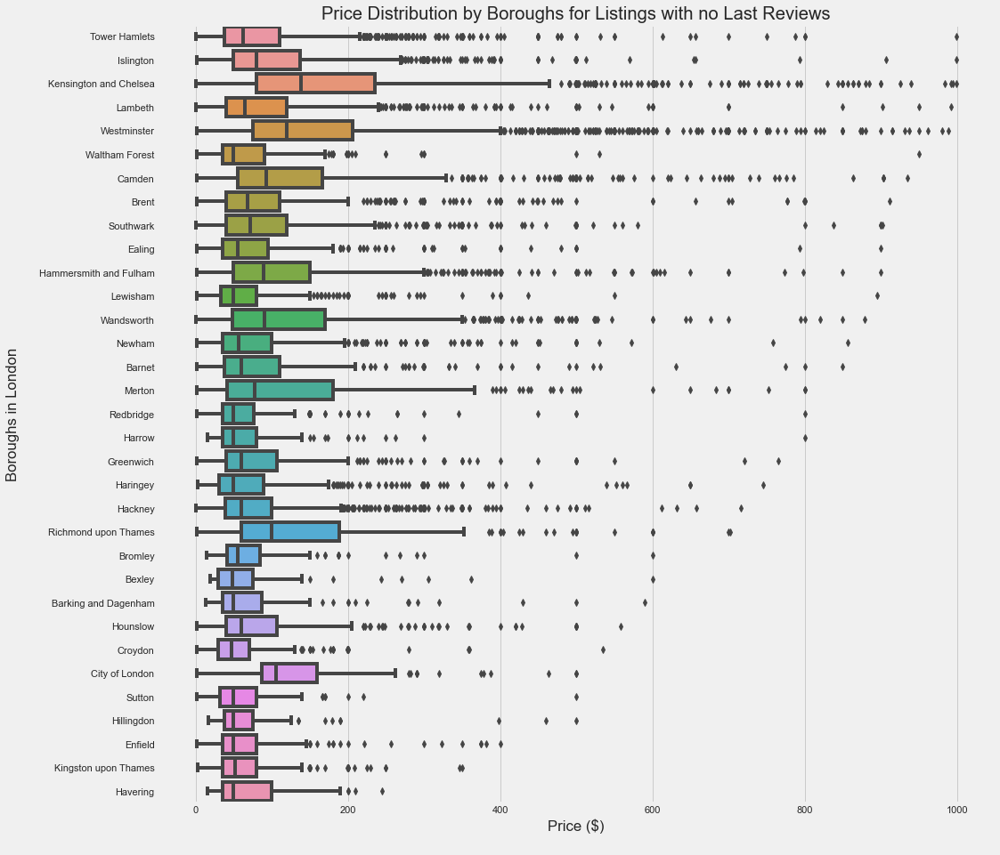

In [87]:
# Plot price Distribution by Borough
fig, ax = plt.subplots(figsize=(15, 15))

sns.boxplot(x='price', y='neighbourhood_cleansed',  
            data=df_2, orient='h', ax=ax).set(xlabel='Price ($)\n', ylabel='Boroughs in London\n')
ax.set_title('Price Distribution by Boroughs for Listings with no Last Reviews')
plt.show()

In [88]:
borough_group_count = df_2.groupby("neighbourhood_cleansed").id.count().sort_values(ascending=False)
borough_group_count = borough_group_count.reset_index()
borough_group_count.rename(columns={"id":"count"}, inplace=True)
borough_group_count["percentage"]=round(borough_group_count["count"]/borough_group_count["count"].sum()*100,2)
borough_group_count.head(10)

,neighbourhood_cleansed,count,percentage
0,Westminster,2637,12.13
1,Tower Hamlets,1936,8.91
2,Kensington and Chelsea,1610,7.41
3,Hackney,1472,6.77
4,Camden,1354,6.23
5,Islington,1137,5.23
6,Wandsworth,1131,5.20
7,Lambeth,1068,4.91
8,Southwark,1063,4.89
9,Hammersmith and Fulham,959,4.41


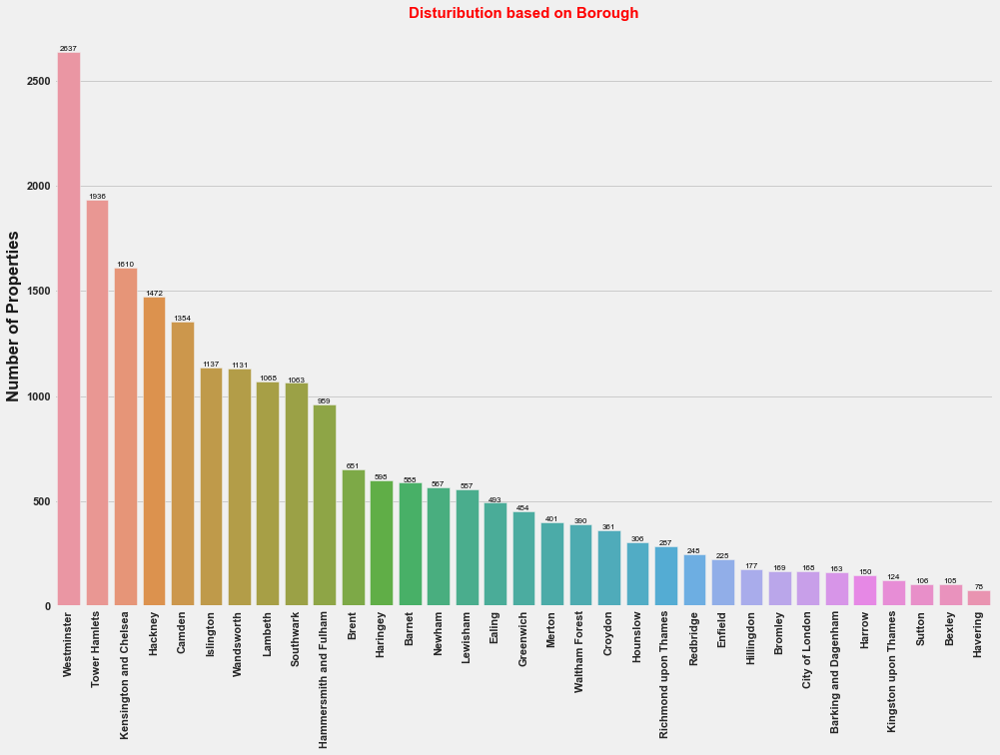

In [89]:
#Barplot of Borough 

plt.figure(figsize=(15,10)),

ax = sns.barplot(x="neighbourhood_cleansed", y="count", data=borough_group_count)
plt.title("Disturibution based on Borough", weight="bold", c="red", fontsize=15)
plt.xlabel("",weight="bold",c="k")
plt.xticks(rotation=90, weight="bold")
plt.ylabel("Number of Properties",weight= "bold",c="k")
plt.yticks(weight="bold")
for p in ax.patches:
        ax.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()),
                    ha='center', va='bottom',
                    color= 'black', size=8)

plt.show()

In [90]:
# Group by Borough for price

borough_group_price = df_2.groupby("neighbourhood_cleansed").price.mean().sort_values(ascending=False)
borough_group_price = borough_group_price.reset_index()
borough_group_price.head()

,neighbourhood_cleansed,price
0,Kensington and Chelsea,187.278261
1,Westminster,168.356086
2,Richmond upon Thames,145.700348
3,City of London,134.190476
4,Camden,133.368538


In [101]:
borough_group_price.head(50)

,neighbourhood_cleansed,price
0,Kensington and Chelsea,187.278261
1,Westminster,168.356086
2,Richmond upon Thames,145.700348
3,City of London,134.190476
4,Camden,133.368538
5,Wandsworth,128.113174
6,Merton,127.603491
7,Hammersmith and Fulham,122.036496
8,Islington,109.572559
9,Brent,105.414747


In [107]:
avg_price = round(df2.price.mean(),2)
avg_price

113.96

In [91]:
avg_price = round(df_2.price.mean(),2)
avg_price

113.96

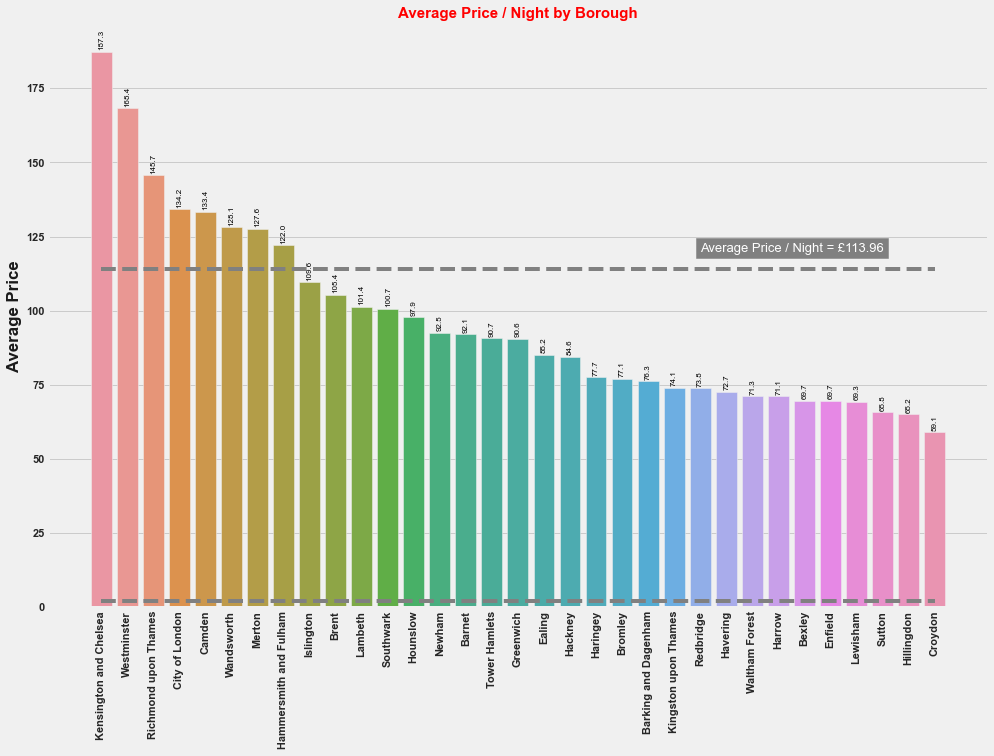

In [100]:
# Barplot of Borough's Price/Night

plt.figure(figsize=(15,10)),

ax = sns.barplot(x="neighbourhood_cleansed", y="price", data=borough_group_price)
plt.title("Average Price / Night by Borough", weight="bold", c="red", fontsize=15)
plt.xlabel("",weight="bold",c="k")
plt.xticks(rotation=90, weight="bold")
plt.ylabel("Average Price",weight= "bold",c="k")
plt.yticks(weight="bold")
for p in ax.patches:
        ax.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()+0.5),
                    ha='center', va='bottom',
                    color= 'black', size=8, rotation=90)

y_median = [(df_2.price.mean(),2), (df_2.price.mean(),2)]

plt.plot([0, 32], y_median,linestyle = '--', c="gray")
plt.text(23,120,'Average Price / Night = £113.96',fontsize = 13,backgroundcolor = 'gray',color = 'white')



plt.show()

In [103]:

df1 = raw_listings[['id','property_type', 'price', 'neighbourhood_cleansed', 'room_type', 'accommodates', 'bedrooms', 'beds', 'last_review', 'first_review']].copy()
df1[['price']] = df1[['price']].apply(strip_and_convert)
df1


,id,property_type,price,neighbourhood_cleansed,room_type,accommodates,bedrooms,beds,last_review,first_review
0,11551,Entire apartment,97.0,Lambeth,Entire home/apt,4,1.0,3.0,26/03/2020,21/03/2010
1,13913,Private room in apartment,40.0,Islington,Private room,2,1.0,0.0,22/02/2020,18/08/2010
2,15400,Entire apartment,75.0,Kensington and Chelsea,Entire home/apt,2,1.0,1.0,16/03/2020,21/12/2009
3,17402,Entire apartment,307.0,Westminster,Entire home/apt,6,3.0,3.0,02/11/2019,21/03/2011
4,17506,Private room in bed and breakfast,150.0,Hammersmith and Fulham,Private room,2,1.0,1.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
76979,46259322,Entire apartment,90.0,Westminster,Entire home/apt,2,1.0,1.0,NaN,NaN
76980,46259459,Private room in apartment,87.0,Westminster,Private room,2,1.0,2.0,NaN,NaN
76981,46259503,Private room in house,26.0,Redbridge,Private room,2,1.0,1.0,NaN,NaN
76982,46259530,Private room in apartment,59.0,Hammersmith and Fulham,Private room,2,1.0,NaN,NaN,NaN


In [105]:
df1 = df1.sort_values(by='price',ascending=False)
df2 = df1[df1['first_review'].isna()] #21733 rows of nan last_review the exact same for last review
df2

,id,property_type,price,neighbourhood_cleansed,room_type,accommodates,bedrooms,beds,last_review,first_review
32177,21965077,Entire apartment,999.0,Tower Hamlets,Entire home/apt,1,1.0,3.0,NaN,NaN
38626,25932168,Room in boutique hotel,999.0,Kensington and Chelsea,Hotel room,2,1.0,2.0,NaN,NaN
70573,43541085,Private room in apartment,999.0,Islington,Private room,6,NaN,12.0,NaN,NaN
48481,32327505,Entire house,995.0,Kensington and Chelsea,Entire home/apt,8,4.0,4.0,NaN,NaN
41640,27775083,Entire serviced apartment,992.0,Kensington and Chelsea,Entire home/apt,7,3.0,4.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
76416,46060845,Private room in condominium,0.0,Hackney,Private room,1,1.0,1.0,NaN,NaN
75001,45589684,Private room in condominium,0.0,Hackney,Private room,1,1.0,1.0,NaN,NaN
67251,42065766,Room in serviced apartment,0.0,Kensington and Chelsea,Hotel room,4,NaN,NaN,NaN,NaN
73623,45148705,Private room in condominium,0.0,Tower Hamlets,Private room,1,1.0,1.0,NaN,NaN


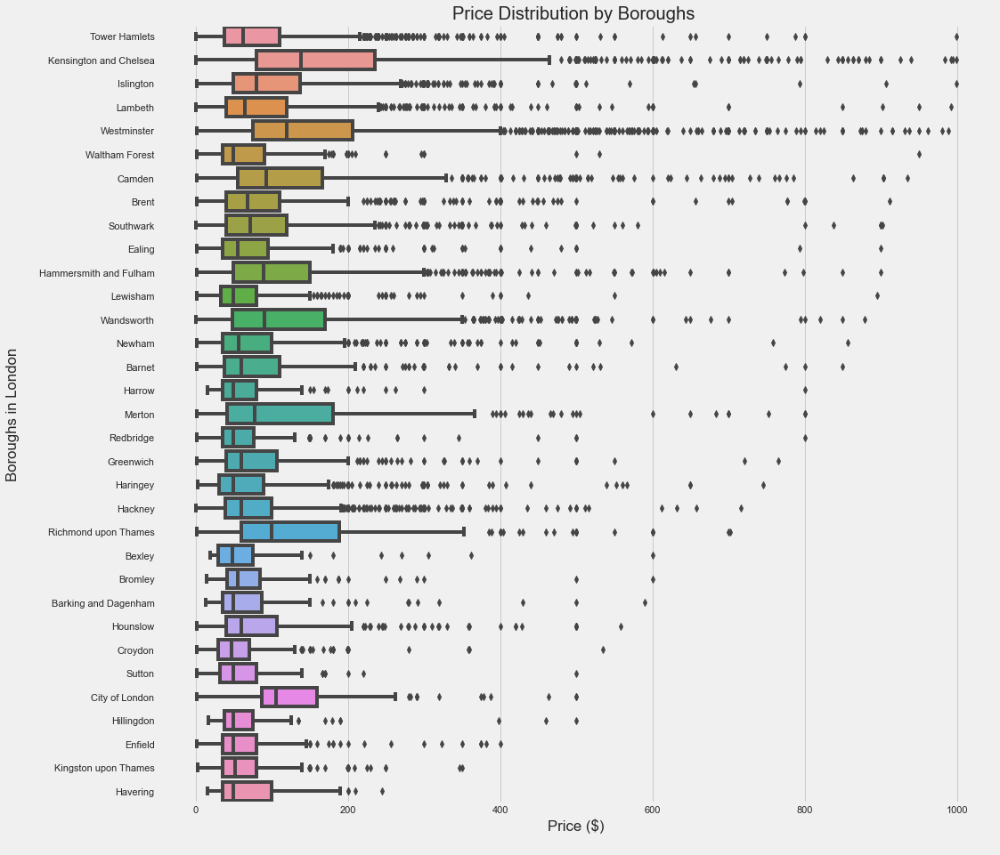

In [106]:
# Plot price Distribution by Borough
fig, ax = plt.subplots(figsize=(15, 15))

sns.boxplot(x='price', y='neighbourhood_cleansed',  
            data=df2, orient='h', ax=ax).set(xlabel='Price ($)\n', ylabel='Boroughs in London\n')
ax.set_title('Price Distribution by Boroughs ')
plt.show()

In [108]:
borough_group_price = df2.groupby("neighbourhood_cleansed").price.mean().sort_values(ascending=False)
borough_group_price = borough_group_price.reset_index()
borough_group_price.head(50)

,neighbourhood_cleansed,price
0,Kensington and Chelsea,187.278261
1,Westminster,168.356086
2,Richmond upon Thames,145.700348
3,City of London,134.190476
4,Camden,133.368538
5,Wandsworth,128.113174
6,Merton,127.603491
7,Hammersmith and Fulham,122.036496
8,Islington,109.572559
9,Brent,105.414747


In [109]:
borough_group_count = df2.groupby("neighbourhood_cleansed").id.count().sort_values(ascending=False)
borough_group_count = borough_group_count.reset_index()
borough_group_count.rename(columns={"id":"count"}, inplace=True)
borough_group_count["percentage"]=round(borough_group_count["count"]/borough_group_count["count"].sum()*100,2)
borough_group_count.head(10)

,neighbourhood_cleansed,count,percentage
0,Westminster,2637,12.13
1,Tower Hamlets,1936,8.91
2,Kensington and Chelsea,1610,7.41
3,Hackney,1472,6.77
4,Camden,1354,6.23
5,Islington,1137,5.23
6,Wandsworth,1131,5.20
7,Lambeth,1068,4.91
8,Southwark,1063,4.89
9,Hammersmith and Fulham,959,4.41


Looks like the reviews with no first reviews are the same as the reviews with no last reviews. Their box plot and price distribution, listings count and percentage are all the same. We can conclude that these properties. Let's investigate further

In [111]:
#Let's look at listing with prices 4x std deviation as they were termed as our outliers.

df2_high = df2[df2.price>378]
df2_high #there are 869 listings.

,id,property_type,price,neighbourhood_cleansed,room_type,accommodates,bedrooms,beds,last_review,first_review
32177,21965077,Entire apartment,999.0,Tower Hamlets,Entire home/apt,1,1.0,3.0,NaN,NaN
38626,25932168,Room in boutique hotel,999.0,Kensington and Chelsea,Hotel room,2,1.0,2.0,NaN,NaN
70573,43541085,Private room in apartment,999.0,Islington,Private room,6,NaN,12.0,NaN,NaN
48481,32327505,Entire house,995.0,Kensington and Chelsea,Entire home/apt,8,4.0,4.0,NaN,NaN
41640,27775083,Entire serviced apartment,992.0,Kensington and Chelsea,Entire home/apt,7,3.0,4.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
37623,25174484,Private room in apartment,380.0,Hackney,Private room,1,1.0,1.0,NaN,NaN
74081,45306283,Entire house,380.0,Westminster,Entire home/apt,5,3.0,3.0,NaN,NaN
72891,44655075,Entire house,380.0,Kensington and Chelsea,Entire home/apt,4,2.0,2.0,NaN,NaN
56187,36829541,Entire house,380.0,Wandsworth,Entire home/apt,6,4.0,4.0,NaN,NaN


In [112]:

borough_group_price = df2_high.groupby("neighbourhood_cleansed").price.mean().sort_values(ascending=False)
borough_group_price = borough_group_price.reset_index()
borough_group_price.head(50)

,neighbourhood_cleansed,price
0,Harrow,800.000000
1,Waltham Forest,660.000000
2,Bexley,600.000000
3,Camden,566.390625
4,Barnet,563.750000
5,Redbridge,562.500000
6,Kensington and Chelsea,561.325843
7,Lambeth,555.448276
8,Westminster,554.581197
9,Southwark,553.583333


In [113]:
borough_group_count = df2_high.groupby("neighbourhood_cleansed").id.count().sort_values(ascending=False)
borough_group_count = borough_group_count.reset_index()
borough_group_count.rename(columns={"id":"count"}, inplace=True)
borough_group_count["percentage"]=round(borough_group_count["count"]/borough_group_count["count"].sum()*100,2)
borough_group_count.head(80)

,neighbourhood_cleansed,count,percentage
0,Westminster,234,26.93
1,Kensington and Chelsea,178,20.48
2,Camden,64,7.36
3,Wandsworth,53,6.10
4,Hammersmith and Fulham,39,4.49
5,Tower Hamlets,31,3.57
6,Brent,30,3.45
7,Lambeth,29,3.34
8,Southwark,24,2.76
9,Islington,24,2.76


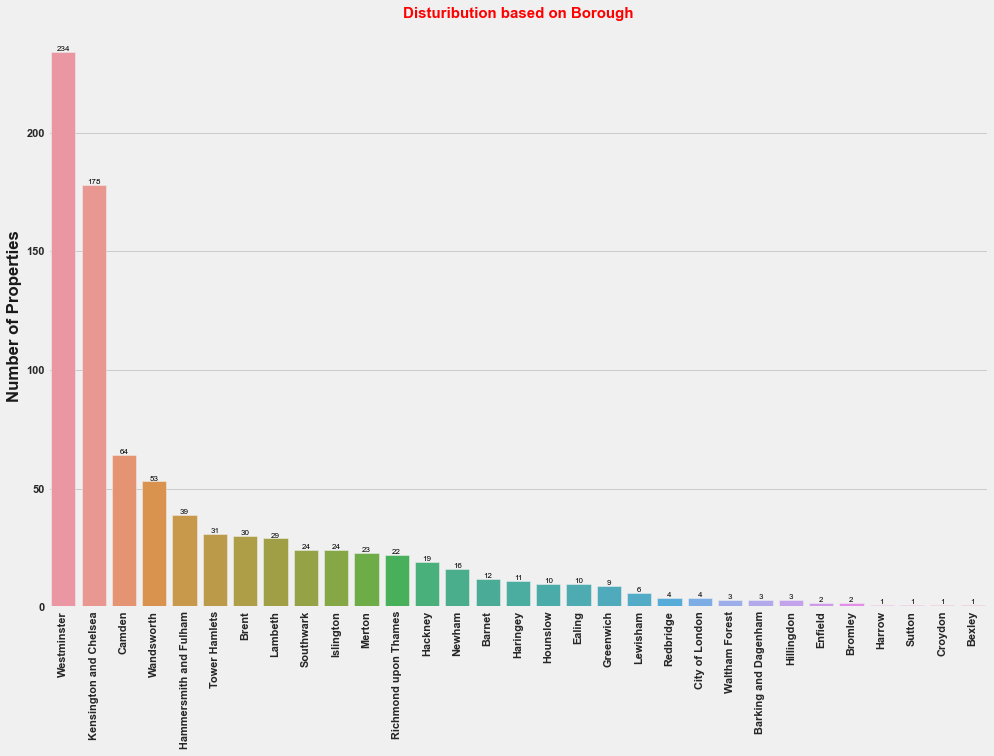

In [114]:
#Barplot of Borough 

plt.figure(figsize=(15,10)),

ax = sns.barplot(x="neighbourhood_cleansed", y="count", data=borough_group_count)
plt.title("Disturibution based on Borough", weight="bold", c="red", fontsize=15)
plt.xlabel("",weight="bold",c="k")
plt.xticks(rotation=90, weight="bold")
plt.ylabel("Number of Properties",weight= "bold",c="k")
plt.yticks(weight="bold")
for p in ax.patches:
        ax.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()),
                    ha='center', va='bottom',
                    color= 'black', size=8)

plt.show()

We can see that most of the expensive properties without any reviews (means no booking) falls in westminster and kensington and chelsea. Now, let's look at the other spectrum:

In [115]:
#Let's look at listing with prices lower than half the mean of 113

df2_low = df2[df2.price<56]
df2_low #there are 8117 listings.

,id,property_type,price,neighbourhood_cleansed,room_type,accommodates,bedrooms,beds,last_review,first_review
26661,19540744,Entire apartment,55.0,Southwark,Entire home/apt,3,1.0,4.0,NaN,NaN
47554,31692391,Private room in house,55.0,Kingston upon Thames,Private room,2,1.0,2.0,NaN,NaN
5891,5358533,Private room in bed and breakfast,55.0,Barking and Dagenham,Private room,1,1.0,1.0,NaN,NaN
20872,16192322,Private room in apartment,55.0,Camden,Private room,2,1.0,1.0,NaN,NaN
74194,45341674,Private room in apartment,55.0,Hackney,Private room,2,1.0,1.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
76416,46060845,Private room in condominium,0.0,Hackney,Private room,1,1.0,1.0,NaN,NaN
75001,45589684,Private room in condominium,0.0,Hackney,Private room,1,1.0,1.0,NaN,NaN
67251,42065766,Room in serviced apartment,0.0,Kensington and Chelsea,Hotel room,4,NaN,NaN,NaN,NaN
73623,45148705,Private room in condominium,0.0,Tower Hamlets,Private room,1,1.0,1.0,NaN,NaN


In [116]:
borough_group_price = df2_low.groupby("neighbourhood_cleansed").price.mean().sort_values(ascending=False)
borough_group_price = borough_group_price.reset_index()
borough_group_price.head(50)

,neighbourhood_cleansed,price
0,Bromley,39.388235
1,Islington,38.933333
2,Hammersmith and Fulham,38.471831
3,Greenwich,38.365741
4,Lambeth,38.106667
5,Harrow,38.098901
6,Camden,38.040346
7,Hillingdon,38.038835
8,Wandsworth,37.876404
9,Richmond upon Thames,37.650794


In [118]:
borough_group_count = df2_low.groupby("neighbourhood_cleansed").id.count().sort_values(ascending=False)
borough_group_count = borough_group_count.reset_index()
borough_group_count.rename(columns={"id":"count"}, inplace=True)
borough_group_count["percentage"]=round(borough_group_count["count"]/borough_group_count["count"].sum()*100,2)
borough_group_count.head(80)

,neighbourhood_cleansed,count,percentage
0,Tower Hamlets,889,10.95
1,Hackney,712,8.77
2,Westminster,457,5.63
3,Lambeth,450,5.54
4,Southwark,416,5.13
5,Islington,375,4.62
6,Wandsworth,356,4.39
7,Camden,347,4.27
8,Haringey,336,4.14
9,Lewisham,320,3.94


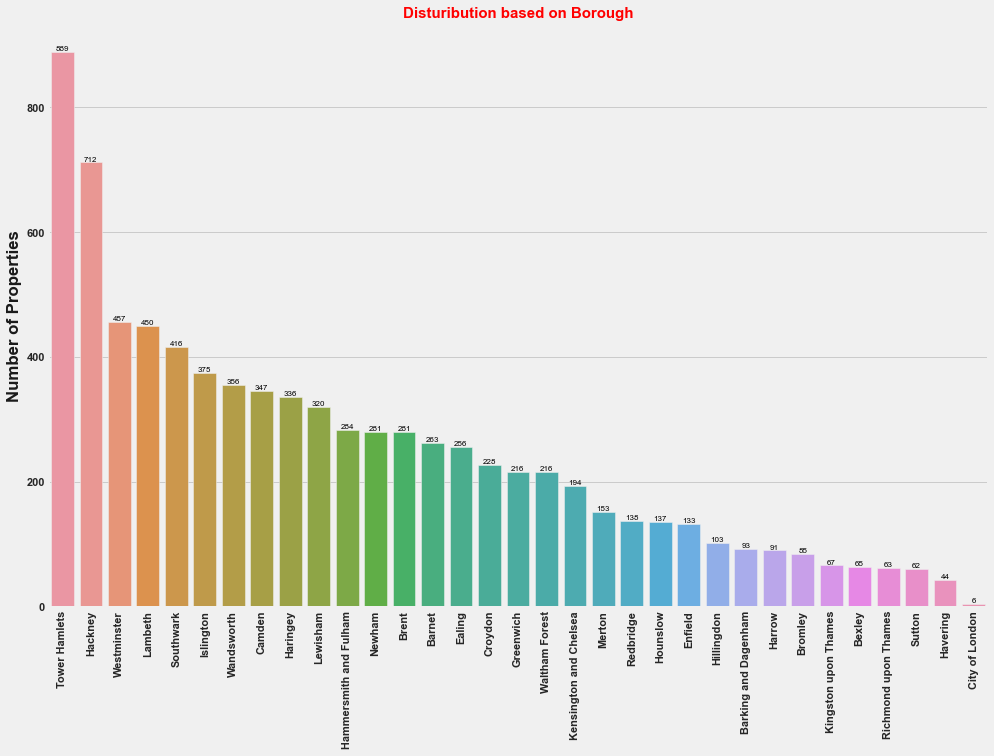

In [119]:
#Barplot of Borough 

plt.figure(figsize=(15,10)),

ax = sns.barplot(x="neighbourhood_cleansed", y="count", data=borough_group_count)
plt.title("Disturibution based on Borough", weight="bold", c="red", fontsize=15)
plt.xlabel("",weight="bold",c="k")
plt.xticks(rotation=90, weight="bold")
plt.ylabel("Number of Properties",weight= "bold",c="k")
plt.yticks(weight="bold")
for p in ax.patches:
        ax.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()),
                    ha='center', va='bottom',
                    color= 'black', size=8)

plt.show()

In [ ]:

borough_group_count = listings.groupby("neighbourhood_cleansed").id.count().sort_values(ascending=False)
borough_group_count = borough_group_count.reset_index()
borough_group_count.rename(columns={"id":"count"}, inplace=True)
borough_group_count["percentage"]=round(borough_group_count["count"]/borough_group_count["count"].sum()*100,2)
borough_group_count.head(10)

# question?<a class="anchor" id="q3b"></a>


# Price by Boroughs in London<a class="anchor" id="q3b_price"></a>


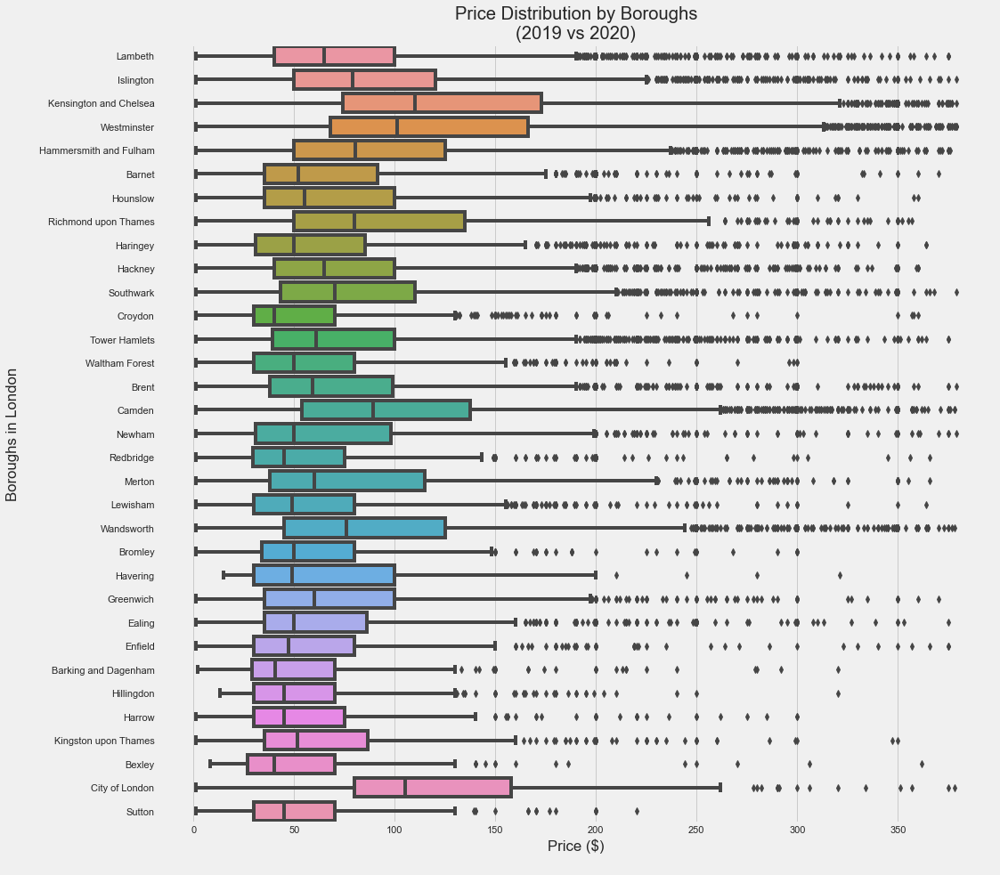

In [129]:
# Plot price Distribution by Borough
fig, ax = plt.subplots(figsize=(15, 15))

sns.boxplot(x='price', y='neighbourhood_cleansed', 
            data=listings, orient='h', ax=ax).set(xlabel='Price ($)\n', ylabel='Boroughs in London\n')
ax.set_title('Price Distribution by Boroughs\n(2019 vs 2020)')
plt.show()

Let's look at the distribution of properties and the average nightly price based on borough during the pandemic (2020)

In [60]:
# Group by Borough for count

borough_group_count = listings.groupby("neighbourhood_cleansed").id.count().sort_values(ascending=False)
borough_group_count = borough_group_count.reset_index()
borough_group_count.rename(columns={"id":"count"}, inplace=True)
borough_group_count["percentage"]=round(borough_group_count["count"]/borough_group_count["count"].sum()*100,2)
borough_group_count.head(10)

,neighbourhood_cleansed,count,percentage
0,Westminster,8091,10.75
1,Tower Hamlets,6770,8.99
2,Hackney,5671,7.53
3,Camden,5135,6.82
4,Kensington and Chelsea,4984,6.62
5,Islington,4438,5.89
6,Lambeth,4340,5.76
7,Southwark,4287,5.69
8,Wandsworth,3854,5.12
9,Hammersmith and Fulham,3498,4.65


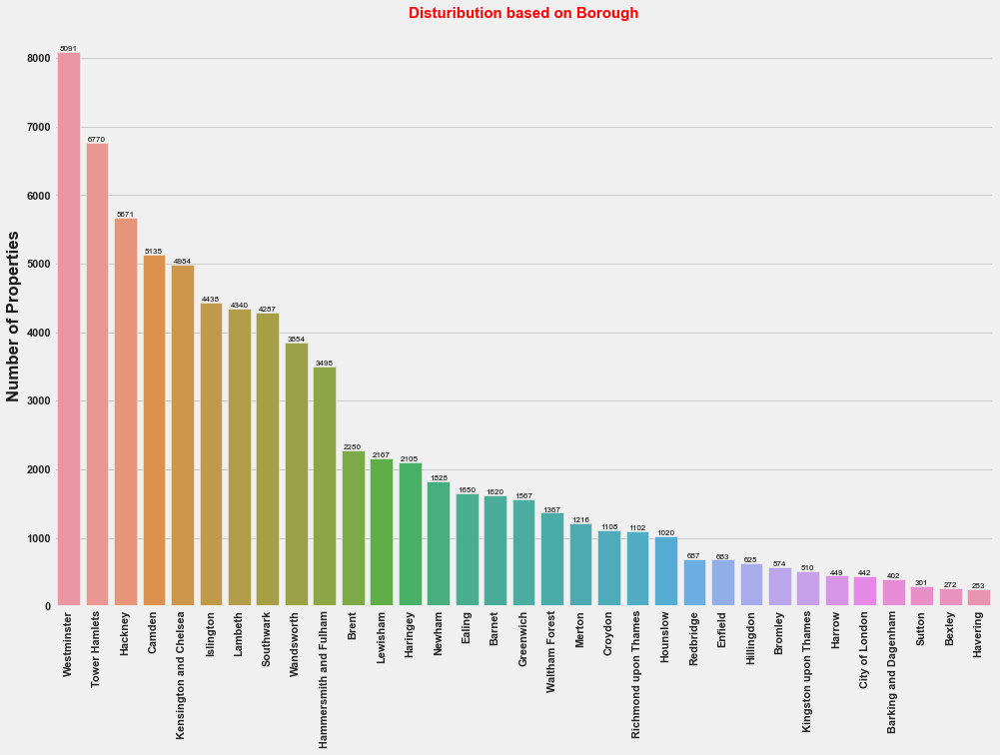

In [61]:
#Barplot of Borough 

plt.figure(figsize=(15,10)),

ax = sns.barplot(x="neighbourhood_cleansed", y="count", data=borough_group_count)
plt.title("Disturibution based on Borough", weight="bold", c="red", fontsize=15)
plt.xlabel("",weight="bold",c="k")
plt.xticks(rotation=90, weight="bold")
plt.ylabel("Number of Properties",weight= "bold",c="k")
plt.yticks(weight="bold")
for p in ax.patches:
        ax.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()),
                    ha='center', va='bottom',
                    color= 'black', size=8)

plt.show()


In [62]:
# Group by Borough for price

borough_group_price = listings.groupby("neighbourhood_cleansed").price.mean().sort_values(ascending=False)
borough_group_price = borough_group_price.reset_index()
borough_group_price.head()

,neighbourhood_cleansed,price
0,Kensington and Chelsea,130.522271
1,Westminster,125.399827
2,City of London,122.780543
3,Camden,104.694839
4,Richmond upon Thames,102.949183


In [109]:
avg_price = round(listings.price.mean(),2)
avg_price

90.4

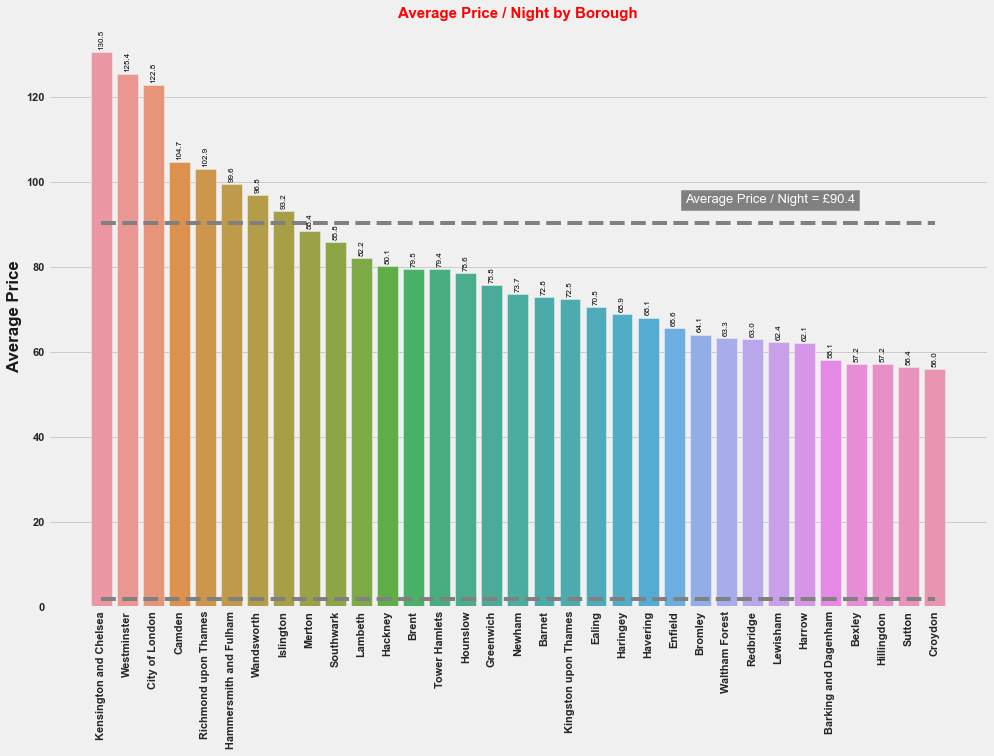

In [110]:
# Barplot of Borough's Price/Night

plt.figure(figsize=(15,10)),

ax = sns.barplot(x="neighbourhood_cleansed", y="price", data=borough_group_price)
plt.title("Average Price / Night by Borough", weight="bold", c="red", fontsize=15)
plt.xlabel("",weight="bold",c="k")
plt.xticks(rotation=90, weight="bold")
plt.ylabel("Average Price",weight= "bold",c="k")
plt.yticks(weight="bold")
for p in ax.patches:
        ax.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()+0.5),
                    ha='center', va='bottom',
                    color= 'black', size=8, rotation=90)

y_median = [(listings.price.mean(),2), (listings.price.mean(),2)]

plt.plot([0, 32], y_median,linestyle = '--', c="gray")
plt.text(22.4,95,'Average Price / Night = £90.4',fontsize = 13,backgroundcolor = 'gray',color = 'white')



plt.show()

We can see that Westminster has the most number of properties and the borough of Kensington and Chelsea has the most highest average price.

From the comparison between the price in 2019 vs 2020, we can see that the top three most expensive boroughs, Kensington and Chelsea, Westminster and City of London, had the big drops in that price.

On the contrary, boroughs with lower pricing experience only a small decrease in price. In fact, some borough like Bexley and Havering even priced their properties higher in 2020 than 2019.

# Impact of the price by Room Type<a class="anchor" id="q3b_price_rooms"></a>

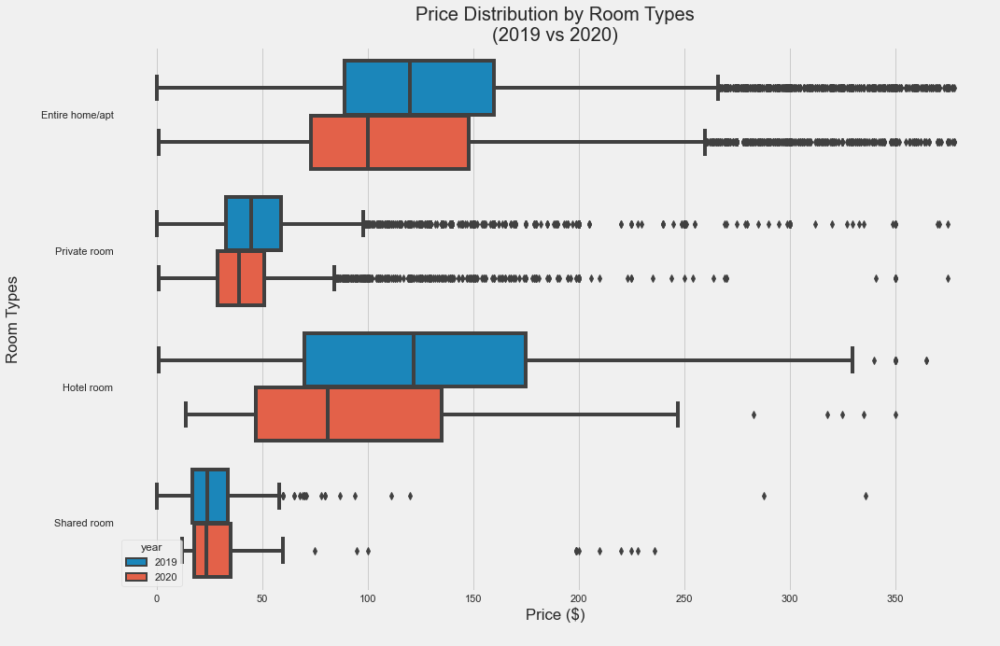

In [111]:
# Plot price Distribution by Room Types
fig, ax = plt.subplots(figsize=(15, 10))

final_df = merge[merge.price<379]
#final_df = merge[merge.price>0]
sns.boxplot(x='price', y='room_type', hue='year', 
            data=final_df, orient='h', ax=ax).set(xlabel='Price ($)\n', ylabel='Room Types\n')
ax.set_title('Price Distribution by Room Types\n(2019 vs 2020)')
plt.show()

As it was expected, Hotel Rooms and Entire Homes are the most expensive on average, followed by Private Rooms and Shared Rooms. The biggest drop in price from 2019 to 2020 happened for Hotel Rooms, followed by Entire Homes, whereas the price for Shared Rooms increased slightly and for Private Rooms decreased slightly.

# Correlation analysis<a class="anchor" id="correlation-analysis"></a>
Creating test_listings for corrlation testing:

In [38]:

# Drop features that is not related to price prediction like id, last_scraped and host_id.
# Drop features that we already processed but were using it for the EDA: first_review and last_review
# Drop features that starts with re

#review_cols = listings.columns[listings.columns.str.startswith("review_scores")]
#test_listings = listings.drop(review_cols, axis=1)
test_listings = listings.drop(columns=['last_review', 'id', 'host_id', 
                                  'first_review', 'last_scraped', 'host_since'])

# Include all object and category columns
cat_columns = test_listings.select_dtypes(include=['object', 'category']).columns
for col in cat_columns:    
    test_listings = pd.concat([test_listings.drop(col, axis=1), pd.get_dummies(test_listings[col], prefix=col, prefix_sep='_', drop_first=True)], axis=1) 
    
print(test_listings.shape)
test_listings.head()


(75286, 157)


,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count,host_has_profile_pic,host_identity_verified,latitude,longitude,accommodates,bathrooms,...,days_since_first_review_1-2 years,days_since_first_review_2-3 years,days_since_first_review_4+ years,days_since_first_review_6-12 months,days_since_first_review_no reviews,days_since_last_review_1+ year,days_since_last_review_2-6 months,days_since_last_review_2-8 weeks,days_since_last_review_6-12 months,days_since_last_review_no reviews
0,100.000000,100.000000,0.0,3.0,1.0,1.0,51.46225,-0.11732,4,1.0,...,0,0,1,0,0,0,1,0,0,0
1,83.000000,71.000000,0.0,3.0,1.0,1.0,51.56802,-0.11121,2,1.0,...,0,0,1,0,0,0,1,0,0,0
2,100.000000,100.000000,0.0,1.0,1.0,1.0,51.48796,-0.16898,2,1.0,...,0,0,1,0,0,0,1,0,0,0
3,67.000000,100.000000,1.0,18.0,1.0,1.0,51.52195,-0.14094,6,2.0,...,0,0,1,0,0,1,0,0,0,0
4,87.645506,81.269505,0.0,3.0,1.0,1.0,51.47935,-0.19743,2,1.0,...,0,0,0,0,1,0,0,0,0,1


In [39]:
#Since we already transformed the borough, we can drop the longitude and latitude
test_listings = test_listings.drop(columns=['longitude', 'latitude'])
                                  

# Pearson correlation with Price <a class="anchor" id="pearson"></a>

In [40]:
dfc = pd.DataFrame(test_listings.corr(method="pearson")["price"])
dfc.reset_index(inplace=True)
dfc.columns = ["features", "correlation_with_price"]
dfc.sort_values("correlation_with_price", ascending=False)
df1 = dfc[dfc["correlation_with_price"] > 0.1]
corr_features = df1["features"].values
corr_features.tolist().append("price")
print(df1.shape)
df1.sort_values(by=['correlation_with_price'], ascending=False)

(33, 2)


,features,correlation_with_price
10,price,1.000000
6,accommodates,0.600043
8,bedrooms,0.542941
9,beds,0.483796
7,bathrooms,0.357069
110,property_type_Entire house,0.297035
70,amenity_TV_,0.292365
35,amenity_Dishwasher_,0.255095
22,calculated_host_listings_count_entire_homes,0.241929
21,calculated_host_listings_count,0.227748


33


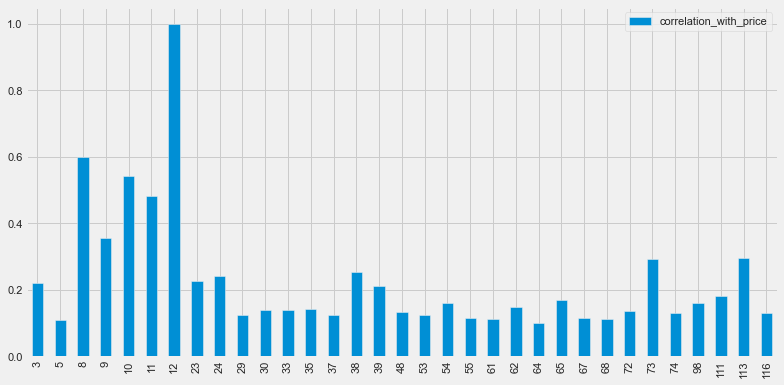

In [164]:
df1.plot( kind='bar', figsize=(12,6));

#Saving it as a variable to apply model to.
df1_col = ['host_total_listings_count', 'host_identity_verified', 'accommodates', 
           'bathrooms', 'bedrooms', 'beds', 'price', 'calculated_host_listings_count', 
           'calculated_host_listings_count_entire_homes', 'amenity_Air_conditioning_', 
           'amenity_Bathtub_', 'amenity_Cable_TV_', 'amenity_Coffee_maker_', 'amenity_Dishes_and_silverware_', 
           'amenity_Dishwasher_', 'amenity_Dryer_', 'amenity_Hair_dryer_', 'amenity_Indoor_fireplace_', 
           'amenity_Iron_', 'amenity_Kitchen_', 'amenity_Microwave_', 'amenity_Oven_', 'amenity_Patio_or_balcony_', 
           'amenity_Private_entrance_', 'amenity_Refrigerator_', 'amenity_Shampoo_', 'amenity_Stove_', 'amenity_TV_', 
           'amenity_Washer_', 'property_type_Entire house', 'property_type_Entire townhouse', 'neighbourhood_cleansed_Westminster',
           'neighbourhood_cleansed_Kensington and Chelsea'
            ]
print(len(df1_col))

# Spearman correlation with price<a class="anchor" id="spearman"></a>

Spearman's corelation measures monotonic associations between two variables i.e. strictly increasing or decreasing

In [165]:
dfs = pd.DataFrame(test_listings.corr(method="spearman")["price"])
dfs.reset_index(inplace=True)
dfs.columns = ["features", "correlation_with_price"]
dfs.sort_values("correlation_with_price", ascending=False)
df2 = dfs[dfs["correlation_with_price"] > 0.1]
corr_features = df2["features"].values
corr_features.tolist().append("price")
print(df2.shape)
df2.sort_values(by=['correlation_with_price'], ascending=False)

(38, 2)


,features,correlation_with_price
12,price,1.000000
8,accommodates,0.650295
24,calculated_host_listings_count_entire_homes,0.605535
10,bedrooms,0.556832
11,beds,0.517900
73,amenity_TV_,0.342114
9,bathrooms,0.311252
113,property_type_Entire house,0.266387
38,amenity_Dishwasher_,0.261341
39,amenity_Dryer_,0.216132


38

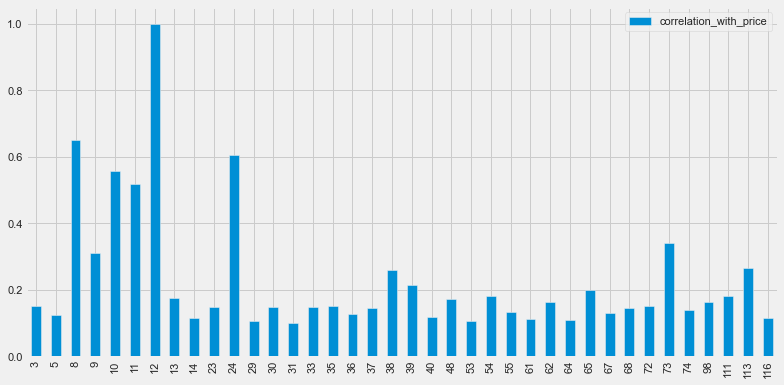

In [166]:
df2.plot( kind='bar', figsize=(12,6));

#Saving it as a variable to apply model on the features selected.
df2_col = ['amenity_Bed_linens_', 'maximum_nights', 'amenity_Elevator_', 'amenity_Cooking_basics_', 
           'minimum_nights','host_total_listings_count', 'host_identity_verified', 'accommodates', 'bathrooms', 
           'bedrooms', 'beds', 'price', 'calculated_host_listings_count', 'calculated_host_listings_count_entire_homes', 
           'amenity_Air_conditioning_', 'amenity_Bathtub_', 'amenity_Cable_TV_', 'amenity_Coffee_maker_', 
           'amenity_Dishes_and_silverware_', 'amenity_Dishwasher_', 'amenity_Dryer_', 'amenity_Hair_dryer_',
           'amenity_Indoor_fireplace_', 'amenity_Iron_', 'amenity_Kitchen_', 'amenity_Microwave_', 'amenity_Oven_', 
           'amenity_Patio_or_balcony_', 'amenity_Private_entrance_', 'amenity_Refrigerator_', 'amenity_Shampoo_', 
           'amenity_Stove_', 'amenity_TV_', 'amenity_Washer_', 'property_type_Entire house', 'property_type_Entire townhouse', 'neighbourhood_cleansed_Westminster',
           'neighbourhood_cleansed_Kensington and Chelsea']
len(df2_col)

# PCA<a class="anchor" id="pca"></a>

Without normalising:

In [167]:
test_listings.columns.tolist()


['host_response_rate',
 'host_acceptance_rate',
 'host_is_superhost',
 'host_total_listings_count',
 'host_has_profile_pic',
 'host_identity_verified',
 'latitude',
 'longitude',
 'accommodates',
 'bathrooms',
 'bedrooms',
 'beds',
 'price',
 'minimum_nights',
 'maximum_nights',
 'availability_30',
 'availability_60',
 'availability_90',
 'availability_365',
 'number_of_reviews',
 'number_of_reviews_ltm',
 'number_of_reviews_l30d',
 'instant_bookable',
 'calculated_host_listings_count',
 'calculated_host_listings_count_entire_homes',
 'calculated_host_listings_count_private_rooms',
 'calculated_host_listings_count_shared_rooms',
 'reviews_per_month',
 'days_host_since',
 'amenity_Air_conditioning_',
 'amenity_Bathtub_',
 'amenity_Bed_linens_',
 'amenity_Breakfast_',
 'amenity_Cable_TV_',
 'amenity_Carbon_monoxide_alarm_',
 'amenity_Coffee_maker_',
 'amenity_Cooking_basics_',
 'amenity_Dishes_and_silverware_',
 'amenity_Dishwasher_',
 'amenity_Dryer_',
 'amenity_Elevator_',
 'amenity_Es

In [162]:
features = test_listings
# Create and fit a PCA model
pca = PCA(n_components=2)

pca.fit(features)

PCA(n_components=2)

In [168]:
# Look at the component loadings. 
print(pca.explained_variance_)
print(pca.explained_variance_ratio_)

[1.69438882e+13 7.16674261e+05]
[9.99999954e-01 4.22969168e-08]


The first component captures 99% of the variance. **What does this mean?**

The second component captures very little. That's a bit suspicous, because it suggests that all the many of the variables are covariant. Let's plot them and look at the loadings.

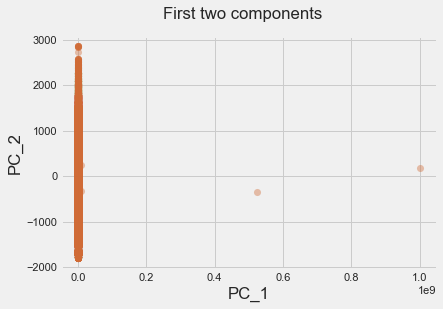

In [169]:
# project the features into these principle components
projectedAxes = pca.transform(features)

plt.figure(1)
plt.suptitle('First two components')
plt.xlabel('PC_1')
plt.ylabel('PC_2')
plt.scatter(projectedAxes[:,0], projectedAxes[:,1], c = "#D06B36", s = 50, alpha = 0.4, linewidth=0)

In [172]:
pd.set_option("display.max_rows", 999)
loadings=pd.DataFrame(pca.components_,columns=test_listings.columns.values[:])
loadings=loadings.transpose()
loadings=loadings.abs()
loadings=loadings.sort_values(by =0,ascending=False)
print(loadings)

                                                            0             1
maximum_nights                                   1.000000e+00  9.582511e-07
days_host_since                                  9.617038e-07  9.998697e-01
availability_365                                 2.854085e-07  1.085890e-02
price                                            7.840613e-08  1.551733e-03
number_of_reviews                                6.095284e-08  6.847417e-03
availability_90                                  5.573319e-08  5.439139e-03
host_acceptance_rate                             3.643734e-08  3.382973e-03
availability_60                                  3.607086e-08  3.584125e-03
host_total_listings_count                        2.346698e-08  3.830933e-03
calculated_host_listings_count                   1.909421e-08  3.317904e-03
calculated_host_listings_count_entire_homes      1.805174e-08  2.794830e-03
availability_30                                  1.703504e-08  1.778598e-03
host_respons

(array([7.5285e+04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        1.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+00]),
 array([1.00000000e+00, 5.00000009e+07, 1.00000001e+08, 1.50000001e+08,
        2.00000001e+08, 2.50000000e+08, 3.00000000e+08, 3.50000000e+08,
        4.00000000e+08, 4.50000000e+08, 5.00000000e+08, 5.50000000e+08,
        6.00000000e+08, 6.50000000e+08, 7.00000000e+08, 7.50000000e+08,
        7.99999999e+08, 8.49999999e+08, 8.99999999e+08, 9.49999999e+08,
        9.99999999e+08]),
 <BarContainer object of 20 artists>)

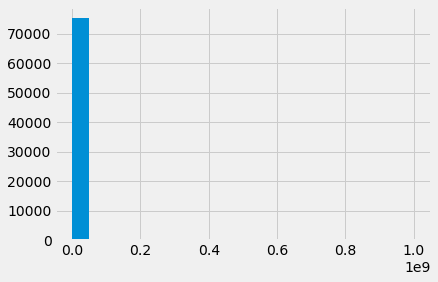

In [58]:
plt.hist(listings['maximum_nights'],bins=20)

(array([1.625e+03, 3.063e+03, 4.624e+03, 4.794e+03, 4.302e+03, 5.760e+03,
        5.836e+03, 7.818e+03, 9.709e+03, 6.784e+03, 6.519e+03, 4.418e+03,
        3.570e+03, 3.566e+03, 1.683e+03, 7.870e+02, 2.890e+02, 9.900e+01,
        3.300e+01, 8.000e+00]),
 array([-182. ,   50.8,  283.6,  516.4,  749.2,  982. , 1214.8, 1447.6,
        1680.4, 1913.2, 2146. , 2378.8, 2611.6, 2844.4, 3077.2, 3310. ,
        3542.8, 3775.6, 4008.4, 4241.2, 4474. ]),
 <BarContainer object of 20 artists>)

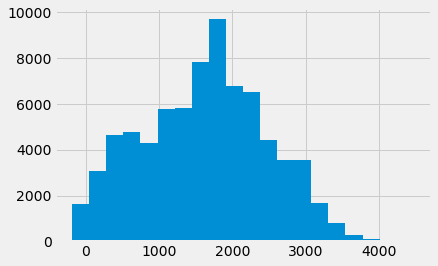

In [59]:
plt.hist(listings['days_host_since'],bins=20)

In [60]:
#Dropped Maximum nights, days_host_since, host_total_listings_count, availability_365, 
#calculated_host_listings_count, calculated_host_listings_count_entire_homes, price



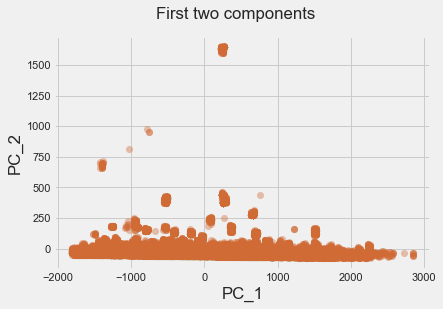

In [173]:
features = test_listings.drop(columns=['maximum_nights'])

# Create and fit a PCA model
pca = PCA(n_components=2)

pca.fit(features)

# project the features into these principle components
projectedAxes = pca.transform(features)

plt.figure(1)
plt.suptitle('First two components')
plt.xlabel('PC_1')
plt.ylabel('PC_2')
plt.scatter(projectedAxes[:,0], projectedAxes[:,1], c = "#D06B36", s = 50, alpha = 0.4, linewidth=0)

In [175]:
pd.set_option("display.max_rows", 999)
loadings=pd.DataFrame(pca.components_,columns=features.columns.values[:])
loadings=loadings.transpose()
loadings=loadings.abs()
loadings=loadings.sort_values(by =0,ascending=False)
print(loadings)

                                                            0             1
days_host_since                                  9.998698e-01  6.968434e-03
availability_365                                 1.085199e-02  9.337453e-02
number_of_reviews                                6.848658e-03  1.423854e-02
availability_90                                  5.437712e-03  2.576778e-02
host_total_listings_count                        3.830278e-03  6.640269e-01
availability_60                                  3.583201e-03  1.559340e-02
host_acceptance_rate                             3.383728e-03  1.210691e-02
calculated_host_listings_count                   3.317367e-03  5.264734e-01
calculated_host_listings_count_entire_homes      2.794325e-03  5.125408e-01
availability_30                                  1.778159e-03  7.204767e-03
price                                            1.549915e-03  9.467792e-02
host_response_rate                               1.489256e-03  7.809639e-03
calculated_h

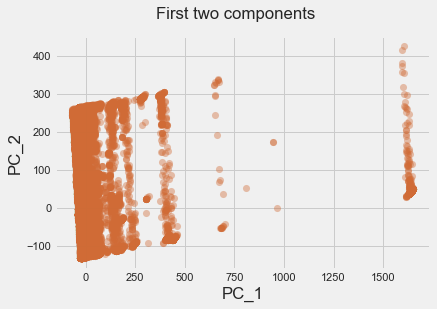

In [177]:
features = test_listings.drop(columns=['maximum_nights', 'days_host_since'])

# Create and fit a PCA model
pca = PCA(n_components=2)

pca.fit(features)

# project the features into these principle components
projectedAxes = pca.transform(features)

plt.figure(1)
plt.suptitle('First two components')
plt.xlabel('PC_1')
plt.ylabel('PC_2')
plt.scatter(projectedAxes[:,0], projectedAxes[:,1], c = "#D06B36", s = 50, alpha = 0.4, linewidth=0)


In [178]:
pd.set_option("display.max_rows", 999)
loadings=pd.DataFrame(pca.components_,columns=features.columns.values[:])
loadings=loadings.transpose()
loadings=loadings.abs()
loadings=loadings.sort_values(by =0,ascending=False)
print(loadings)

                                                            0             1
host_total_listings_count                        6.636717e-01  7.095357e-02
calculated_host_listings_count                   5.262273e-01  5.875556e-02
calculated_host_listings_count_entire_homes      5.122994e-01  3.842670e-02
availability_365                                 9.830413e-02  9.578711e-01
price                                            9.464787e-02  5.687741e-02
availability_90                                  2.734918e-02  2.143987e-01
availability_60                                  1.661868e-02  1.357581e-01
number_of_reviews                                1.319132e-02  2.174212e-02
host_acceptance_rate                             1.159038e-02  7.626088e-03
calculated_host_listings_count_private_rooms     8.725509e-03  1.513378e-02
host_response_rate                               8.054534e-03  5.148012e-03
availability_30                                  7.700646e-03  6.347964e-02
minimum_nigh

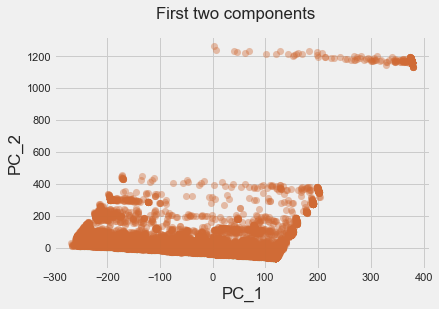

In [179]:
features = test_listings.drop(columns=['maximum_nights', 'days_host_since', 'host_total_listings_count'])

# Create and fit a PCA model
pca = PCA(n_components=2)

pca.fit(features)

# project the features into these principle components
projectedAxes = pca.transform(features)

plt.figure(1)
plt.suptitle('First two components')
plt.xlabel('PC_1')
plt.ylabel('PC_2')
plt.scatter(projectedAxes[:,0], projectedAxes[:,1], c = "#D06B36", s = 50, alpha = 0.4, linewidth=0)

In [ ]:
pd.set_option("display.max_rows", 999)
loadings=pd.DataFrame(pca.components_,columns=features.columns.values[:])
loadings=loadings.transpose()
loadings=loadings.abs()
loadings=loadings.sort_values(by =0,ascending=False)
print(loadings)

Normalising data:

[15.37966688  8.47427144]
[0.09733837 0.05363392]


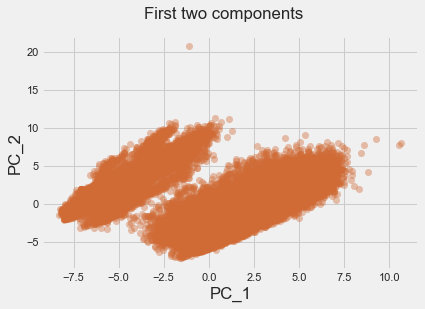

In [183]:
#going to repeat the above but scale the features
features = test_listings

features=preprocessing.scale(features)

# Create and fit a PCA model
pca = PCA(n_components=2)

pca.fit(features)

# Look at the component loadings. 
print(pca.explained_variance_)
print(pca.explained_variance_ratio_)

# project the features into these principle components
projectedAxes = pca.transform(features)

plt.figure(1)
plt.suptitle('First two components')
plt.xlabel('PC_1')
plt.ylabel('PC_2')
plt.scatter(projectedAxes[:,0], projectedAxes[:,1], c = "#D06B36", s = 50, alpha = 0.4, linewidth=0)


In [184]:
loadings=pd.DataFrame(pca.components_,columns=test_listings.columns.values[:])
loadings=loadings.transpose()
loadings=loadings.abs()
loadings=loadings.sort_values(by =0,ascending=False)
print(loadings)

                                                        0         1
review_scores_checkin_no reviews                 0.221569  0.146125
review_scores_location_no reviews                0.221555  0.146183
review_scores_value_no reviews                   0.221528  0.146184
review_scores_accuracy_no reviews                0.221520  0.146535
review_scores_communication_no reviews           0.221484  0.146630
review_scores_cleanliness_no reviews             0.221482  0.146603
review_scores_rating_no reviews                  0.221291  0.146796
days_since_first_review_no reviews               0.195814  0.148660
review_scores_communication_10/10                0.181837  0.133596
review_scores_checkin_10/10                      0.176293  0.130563
review_scores_accuracy_10/10                     0.164306  0.121674
amenity_Refrigerator_                            0.157748  0.185247
amenity_Dishes_and_silverware_                   0.156685  0.176209
review_scores_location_10/10                    

In [185]:
loadings=pd.DataFrame(pca.components_,columns=test_listings.columns.values[:])
loadings=loadings.transpose()
loadings=loadings.abs()
loadings=loadings.sort_values(by =1,ascending=False)
print(loadings)

                                                        0         1
amenity_Oven_                                    0.146343  0.190742
amenity_Refrigerator_                            0.157748  0.185247
amenity_Stove_                                   0.140793  0.183534
amenity_Microwave_                               0.133549  0.179429
amenity_Dishes_and_silverware_                   0.156685  0.176209
amenity_Cooking_basics_                          0.150906  0.169662
days_since_last_review_no reviews                0.134352  0.167389
days_since_last_review_1+ year                   0.025614  0.167054
amenity_Dishwasher_                              0.108804  0.166826
amenity_Bed_linens_                              0.125594  0.162048
days_since_first_review_no reviews               0.195814  0.148660
review_scores_rating_no reviews                  0.221291  0.146796
review_scores_communication_no reviews           0.221484  0.146630
review_scores_cleanliness_no reviews            

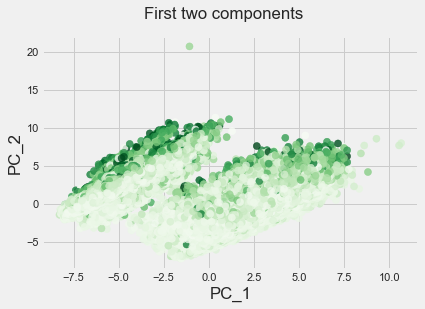

In [186]:
plt.figure(1)
plt.suptitle('First two components')
plt.xlabel('PC_1')
plt.ylabel('PC_2')
plt.scatter(projectedAxes[:,0], projectedAxes[:,1], c = listings['price'], cmap = plt.cm.Greens, s = 50, alpha = 0.8)

(75286, 157)
158


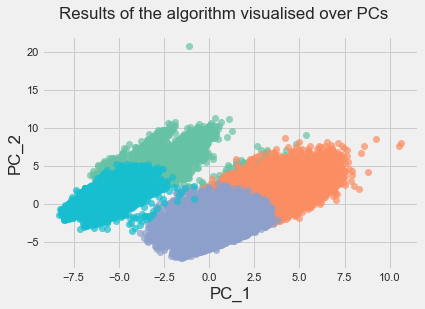

In [191]:
features = test_listings.iloc[:,1:]
knownLabels=test_listings.iloc[0,:]

features=preprocessing.scale(features)

print(features.shape)
print(len(knownLabels))

#computing K-Means with K = 3 (3 clusters)
kmeansModel = KMeans(init='random', n_clusters=4, n_init=10)
kmeansModel.fit_predict(features)
clusterLabels = kmeansModel.labels_

pca = PCA(n_components=2)

# We first fit a PCA model to the data
pca.fit(features)

# have a look at the components directly if we can notice any interesting structure
projectedAxes = pca.transform(features)
projectedAxes=pd.DataFrame(projectedAxes) #put into a dataframe so easier to filter

plt.figure(1)
plt.suptitle('Results of the algorithm visualised over PCs')
plt.xlabel('PC_1')
plt.ylabel('PC_2')
#draw 3 scatterplots on top of each other, using a different colour for each
plt.scatter(projectedAxes[clusterLabels==0][0], projectedAxes[clusterLabels==0][1], c = "#66c2a5", s = 50, alpha = 0.7, linewidth=0) # greenish
plt.scatter(projectedAxes[clusterLabels==1][0], projectedAxes[clusterLabels==1][1], c = "#fc8d62", s = 50, alpha = 0.7, linewidth=0) # orangish
plt.scatter(projectedAxes[clusterLabels==2][0], projectedAxes[clusterLabels==2][1], c = "#8da0cb", s = 50, alpha = 0.7, linewidth=0) # blueish
plt.scatter(projectedAxes[clusterLabels==3][0], projectedAxes[clusterLabels==3][1], c = "#17becf", s = 50, alpha = 0.7, linewidth=0) # blueish
#plt.scatter(projectedAxes[clusterLabels==4][0], projectedAxes[clusterLabels==4][1], c = "#bcbd22", s = 50, alpha = 0.7, linewidth=0) # blueish
#plt.scatter(projectedAxes[clusterLabels==5][0], projectedAxes[clusterLabels==5][1], c = "#7f7f7f", s = 50, alpha = 0.7, linewidth=0) # blueish
#plt.scatter(projectedAxes[clusterLabels==6][0], projectedAxes[clusterLabels==6][1], c = "#e377c2", s = 50, alpha = 0.7, linewidth=0) # blueish
plt.show()


#'#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf'

In [192]:
for i, clustLabel in enumerate(clusterLabels):
    print("Cluster result: ", clustLabel, " Known labels: ",knownLabels[i])

Cluster result:  1  Known labels:  100.0
Cluster result:  1  Known labels:  100.0
Cluster result:  1  Known labels:  0.0
Cluster result:  1  Known labels:  3.0
Cluster result:  3  Known labels:  1.0
Cluster result:  2  Known labels:  1.0
Cluster result:  2  Known labels:  51.46225
Cluster result:  1  Known labels:  -0.11732
Cluster result:  1  Known labels:  4.0
Cluster result:  2  Known labels:  1.0
Cluster result:  2  Known labels:  1.0
Cluster result:  3  Known labels:  3.0
Cluster result:  1  Known labels:  97.0
Cluster result:  1  Known labels:  7.0
Cluster result:  1  Known labels:  190.0
Cluster result:  3  Known labels:  0.0
Cluster result:  1  Known labels:  0.0
Cluster result:  1  Known labels:  4.0
Cluster result:  0  Known labels:  279.0
Cluster result:  2  Known labels:  192.0
Cluster result:  1  Known labels:  7.0
Cluster result:  1  Known labels:  0.0
Cluster result:  2  Known labels:  1.0
Cluster result:  1  Known labels:  2.0
Cluster result:  3  Known labels:  2.0
Clus

IndexError: index 158 is out of bounds for axis 0 with size 158

# Using Panda's corr() method calculates the relationship between each feature in relation to price 

It uses Pearson's correlation by default

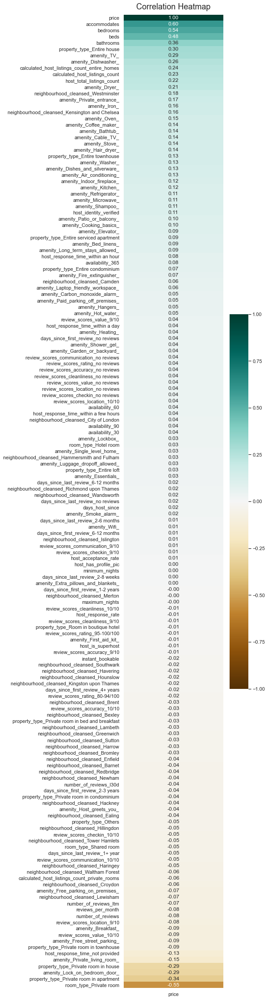

In [45]:
plt.figure(figsize=(5, 40))
feature_correlation = test_listings.corr()[['price']].sort_values(by='price', ascending=False)
# feature_correlation = feature_correlation[(feature_correlation > 0.1) & (feature_correlation != 1)]
# Show all features.
# heatmap = sns.heatmap(feature_correlation, vmin=-1, vmax=1, annot=True, fmt=".2f", cmap='BrBG')

# Show only price feature
heatmap = sns.heatmap(feature_correlation, vmin=-1, vmax=1, annot=True, fmt=".2f", cmap='BrBG')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=12);

# Multicollinearity analysis

Text(0.5, 1.0, 'Correlation Heatmap')

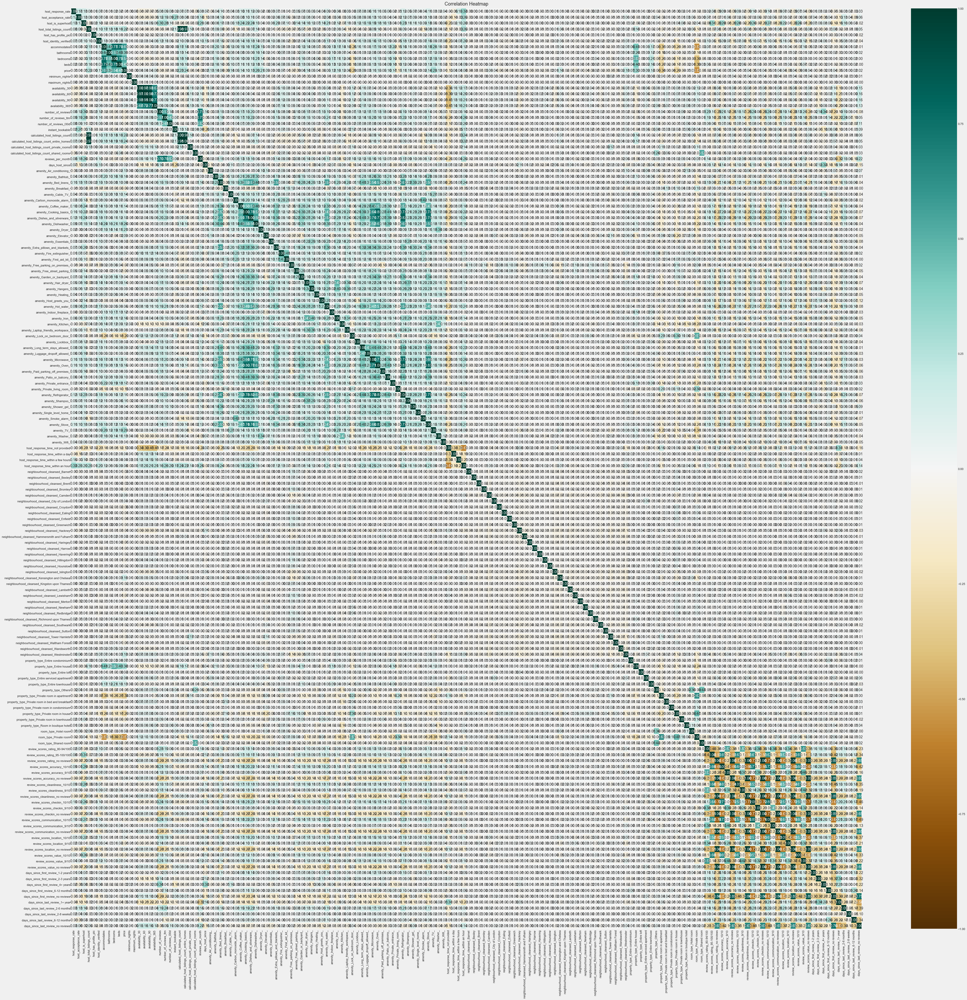

In [196]:
plt.figure(figsize=(60, 60))
feature_correlation = test_listings.corr()

# plt.figure(figsize=(5, 30))
# feature_correlation = listings.corr()[['price']].sort_values(by='price', ascending=False)

#mask = (feature_correlation > 0.15) & (feature_correlation < 0.95) & (feature_correlation != 1)
# feature_correlation = feature_correlation[mask]

# Show all features.
# heatmap = sns.heatmap(feature_correlation, vmin=-1, vmax=1, annot=True, fmt=".2f", cmap='BrBG')

# Show only price feature
heatmap = sns.heatmap(feature_correlation, vmin=-1, vmax=1, annot=True, fmt=".2f", cmap='BrBG')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=12)

It doesn't look like there are any significant collinear relationships with boroughs, so these will temporarily be dropped to produce a clearer heatmap for the remaining features:



In [42]:
review_cols = test_listings.columns[test_listings.columns.str.startswith("neighbourhood")]
transformed_df = test_listings.drop(review_cols, axis=1)

Text(0.5, 1.0, 'Correlation Heatmap')

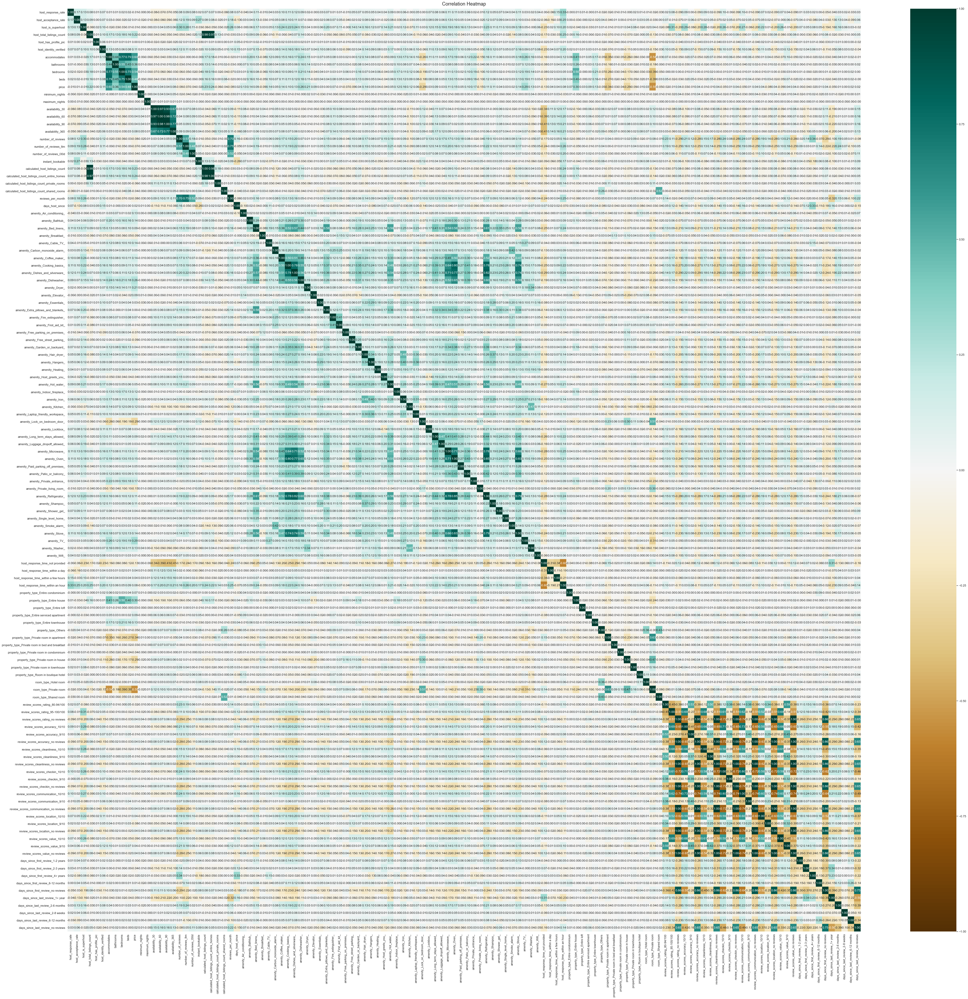

In [230]:
plt.figure(figsize=(60, 60))
feature_correlation = transformed_df.corr()

# Show only price feature
heatmap = sns.heatmap(feature_correlation, vmin=-1, vmax=1, annot=True, fmt=".2f", cmap='BrBG')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=12)

Areas of multi-collinearity:

- Accommodates is highly correlated to bedrooms and beds

- Unsurprisingly, there are perfect correlations between no reviews (i.e. listings that are not reviewed yet) for different review categories, and first and last review times. No reviews categories can therefore be dropped.

- There is a strong correlation between property_type_private room in apartment and room_type_private room. One of them will be dropped.

- Host_total_listings_count is highly correlated to calculated_host_listings_count and calculated_host_listings_count_entire_homes. We will keep host_total_listings_count and drop the rest.

- Reviews_per_month is also highly correlated to number_of_reviews and number_of_reviews_ltm. These will also be dropped.

- There is a negative correlation between host_response_time_not_provided and host_response_time_within an hour. One of these (rate) will be dropped.




In [ ]:
#There are strong negative correlations between houses and apartments, and between private rooms and entire homes (as these were the main two categories of their features before they were one-hot encoded). Although these are important categories, one of each will be dropped in order to reduce multi-collinearity (apartments and private rooms, as these are the second most common categories).

In [43]:
to_drop = ['beds',
           'bedrooms',
           'room_type_Private room',
           'calculated_host_listings_count', 
           'calculated_host_listings_count_entire_homes',
           'host_response_time_not provided',
           'number_of_reviews',
           'number_of_reviews_ltm',
          ]

no_review_col = test_listings.columns[test_listings.columns.str.endswith("no reviews")]

mul_col_final = test_listings.drop(to_drop, axis=1)
mul_col_final = mul_col_final.drop(no_review_col, axis=1)

In [236]:
mul_col_final.head(1).T

,0
host_response_rate,100.00
host_acceptance_rate,100.00
host_is_superhost,0.00
host_total_listings_count,3.00
host_has_profile_pic,1.00
host_identity_verified,1.00
accommodates,4.00
bathrooms,1.00
price,97.00
minimum_nights,7.00


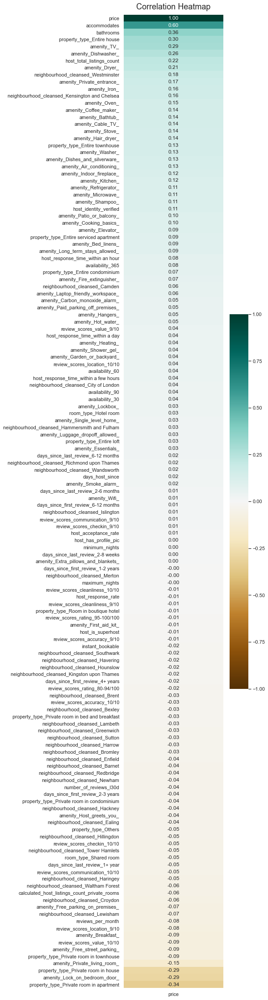

In [44]:
plt.figure(figsize=(5, 40))
feature_correlation = mul_col_final.corr()[['price']].sort_values(by='price', ascending=False)

# Show only price feature
heatmap = sns.heatmap(feature_correlation, vmin=-1, vmax=1, annot=True, fmt=".2f", cmap='BrBG')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=12);

In [46]:
#Selecting only features that has feature_correlation_price > 0.10
feature_correlation_price = abs(feature_correlation['price'])
mask = (feature_correlation_price > 0.10) & (feature_correlation_price < 0.95) & (feature_correlation_price != 1)

# Columns to keep
columns_to_keep = list(feature_correlation_price[mask].index)

print(len(columns_to_keep))
columns_to_keep


38


['accommodates',
 'bedrooms',
 'beds',
 'bathrooms',
 'property_type_Entire house',
 'amenity_TV_',
 'amenity_Dishwasher_',
 'calculated_host_listings_count_entire_homes',
 'calculated_host_listings_count',
 'host_total_listings_count',
 'amenity_Dryer_',
 'neighbourhood_cleansed_Westminster',
 'amenity_Private_entrance_',
 'amenity_Iron_',
 'neighbourhood_cleansed_Kensington and Chelsea',
 'amenity_Oven_',
 'amenity_Coffee_maker_',
 'amenity_Bathtub_',
 'amenity_Cable_TV_',
 'amenity_Stove_',
 'amenity_Hair_dryer_',
 'property_type_Entire townhouse',
 'amenity_Washer_',
 'amenity_Dishes_and_silverware_',
 'amenity_Air_conditioning_',
 'amenity_Indoor_fireplace_',
 'amenity_Kitchen_',
 'amenity_Refrigerator_',
 'amenity_Microwave_',
 'amenity_Shampoo_',
 'host_identity_verified',
 'amenity_Patio_or_balcony_',
 'host_response_time_not provided',
 'amenity_Private_living_room_',
 'property_type_Private room in house',
 'amenity_Lock_on_bedroom_door_',
 'property_type_Private room in apar

Text(0.5, 1.0, 'Correlation Heatmap')

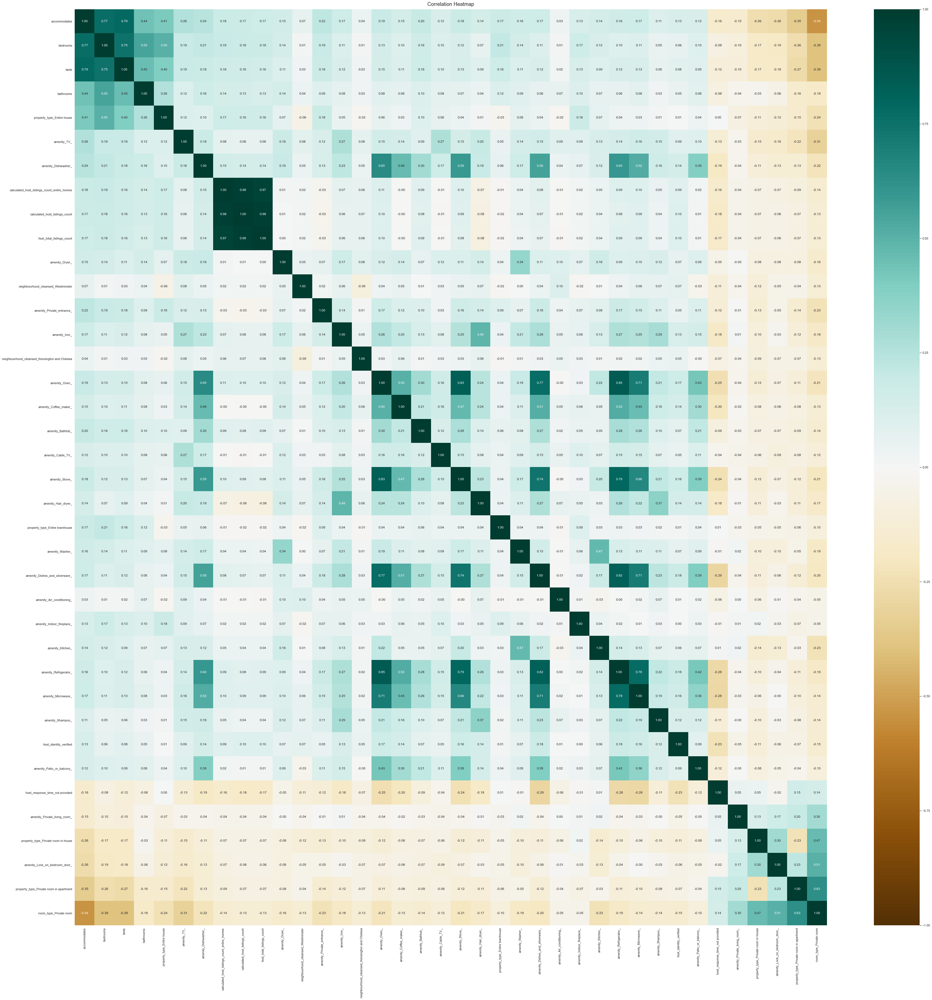

In [47]:
transformed_df =test_listings[columns_to_keep]

plt.figure(figsize=(60, 60))
feature_correlation = transformed_df.corr()

# Show only price feature
heatmap = sns.heatmap(feature_correlation, vmin=-1, vmax=1, annot=True, fmt=".2f", cmap='BrBG')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=12)

# Variance Inflation Factors (VIFs)

They are a great way to check for multicollinearity in your model. Multicollinearity is when there is high correlation between your features. It is an assumption of linear regression that your data does not have multicollinearity, so make sure to check this. You want your VIFs under 4.

In [48]:
final_listings = test_listings[columns_to_keep]

# Improve performance of ML algorithm due to smaller values. ML algorithms see larger numbers as more impactful.
final_listings_scaled = MinMaxScaler().fit_transform(final_listings)
final_listings_scaled_df = pd.DataFrame(final_listings_scaled, columns=final_listings.columns)
final_listings_scaled_df.head()

# Visualize cleaned dataset
final_listings_corr = final_listings_scaled_df.corr()

# For each X, calculate VIF and save in dataframe
vif = pd.DataFrame()
vif["VIF"] = [variance_inflation_factor(final_listings_corr.values, i) for i in range(final_listings_corr.shape[1])]
vif["features"] = final_listings_corr.columns
vif = vif.round(1)

pd.set_option('max_rows', None)
display(vif.sort_values('VIF', ascending=False))

,VIF,features
8,10355.2,calculated_host_listings_count
7,6165.6,calculated_host_listings_count_entire_homes
9,2694.4,host_total_listings_count
37,221.5,room_type_Private room
27,214.9,amenity_Refrigerator_
15,194.3,amenity_Oven_
19,85.8,amenity_Stove_
36,84.5,property_type_Private room in apartment
0,81.5,accommodates
23,76.1,amenity_Dishes_and_silverware_


In [49]:
#dropping features that are multicolinear
final_listings_mc_masked = final_listings.drop(['room_type_Private room', 'calculated_host_listings_count', 
                                                 'calculated_host_listings_count_entire_homes',], axis=1)
final_listings_mc_masked.shape

(75286, 35)

In [50]:
final_listings_mc = mul_col_final

# Improve performance of ML algorithm due to smaller values. ML algorithms see larger numbers as more impactful.
final_listings_scaled = MinMaxScaler().fit_transform(final_listings_mc)
final_listings_scaled_df = pd.DataFrame(final_listings_scaled, columns=final_listings_mc.columns)
final_listings_scaled_df.head()

# Visualize cleaned dataset
final_listings_corr = final_listings_scaled_df.corr()

# For each X, calculate VIF and save in dataframe
vif = pd.DataFrame()
vif["VIF"] = [variance_inflation_factor(final_listings_corr.values, i) for i in range(final_listings_corr.shape[1])]
vif["features"] = final_listings_corr.columns
vif = vif.round(1)

pd.set_option('max_rows', None)
display(vif.sort_values('VIF', ascending=False))

,VIF,features
12,32005.0,availability_60
13,14987.7,availability_90
11,4927.3,availability_30
101,4652.6,neighbourhood_cleansed_Westminster
98,3412.4,neighbourhood_cleansed_Tower Hamlets
80,2887.2,neighbourhood_cleansed_Hackney
88,2676.6,neighbourhood_cleansed_Kensington and Chelsea
74,2518.2,neighbourhood_cleansed_Camden
87,2145.3,neighbourhood_cleansed_Islington
90,2045.5,neighbourhood_cleansed_Lambeth


In [51]:
# we will drop availability_60 and 90
final_listings_mc = mul_col_final.drop(['availability_60', 'availability_90'], axis=1)
final_listings_mc.shape

(75286, 136)

# Modeling<a class="anchor" id="modeling"></a>

# Baseline: Linear Regression without any feature selection or multicollinearity analysis

In [52]:
#version 3
sc = MinMaxScaler()
X = test_listings.drop('price', axis=1)
y = listings['price']

X = sc.fit_transform(X)

#Splitting the data into train and test split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

#Score using your model
test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )



        R2 for test data: 0.5671849134725203
        R2 for train data: 0.5664269323626221
        
        RMSE for test data: 44.174359218887105
        RMSE for train data: 43.615284301477296
        
        Mean Absolute Error for test data: 29.37075067282831
        Mean Absolute Error for train data: 28.916857722155996
    


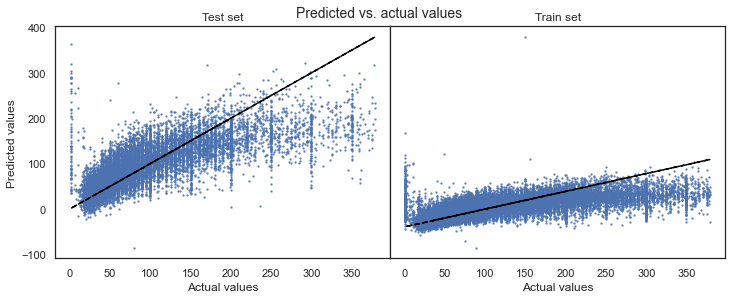

In [53]:
# Scatterplot of predicted vs. actual values
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
fig.suptitle('Predicted vs. actual values', fontsize=14, y=1)
plt.subplots_adjust(top=0.93, wspace=0)
    
ax1.scatter(y_test, y_test_preds, s=2, alpha=0.7)
ax1.plot(y_test, y_test, color='black', linestyle='--')
ax1.set_title('Test set')
ax1.set_xlabel('Actual values')
ax1.set_ylabel('Predicted values')
    
ax2.scatter(y_train, y_train_preds, s=2, alpha=0.7)
ax2.plot(y_test, y_test, color='black', linestyle='--')
ax2.set_title('Train set')
ax2.set_xlabel('Actual values')
ax2.set_ylabel('')
ax2.set_yticklabels(labels='')
    
plt.show()

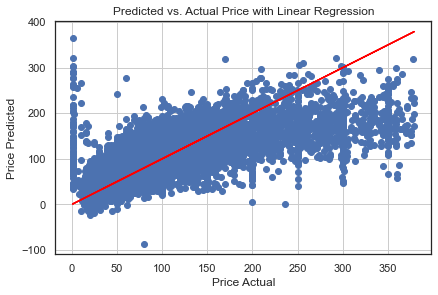

In [254]:
# Plot
plt.scatter(y_test, y_test_preds)
plt.plot(y_test, y_test,color='red')
plt.grid(True)
plt.title('Predicted vs. Actual Price with Linear Regression')
plt.ylabel('Price Predicted')
plt.xlabel('Price Actual');

In [54]:
#corr() < 0.1
sc = MinMaxScaler()
X = final_listings
y = listings['price']

X = sc.fit_transform(X)

#Splitting the data into train and test split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

#Score using your model
test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )



        R2 for test data: 0.523309354631222
        R2 for train data: 0.5215021025231572
        
        RMSE for test data: 46.359354247442376
        RMSE for train data: 45.81920779338698
        
        Mean Absolute Error for test data: 30.932752927514343
        Mean Absolute Error for train data: 30.557982066456333
    


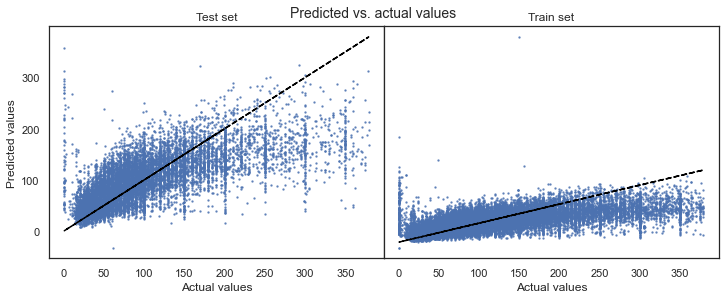

In [55]:
# Scatterplot of predicted vs. actual values
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
fig.suptitle('Predicted vs. actual values', fontsize=14, y=1)
plt.subplots_adjust(top=0.93, wspace=0)
    
ax1.scatter(y_test, y_test_preds, s=2, alpha=0.7)
ax1.plot(y_test, y_test, color='black', linestyle='--')
ax1.set_title('Test set')
ax1.set_xlabel('Actual values')
ax1.set_ylabel('Predicted values')
    
ax2.scatter(y_train, y_train_preds, s=2, alpha=0.7)
ax2.plot(y_test, y_test, color='black', linestyle='--')
ax2.set_title('Train set')
ax2.set_xlabel('Actual values')
ax2.set_ylabel('')
ax2.set_yticklabels(labels='')
    
plt.show()

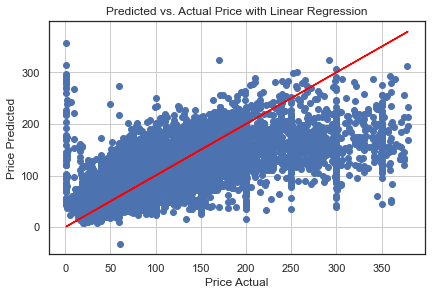

In [256]:
# Plot
plt.scatter(y_test, y_test_preds)
plt.plot(y_test, y_test,color='red')
plt.grid(True)
plt.title('Predicted vs. Actual Price with Linear Regression')
plt.ylabel('Price Predicted')
plt.xlabel('Price Actual');

In [257]:
# corr()> 0.1 plus remove multicolinearity
sc = MinMaxScaler()
X = final_listings_mc_masked
y = listings['price']

X = sc.fit_transform(X)

#Splitting the data into train and test split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

#Score using your model
test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )



        R2 for test data: 0.511780237413556
        R2 for train data: 0.5090958200184356
        
        RMSE for test data: 46.91662259388733
        RMSE for train data: 46.4093968418662
        
        Mean Absolute Error for test data: 31.579485700292516
        Mean Absolute Error for train data: 31.224851924895056
    


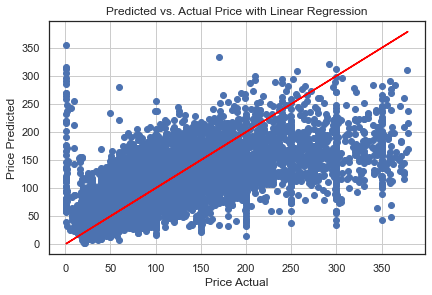

In [258]:
# Plot
plt.scatter(y_test, y_test_preds)
plt.plot(y_test, y_test,color='red')
plt.grid(True)
plt.title('Predicted vs. Actual Price with Linear Regression')
plt.ylabel('Price Predicted')
plt.xlabel('Price Actual');

Removing the highly correlated features from the 38 features made the prediction less accurate than before.

In [251]:
# manual remove multicolinearity
sc = MinMaxScaler()
X = final_listings_mc.drop('price', axis=1)
y = listings['price']

X = sc.fit_transform(X)

#Splitting the data into train and test split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

#Score using your model
test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )



        R2 for test data: 0.5545610266673637
        R2 for train data: 0.5549384502421109
        
        RMSE for test data: 44.81394425007501
        RMSE for train data: 44.18934833841243
        
        Mean Absolute Error for test data: 29.884236631091365
        Mean Absolute Error for train data: 29.489570575848838
    


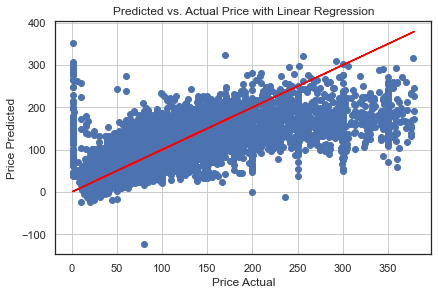

In [252]:
# Plot
plt.scatter(y_test, y_test_preds)
plt.plot(y_test, y_test,color='red')
plt.grid(True)
plt.title('Predicted vs. Actual Price with Linear Regression')
plt.ylabel('Price Predicted')
plt.xlabel('Price Actual');

# XGBoost

In [56]:
# corr() > 0.10
X = final_listings
y = listings['price']

# Scaling
scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

# Splitting into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

In [57]:
import xgboost
from xgboost import plot_importance

#Instantiate
xgb_model = xgboost.XGBRegressor()
#Fit
xgb_model.fit(X_train, y_train)
#Predict
training_preds_xgb_reg = xgb_model.predict(X_train)
test_preds_xgb_reg = xgb_model.predict(X_test)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(r2_score(y_test, test_preds_xgb_reg), 
               r2_score(y_train, training_preds_xgb_reg),
               mean_squared_error(y_test, test_preds_xgb_reg) ** (1/2),
               mean_squared_error(y_train, training_preds_xgb_reg) ** (1/2),
               mean_absolute_error(y_test, test_preds_xgb_reg),
               mean_absolute_error(y_train, training_preds_xgb_reg)
               )
     )


        R2 for test data: 0.606702069223013
        R2 for train data: 0.686573222542437
        
        RMSE for test data: 41.58895726044334
        RMSE for train data: 37.20003957133072
        
        Mean Absolute Error for test data: 27.343676769570344
        Mean Absolute Error for train data: 24.90704405259277
    


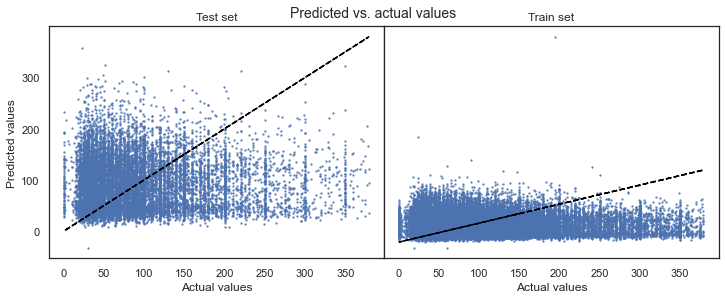

In [58]:
# Scatterplot of predicted vs. actual values
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
fig.suptitle('Predicted vs. actual values', fontsize=14, y=1)
plt.subplots_adjust(top=0.93, wspace=0)
    
ax1.scatter(y_test, y_test_preds, s=2, alpha=0.7)
ax1.plot(y_test, y_test, color='black', linestyle='--')
ax1.set_title('Test set')
ax1.set_xlabel('Actual values')
ax1.set_ylabel('Predicted values')
    
ax2.scatter(y_train, y_train_preds, s=2, alpha=0.7)
ax2.plot(y_test, y_test, color='black', linestyle='--')
ax2.set_title('Train set')
ax2.set_xlabel('Actual values')
ax2.set_ylabel('')
ax2.set_yticklabels(labels='')
    
plt.show()

In [264]:
# corr()> 0.1 plus remove multicolinearity
X = final_listings_mc_masked
y = listings['price']

# Scaling
scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

# Splitting into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

#Instantiate
xgb_model = xgboost.XGBRegressor()
#Fit
xgb_model.fit(X_train, y_train)
#Predict
training_preds_xgb_reg = xgb_model.predict(X_train)
test_preds_xgb_reg = xgb_model.predict(X_test)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(r2_score(y_test, test_preds_xgb_reg), 
               r2_score(y_train, training_preds_xgb_reg),
               mean_squared_error(y_test, test_preds_xgb_reg) ** (1/2),
               mean_squared_error(y_train, training_preds_xgb_reg) ** (1/2),
               mean_absolute_error(y_test, test_preds_xgb_reg),
               mean_absolute_error(y_train, training_preds_xgb_reg)
               )
     )


        R2 for test data: 0.5921348664437247
        R2 for train data: 0.6688275645939563
        
        RMSE for test data: 42.35215286254361
        RMSE for train data: 38.2386405584049
        
        Mean Absolute Error for test data: 28.049821914469426
        Mean Absolute Error for train data: 25.822729048914372
    


In [59]:
# manual remove multicolinearity
X = final_listings_mc.drop('price', axis=1)
y = listings['price']

# Scaling
scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

# Splitting into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

#Instantiate
xgb_model = xgboost.XGBRegressor()
#Fit
xgb_model.fit(X_train, y_train)
#Predict
training_preds_xgb_reg = xgb_model.predict(X_train)
test_preds_xgb_reg = xgb_model.predict(X_test)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(r2_score(y_test, test_preds_xgb_reg), 
               r2_score(y_train, training_preds_xgb_reg),
               mean_squared_error(y_test, test_preds_xgb_reg) ** (1/2),
               mean_squared_error(y_train, training_preds_xgb_reg) ** (1/2),
               mean_absolute_error(y_test, test_preds_xgb_reg),
               mean_absolute_error(y_train, training_preds_xgb_reg)
               )
     )


        R2 for test data: 0.64737751286537
        R2 for train data: 0.7456330071137034
        
        RMSE for test data: 39.37968184203353
        RMSE for train data: 33.51241543071903
        
        Mean Absolute Error for test data: 25.882749651241905
        Mean Absolute Error for train data: 22.360046493907006
    


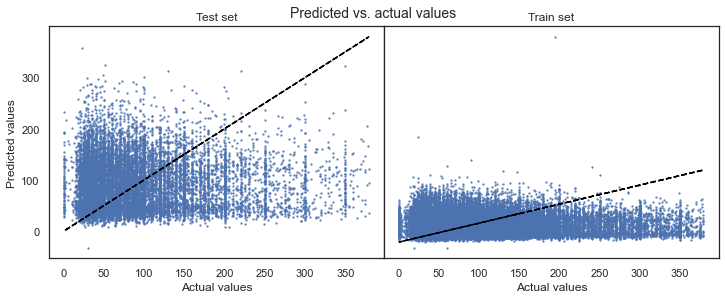

In [60]:
# Scatterplot of predicted vs. actual values
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
fig.suptitle('Predicted vs. actual values', fontsize=14, y=1)
plt.subplots_adjust(top=0.93, wspace=0)
    
ax1.scatter(y_test, y_test_preds, s=2, alpha=0.7)
ax1.plot(y_test, y_test, color='black', linestyle='--')
ax1.set_title('Test set')
ax1.set_xlabel('Actual values')
ax1.set_ylabel('Predicted values')
    
ax2.scatter(y_train, y_train_preds, s=2, alpha=0.7)
ax2.plot(y_test, y_test, color='black', linestyle='--')
ax2.set_title('Train set')
ax2.set_xlabel('Actual values')
ax2.set_ylabel('')
ax2.set_yticklabels(labels='')
    
plt.show()

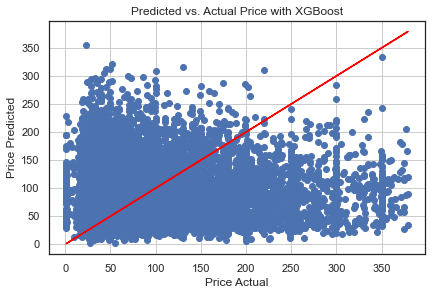

In [268]:
# Plot
plt.scatter(y_test, y_test_preds)
plt.plot(y_test, y_test,color='red')
plt.grid(True)
plt.title('Predicted vs. Actual Price with XGBoost')
plt.ylabel('Price Predicted')
plt.xlabel('Price Actual');

In [61]:
# #using parameters given from GridSearch
X = final_listings_mc.drop('price', axis=1)
y = listings['price']

# Scaling
scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

# Splitting into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

#Instantiate
xgb_model = xgboost.XGBRegressor(colsample_bytree=0.6, gamma=0.0, learning_rate=0.1, max_depth=7, n_estimators=200)
#Fit
xgb_model.fit(X_train, y_train)
#Predict
training_preds_xgb_reg = xgb_model.predict(X_train)
test_preds_xgb_reg = xgb_model.predict(X_test)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(r2_score(y_test, test_preds_xgb_reg), 
               r2_score(y_train, training_preds_xgb_reg),
               mean_squared_error(y_test, test_preds_xgb_reg) ** (1/2),
               mean_squared_error(y_train, training_preds_xgb_reg) ** (1/2),
               mean_absolute_error(y_test, test_preds_xgb_reg),
               mean_absolute_error(y_train, training_preds_xgb_reg)
               )
     )


        R2 for test data: 0.6598518481818989
        R2 for train data: 0.7570438069908901
        
        RMSE for test data: 38.67686447584763
        RMSE for train data: 32.75211423184762
        
        Mean Absolute Error for test data: 25.386821700014874
        Mean Absolute Error for train data: 21.701506731294042
    


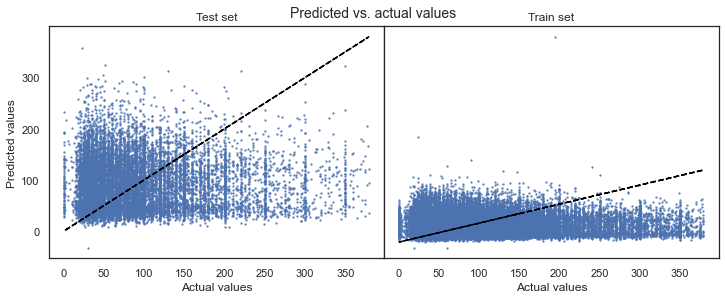

In [62]:
# Scatterplot of predicted vs. actual values
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
fig.suptitle('Predicted vs. actual values', fontsize=14, y=1)
plt.subplots_adjust(top=0.93, wspace=0)
    
ax1.scatter(y_test, y_test_preds, s=2, alpha=0.7)
ax1.plot(y_test, y_test, color='black', linestyle='--')
ax1.set_title('Test set')
ax1.set_xlabel('Actual values')
ax1.set_ylabel('Predicted values')
    
ax2.scatter(y_train, y_train_preds, s=2, alpha=0.7)
ax2.plot(y_test, y_test, color='black', linestyle='--')
ax2.set_title('Train set')
ax2.set_xlabel('Actual values')
ax2.set_ylabel('')
ax2.set_yticklabels(labels='')
    
plt.show()

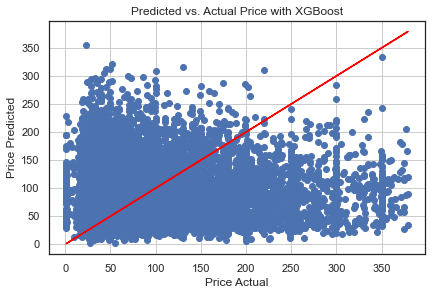

In [270]:
# Plot
plt.scatter(y_test, y_test_preds)
plt.plot(y_test, y_test,color='red')
plt.grid(True)
plt.title('Predicted vs. Actual Price with XGBoost')
plt.ylabel('Price Predicted')
plt.xlabel('Price Actual');

In [271]:
#using parameters given from RandomSearch
X = final_listings_mc.drop('price', axis=1)
y = listings['price']

# Scaling
scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

# Splitting into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

#Instantiate
xgb_model = xgboost.XGBRegressor(colsample_bytree=0.7, gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=150)
#Fit
xgb_model.fit(X_train, y_train)
#Predict
training_preds_xgb_reg = xgb_model.predict(X_train)
test_preds_xgb_reg = xgb_model.predict(X_test)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(r2_score(y_test, test_preds_xgb_reg), 
               r2_score(y_train, training_preds_xgb_reg),
               mean_squared_error(y_test, test_preds_xgb_reg) ** (1/2),
               mean_squared_error(y_train, training_preds_xgb_reg) ** (1/2),
               mean_absolute_error(y_test, test_preds_xgb_reg),
               mean_absolute_error(y_train, training_preds_xgb_reg)
               )
     )




        R2 for test data: 0.6437484880203319
        R2 for train data: 0.6997904168578643
        
        RMSE for test data: 39.581801727647004
        RMSE for train data: 36.4072292830325
        
        Mean Absolute Error for test data: 26.088089408065745
        Mean Absolute Error for train data: 24.020261943123074
    


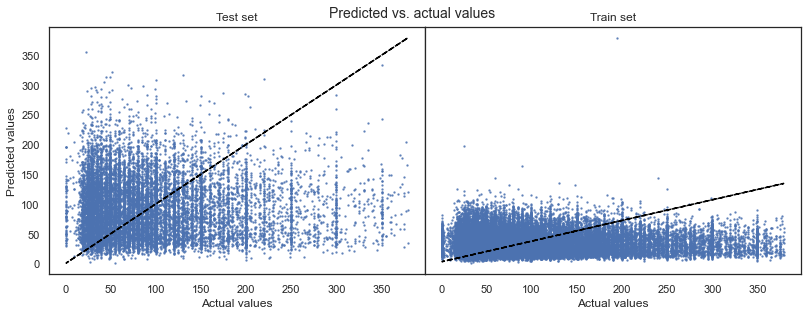

In [272]:
# Scatterplot of predicted vs. actual values
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
fig.suptitle('Predicted vs. actual values', fontsize=14, y=1)
plt.subplots_adjust(top=0.93, wspace=0)
    
ax1.scatter(y_test, y_test_preds, s=2, alpha=0.7)
ax1.plot(y_test, y_test, color='black', linestyle='--')
ax1.set_title('Test set')
ax1.set_xlabel('Actual values')
ax1.set_ylabel('Predicted values')
    
ax2.scatter(y_train, y_train_preds, s=2, alpha=0.7)
ax2.plot(y_test, y_test, color='black', linestyle='--')
ax2.set_title('Train set')
ax2.set_xlabel('Actual values')
ax2.set_ylabel('')
ax2.set_yticklabels(labels='')
    
plt.show()

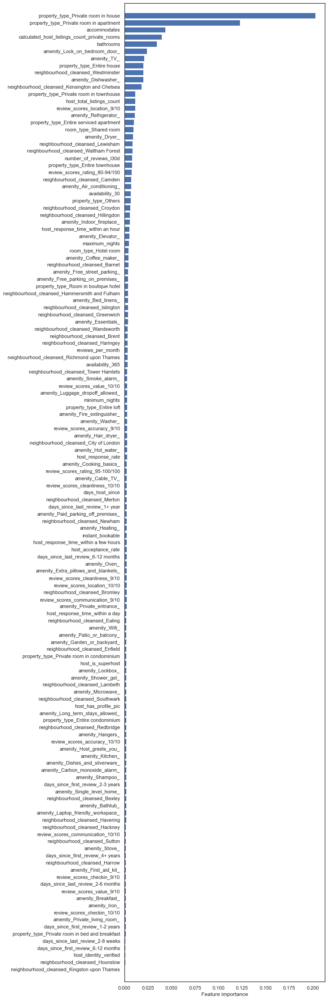

,weight
property_type_Private room in house,0.202666
property_type_Private room in apartment,0.122758
accommodates,0.043587
calculated_host_listings_count_private_rooms,0.039593
bathrooms,0.034700
amenity_Lock_on_bedroom_door_,0.024030
amenity_TV_,0.021340
property_type_Entire house,0.020257
neighbourhood_cleansed_Westminster,0.020221
amenity_Dishwasher_,0.020011


In [64]:
ft_weights_xgb_reg = pd.DataFrame(xgb_model.feature_importances_, columns=['weight'], index=X_train.columns)
ft_weights_xgb_reg = ft_weights_xgb_reg.sort_values('weight')

# Plotting feature importances
plt.figure(figsize=(8, 40))
plt.barh(ft_weights_xgb_reg.index, ft_weights_xgb_reg.weight, align='center') 
plt.xlabel("Feature importance")
plt.margins(y=0.01)
plt.show()
ft_weights_xgb_reg.sort_values(by='weight', ascending=False)[:10]

Top 10 predictors of price (i.e., having the highest weight) were found to be:

- property_type_Private room in apartment	0.129826
- property_type_Private room in house	0.085411
- property_type_Entire house	0.081322
- calculated_host_listings_count_private_rooms	0.065082
- amenity_TV_	0.041873
- bathrooms	0.038305
- accommodates	0.036925
- amenity_Lock_on_bedroom_door_	0.032310
- neighbourhood_cleansed_Kensington and Chelsea	0.019211
- neighbourhood_cleansed_Westminster	0.018782



If the Room type is private room
Number of bedrooms
Number of persons the property can accommodate
Number of bathrooms
If the Room type is shared room
Review scores related to location is 9/10
If the property is in Kensington and Chelsea
If the property is in Westminster
How many days are available to book out of the next 60?
Number of listings per host

In [65]:
ft_weights_xgb_reg.sort_values(by='weight', ascending=False)

,weight
property_type_Private room in house,0.202666
property_type_Private room in apartment,0.122758
accommodates,0.043587
calculated_host_listings_count_private_rooms,0.039593
bathrooms,0.034700
amenity_Lock_on_bedroom_door_,0.024030
amenity_TV_,0.021340
property_type_Entire house,0.020257
neighbourhood_cleansed_Westminster,0.020221
amenity_Dishwasher_,0.020011


In [66]:
# #using parameters given from GridSearch
X = final_listings_mc.drop('price', axis=1)
y = listings['price']

# Scaling
scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

In [69]:
'''A PCA model is fitted for 120 components on the training data.'''
pca = PCA(n_components=110, random_state=1024);
pca.fit(X)

listings_pca = pca.transform(X);
X_p_train, X_p_test, y_p_train, y_p_test = train_test_split(listings_pca, y, test_size=0.33, random_state=1024) 

rf_classifier_2 = xgboost.XGBRegressor(colsample_bytree=0.6, gamma=0.0, learning_rate=0.1, max_depth=7, n_estimators=200);
rf_classifier_2.fit(X_p_train, y_p_train)

y_p_pred = rf_classifier_2.predict(X_p_test);
y_p_pred_tr = rf_classifier_2.predict(X_p_train);

test_r2 = r2_score(y_p_test, y_p_pred)
train_r2 = r2_score(y_p_train, y_p_pred_tr)
test_rmse = mean_squared_error(y_p_test, y_p_pred) ** (1/2)
train_rmse = mean_squared_error(y_p_train, y_p_pred_tr) ** (1/2)

test_mae = mean_absolute_error(y_p_test, y_p_pred)
train_mae = mean_absolute_error(y_p_train, y_p_pred_tr)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.5506228340589074
        R2 for train data: 0.804761010244361
        
        RMSE for test data: 43.94815179669918
        RMSE for train data: 29.53380042642528
        
        Mean Absolute Error for test data: 29.74948236866001
        Mean Absolute Error for train data: 20.675843507504638
    


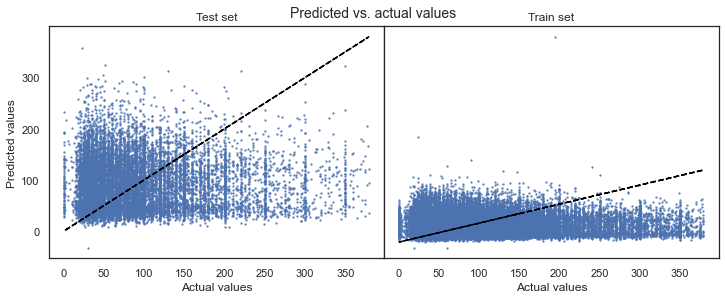

In [70]:
# Scatterplot of predicted vs. actual values
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
fig.suptitle('Predicted vs. actual values', fontsize=14, y=1)
plt.subplots_adjust(top=0.93, wspace=0)
    
ax1.scatter(y_test, y_test_preds, s=2, alpha=0.7)
ax1.plot(y_test, y_test, color='black', linestyle='--')
ax1.set_title('Test set')
ax1.set_xlabel('Actual values')
ax1.set_ylabel('Predicted values')
    
ax2.scatter(y_train, y_train_preds, s=2, alpha=0.7)
ax2.plot(y_test, y_test, color='black', linestyle='--')
ax2.set_title('Train set')
ax2.set_xlabel('Actual values')
ax2.set_ylabel('')
ax2.set_yticklabels(labels='')
    
plt.show()

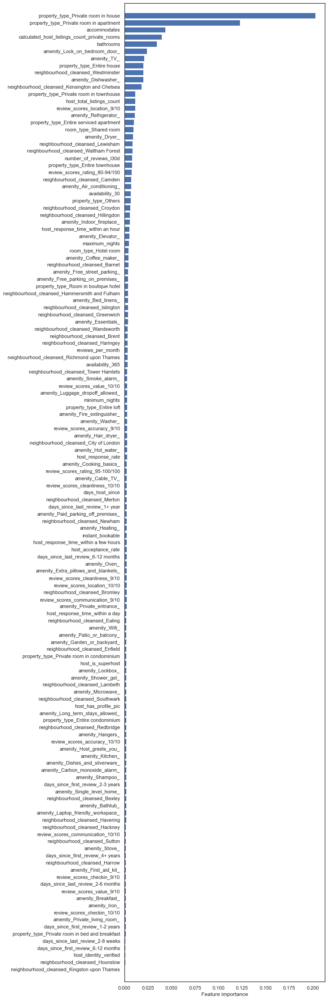

,weight
property_type_Private room in house,0.202666
property_type_Private room in apartment,0.122758
accommodates,0.043587
calculated_host_listings_count_private_rooms,0.039593
bathrooms,0.034700
amenity_Lock_on_bedroom_door_,0.024030
amenity_TV_,0.021340
property_type_Entire house,0.020257
neighbourhood_cleansed_Westminster,0.020221
amenity_Dishwasher_,0.020011


In [71]:
ft_weights_xgb_reg = pd.DataFrame(xgb_model.feature_importances_, columns=['weight'], index=X_train.columns)
ft_weights_xgb_reg = ft_weights_xgb_reg.sort_values('weight')

# Plotting feature importances
plt.figure(figsize=(8, 40))
plt.barh(ft_weights_xgb_reg.index, ft_weights_xgb_reg.weight, align='center') 
plt.xlabel("Feature importance")
plt.margins(y=0.01)
plt.show()
ft_weights_xgb_reg.sort_values(by='weight', ascending=False)[:10]

# Previous Workings, including Grid search, and versions of modelling

In [71]:
#version 2
sc = MinMaxScaler()
X = listings.drop('price', axis=1)
y = listings['price']

X = sc.fit_transform(X)

#Splitting the data into train and test split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

#Score using your model
test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )

print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))



        R2 for test data: 0.5721908224482644
        R2 for train data: 0.5587369687764774
        
        RMSE for test data: 43.60279327379633
        RMSE for train data: 44.0257532308135
        
        Mean Absolute Error for test data: 28.975117604140678
        Mean Absolute Error for train data: 29.285391108165815
    
	Explained variance: 0.5721957464128624
	Mean absolute error: 28.975117604140678
	R2 score: 0.5721908224482644


# Modelling with features that are greater than 0.10 in their correlation to price

In [72]:
#Split into explanatory and response variables
X = final_listings_scaled_df
y = listings['price']

#Split into train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.3, random_state=42)

lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

#Score using your model
test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )

print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))


        R2 for test data: 0.5323179741594108
        R2 for train data: 0.5169100922054044
        
        RMSE for test data: 45.75630281878158
        RMSE for train data: 45.95300053364476
        
        Mean Absolute Error for test data: 30.56000289765431
        Mean Absolute Error for train data: 30.63468448257547
    
	Explained variance: 0.5323843075006967
	Mean absolute error: 30.56000289765431
	R2 score: 0.5323179741594108


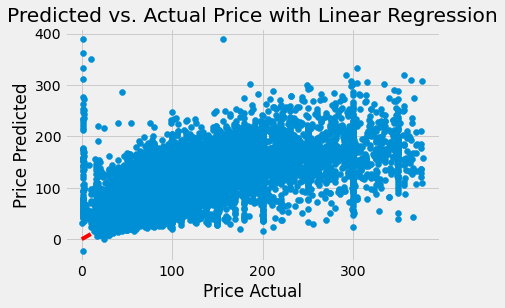

In [73]:
# Plot
plt.scatter(y_test, y_test_preds)
plt.plot(y_test, y_test,color='red')
plt.grid(True)
plt.title('Predicted vs. Actual Price with Linear Regression')
plt.ylabel('Price Predicted')
plt.xlabel('Price Actual');

In [78]:


#Instantiate
xgb_model = xgboost.XGBRegressor()
#Fit
xgb_model.fit(X_train, y_train)
#Predict
training_preds_xgb_reg = xgb_model.predict(X_train)
test_preds_xgb_reg = xgb_model.predict(X_test)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(r2_score(y_test, test_preds_xgb_reg), 
               r2_score(y_train, training_preds_xgb_reg),
               mean_squared_error(y_test, test_preds_xgb_reg) ** (1/2),
               mean_squared_error(y_train, training_preds_xgb_reg) ** (1/2),
               mean_absolute_error(y_test, test_preds_xgb_reg),
               mean_absolute_error(y_train, training_preds_xgb_reg)
               )
     )


        R2 for test data: 0.6066246767228762
        R2 for train data: 0.692636437158684
        
        RMSE for test data: 41.964218757680484
        RMSE for train data: 36.654397283193234
        
        Mean Absolute Error for test data: 27.3991270440558
        Mean Absolute Error for train data: 24.592485916429045
    


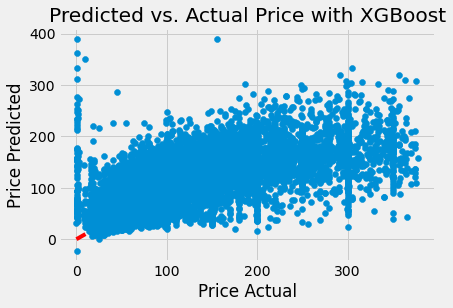

In [79]:
# Plot
plt.scatter(y_test, y_test_preds)
plt.plot(y_test, y_test, color='red')
plt.grid(True)
plt.title('Predicted vs. Actual Price with XGBoost')
plt.ylabel('Price Predicted')
plt.xlabel('Price Actual');

In [80]:
def coef_weights(coefficients, X_train):
    '''
    INPUT:
    coefficients - the coefficients of the linear model 
    X_train - the training data, so the column names can be used
    OUTPUT:
    coefs_df - a dataframe holding the coefficient, estimate, and abs(estimate)
    
    Provides a dataframe that can be used to understand the most influential coefficients
    in a linear model by providing the coefficient estimates along with the name of the 
    variable attached to the coefficient.
    '''
    coefs_df = pd.DataFrame()
    coefs_df['feature'] = X_train.columns
    coefs_df['coefs'] = lm_model.coef_
    coefs_df['abs_coefs'] = np.abs(lm_model.coef_)
    coefs_df = coefs_df.sort_values('feature', ascending=False)
    return coefs_df

#Use the function
coef_df = coef_weights(lm_model.coef_, X_train)

#A quick look at the top results
coef_df.head(10)

,feature,coefs,abs_coefs
37,room_type_Private room,-32.166323,32.166323
36,property_type_Private room in house,-6.387339,6.387339
35,property_type_Private room in apartment,-2.043660,2.043660
34,property_type_Entire townhouse,13.312657,13.312657
33,property_type_Entire house,3.821190,3.821190
32,neighbourhood_cleansed_Westminster,26.112051,26.112051
31,neighbourhood_cleansed_Kensington and Chelsea,26.617045,26.617045
0,host_total_listings_count,-89.987121,89.987121
30,host_response_time_not provided,1.111254,1.111254
1,host_identity_verified,-0.816542,0.816542


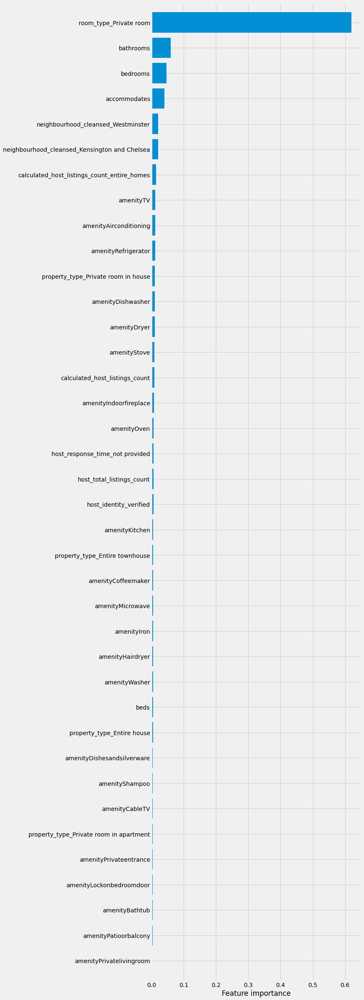

,weight
room_type_Private room,0.619512
bathrooms,0.058663
bedrooms,0.046283
accommodates,0.039326
neighbourhood_cleansed_Westminster,0.020698
neighbourhood_cleansed_Kensington and Chelsea,0.020267
calculated_host_listings_count_entire_homes,0.014340
amenityTV,0.011206
amenityAirconditioning,0.011156
amenityRefrigerator,0.010792


In [81]:
ft_weights_xgb_reg = pd.DataFrame(xgb_model.feature_importances_, columns=['weight'], index=X_train.columns)
ft_weights_xgb_reg = ft_weights_xgb_reg.sort_values('weight')

# Plotting feature importances
plt.figure(figsize=(8, 40))
plt.barh(ft_weights_xgb_reg.index, ft_weights_xgb_reg.weight, align='center') 
plt.xlabel("Feature importance")
plt.margins(y=0.01)
plt.show()
ft_weights_xgb_reg.sort_values(by='weight', ascending=False)[:20]


In [135]:
# Separating X and y
X = transformed_df.drop(['price', 'has_availability', 'calculated_host_listings_count_shared_rooms'], axis=1)
y = transformed_df.price

# Scaling
scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))


In [136]:
# Splitting into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)


# Linear Regression Model

In [117]:
lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

#Score using your model
test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.5443987546852999
        R2 for train data: 0.5511409840448204
        
        RMSE for test data: 44.38177566325036
        RMSE for train data: 44.55512201455092
        
        Mean Absolute Error for test data: 29.701350688221787
        Mean Absolute Error for train data: 29.81364213680781
    


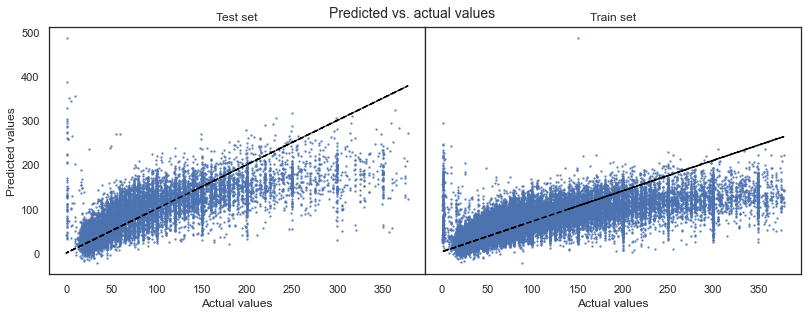

In [130]:
# Scatterplot of predicted vs. actual values
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
fig.suptitle('Predicted vs. actual values', fontsize=14, y=1)
plt.subplots_adjust(top=0.93, wspace=0)
    
ax1.scatter(y_test, y_test_preds, s=2, alpha=0.7)
ax1.plot(y_test, y_test, color='black', linestyle='--')
ax1.set_title('Test set')
ax1.set_xlabel('Actual values')
ax1.set_ylabel('Predicted values')
    
ax2.scatter(y_train, y_train_preds, s=2, alpha=0.7)
ax2.plot(y_test, y_test, color='black', linestyle='--')
ax2.set_title('Train set')
ax2.set_xlabel('Actual values')
ax2.set_ylabel('')
ax2.set_yticklabels(labels='')
    
plt.show()

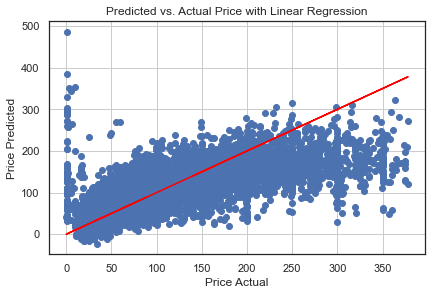

In [128]:
# Plot
plt.scatter(y_test, y_test_preds)
plt.plot(y_test,y_test,color='red')
plt.grid(True)
plt.title('Predicted vs. Actual Price with Linear Regression')
plt.ylabel('Price Predicted')
plt.xlabel('Price Actual');

In [96]:
#Instantiate
xgb_model = xgboost.XGBRegressor()
#Fit
xgb_model.fit(X_train, y_train)
#Predict
training_preds_xgb_reg = xgb_model.predict(X_train)
test_preds_xgb_reg = xgb_model.predict(X_test)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(r2_score(y_test, test_preds_xgb_reg), 
               r2_score(y_train, training_preds_xgb_reg),
               mean_squared_error(y_test, test_preds_xgb_reg) ** (1/2),
               mean_squared_error(y_train, training_preds_xgb_reg) ** (1/2),
               mean_absolute_error(y_test, test_preds_xgb_reg),
               mean_absolute_error(y_train, training_preds_xgb_reg)
               )
     )


        R2 for test data: 0.664014675607467
        R2 for train data: 0.7675282959510896
        
        RMSE for test data: 38.11293346244045
        RMSE for train data: 32.06473908441506
        
        Mean Absolute Error for test data: 25.04764539334685
        Mean Absolute Error for train data: 21.37679781288299
    


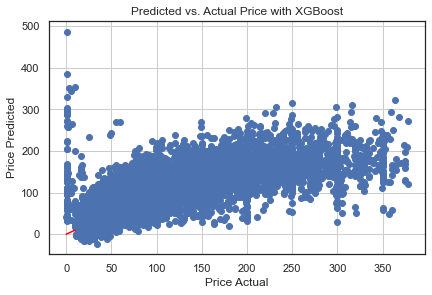

In [97]:
# Plot
plt.scatter(y_test, y_test_preds)
plt.plot(y_test,y_test,color='red')
plt.grid(True)
plt.title('Predicted vs. Actual Price with XGBoost')
plt.ylabel('Price Predicted')
plt.xlabel('Price Actual');

In [98]:
def coef_weights(coefficients, X_train):
    '''
    INPUT:
    coefficients - the coefficients of the linear model 
    X_train - the training data, so the column names can be used
    OUTPUT:
    coefs_df - a dataframe holding the coefficient, estimate, and abs(estimate)
    
    Provides a dataframe that can be used to understand the most influential coefficients
    in a linear model by providing the coefficient estimates along with the name of the 
    variable attached to the coefficient.
    '''
    coefs_df = pd.DataFrame()
    coefs_df['feature'] = X_train.columns
    coefs_df['coefs'] = lm_model.coef_
    coefs_df['abs_coefs'] = np.abs(lm_model.coef_)
    coefs_df = coefs_df.sort_values('feature', ascending=False)
    return coefs_df

#Use the function
coef_df = coef_weights(lm_model.coef_, X_train)

#A quick look at the top results
coef_df.head(10)

,feature,coefs,abs_coefs
117,room_type_Shared room,-43.153350,43.153350
116,room_type_Private room,-25.419067,25.419067
115,room_type_Hotel room,-7.166309,7.166309
18,reviews_per_month,-152.998831,152.998831
114,property_type_Room in boutique hotel,-8.707925,8.707925
113,property_type_Private room in townhouse,-12.121175,12.121175
112,property_type_Private room in house,-10.965551,10.965551
111,property_type_Private room in condominium,-8.548656,8.548656
110,property_type_Private room in bed and breakfast,-12.632453,12.632453
109,property_type_Private room in apartment,-11.165403,11.165403


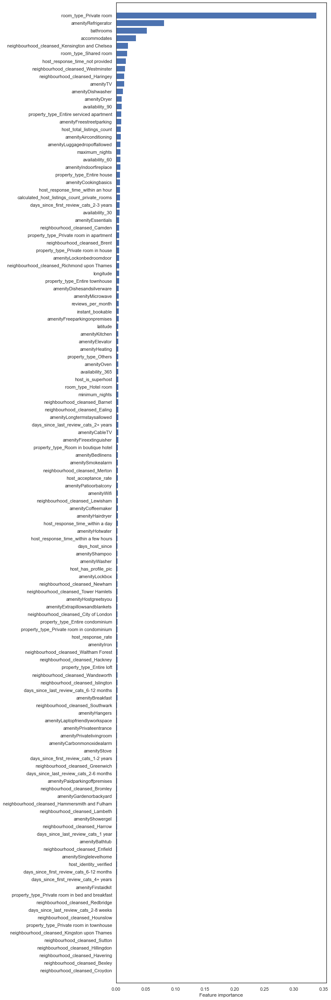

,weight
room_type_Private room,0.337688
amenityRefrigerator,0.080987
bathrooms,0.051734
accommodates,0.033648
neighbourhood_cleansed_Kensington and Chelsea,0.020283
room_type_Shared room,0.018605
host_response_time_not provided,0.016327
neighbourhood_cleansed_Westminster,0.014826
neighbourhood_cleansed_Haringey,0.013717
amenityTV,0.013437


In [99]:
ft_weights_xgb_reg = pd.DataFrame(xgb_model.feature_importances_, columns=['weight'], index=X_train.columns)
ft_weights_xgb_reg = ft_weights_xgb_reg.sort_values('weight')

# Plotting feature importances
plt.figure(figsize=(8, 40))
plt.barh(ft_weights_xgb_reg.index, ft_weights_xgb_reg.weight, align='center') 
plt.xlabel("Feature importance")
plt.margins(y=0.01)
plt.show()
ft_weights_xgb_reg.sort_values(by='weight', ascending=False)[:20]

# GridSearch and RandomSearch with cross-validation (cv)

Initially I did a GridSearch with cv = 3. It took a very long time and affected the performance of my laptop when I tried to do other work.

The second time, I choose to compare it using RandomSearch with cv = 10 instead.

The results is better with the parameters from the GridSearch.

# RandomizedSearchCV with CV = 10

In [134]:


X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = xgboost.XGBRegressor()

# create Grid
param_grid = {'n_estimators': [100, 150, 200],
              'learning_rate': [0.01, 0.05, 0.1], 
              'max_depth': [3, 4, 5, 6, 7],
              'colsample_bytree': [0.6, 0.7, 1],
              'gamma': [0.0, 0.1, 0.2]}

# instantiate the tuned model
booster_grid_search = RandomizedSearchCV(lm_model, param_grid, cv=10, n_jobs=-1) # n_jobs is the number of cores. So I should do 1 or 2 so that it will not use all the core.

# train the tuned model
booster_grid_search.fit(X_train, y_train)

# print best estimator parameters found during the grid search
print(booster_grid_search.best_params_)

#started at 10.19pm

{'n_estimators': 150, 'max_depth': 6, 'learning_rate': 0.1, 'gamma': 0.1, 'colsample_bytree': 0.7}


In [137]:
#using parameters given from RandomSearch
#using the X = transformed_df.drop(['price', 'has_availability', 'calculated_host_listings_count_shared_rooms'], axis=1)
#y = transformed_df.price

lm_model = xgboost.XGBRegressor(colsample_bytree=0.7, gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=150) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)


test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.6620074127022924
        R2 for train data: 0.7200750806531939
        
        RMSE for test data: 38.22661217155168
        RMSE for train data: 35.18547689276337
        
        Mean Absolute Error for test data: 24.946475912049277
        Mean Absolute Error for train data: 23.106920728169218
    


In [139]:
X = listings.drop('price', axis=1)
y = listings['price']

# Scaling
scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

#using parameters given from GridSearch
lm_model = xgboost.XGBRegressor(colsample_bytree=0.7, gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=150) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)


test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )



        R2 for test data: 0.6745768492697555
        R2 for train data: 0.7400490566967937
        
        RMSE for test data: 38.16803560639405
        RMSE for train data: 33.708978392917366
        
        Mean Absolute Error for test data: 24.541892734290954
        Mean Absolute Error for train data: 22.216957194203445
    


# Performed a GridSearch on XGBoost with cross validation = 3

Returns the following result:
    {'colsample_bytree': 0.6, 'gamma': 0.0, 'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 200}
(workings for this can be found further down the notebook)

In [100]:
#using parameters given from GridSearch
lm_model = xgboost.XGBRegressor(colsample_bytree=0.6, gamma=0.0, learning_rate=0.1, max_depth=7, n_estimators=200) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)


test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )



        R2 for test data: 0.6755388373077305
        R2 for train data: 0.7845906525380986
        
        RMSE for test data: 37.45360126931654
        RMSE for train data: 30.865614903011302
        
        Mean Absolute Error for test data: 24.353972727344527
        Mean Absolute Error for train data: 20.465784249634194
    


# Comparing results between using Standard or MinMax Scaler

The results from MinMax is slightly better:

Mean Absolute Error for test data using Standard: **29.67**.
Mean Absolute Error for test data using MinMax: **29.64**

RMSE for test data using Standard: **44.33**.
RMSE for test data using MinMax: **44.32**

R2 for test data using Standard: **0.5454**.
R2 for test data using MinMax: **0.5456**

We shall continue with MinMaxScaler in this case.

In [181]:


# Separating X and y
X = transformed_df.drop(['price', 'has_availability', 'calculated_host_listings_count_shared_rooms'], axis=1)
y = transformed_df.price

# Scaling
scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

In [179]:
# Splitting into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

In [180]:
lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

#Score using your model
test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )

C:\Users\hui_z\anaconda3\envs\geo\lib\site-packages\sklearn\linear_model\_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  warnings.warn(



        R2 for test data: 0.5453759820514092
        R2 for train data: 0.5519353709191193
        
        RMSE for test data: 44.334152475195744
        RMSE for train data: 44.515677916596715
        
        Mean Absolute Error for test data: 29.67095235878202
        Mean Absolute Error for train data: 29.782247316379213
    


In [101]:
# Separating X and y
X = transformed_df.drop(['price', 'has_availability', 'calculated_host_listings_count_shared_rooms'], axis=1)
y = transformed_df.price

# Scaling
scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

# Splitting into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

Testing on Training model with PCA data

Going to try Random Forest

In [103]:
'''A PCA model is fitted for 60 components on the training data.'''
pca = PCA(n_components=60, random_state=1024);
pca.fit(X)

PCA(n_components=60, random_state=1024)

In [104]:
listings_pca = pca.transform(X);
X_p_train, X_p_test, y_p_train, y_p_test = train_test_split(listings_pca, y, test_size=0.33, random_state=1024)    

In [105]:
rf_classifier_2 = RandomForestRegressor(n_estimators=100, max_depth=40, criterion='mse', random_state=1024);
rf_classifier_2.fit(X_p_train, y_p_train)

y_p_pred = rf_classifier_2.predict(X_p_test);
y_p_pred_tr = rf_classifier_2.predict(X_p_train);

In [106]:
test_r2 = r2_score(y_p_test, y_p_pred)
train_r2 = r2_score(y_p_train, y_p_pred_tr)
test_rmse = mean_squared_error(y_p_test, y_p_pred) ** (1/2)
train_rmse = mean_squared_error(y_p_train, y_p_pred_tr) ** (1/2)

test_mae = mean_absolute_error(y_p_test, y_p_pred)
train_mae = mean_absolute_error(y_p_train, y_p_pred_tr)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.4866782066936498
        R2 for train data: 0.9259723536962964
        
        RMSE for test data: 47.223275122475506
        RMSE for train data: 18.112499689664006
        
        Mean Absolute Error for test data: 32.16681661666712
        Mean Absolute Error for train data: 12.204650943570828
    


In [107]:
'''A PCA model is fitted for 60 components on the training data.'''
pca = PCA(n_components=60, random_state=1024);
pca.fit(X)

listings_pca = pca.transform(X);
X_p_train, X_p_test, y_p_train, y_p_test = train_test_split(listings_pca, y, test_size=0.33, random_state=1024) 

rf_classifier_2 = xgboost.XGBRegressor(colsample_bytree=0.6, gamma=0.0, learning_rate=0.1, max_depth=7, n_estimators=200);
rf_classifier_2.fit(X_p_train, y_p_train)

y_p_pred = rf_classifier_2.predict(X_p_test);
y_p_pred_tr = rf_classifier_2.predict(X_p_train);

test_r2 = r2_score(y_p_test, y_p_pred)
train_r2 = r2_score(y_p_train, y_p_pred_tr)
test_rmse = mean_squared_error(y_p_test, y_p_pred) ** (1/2)
train_rmse = mean_squared_error(y_p_train, y_p_pred_tr) ** (1/2)

test_mae = mean_absolute_error(y_p_test, y_p_pred)
train_mae = mean_absolute_error(y_p_train, y_p_pred_tr)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.4963291136937674
        R2 for train data: 0.7387070125865216
        
        RMSE for test data: 46.777248932396425
        RMSE for train data: 34.02869525924954
        
        Mean Absolute Error for test data: 31.63667832610832
        Mean Absolute Error for train data: 23.8385565550708
    


In [109]:
'''A PCA model is fitted for 2 components on the training data.'''
pca = PCA(n_components=2, random_state=1024);
pca.fit(X)

listings_pca = pca.transform(X);
X_p_train, X_p_test, y_p_train, y_p_test = train_test_split(listings_pca, y, test_size=0.33, random_state=1024) 

rf_classifier_2 = xgboost.XGBRegressor(colsample_bytree=0.6, gamma=0.0, learning_rate=0.1, max_depth=7, n_estimators=200);
rf_classifier_2.fit(X_p_train, y_p_train)

y_p_pred = rf_classifier_2.predict(X_p_test);
y_p_pred_tr = rf_classifier_2.predict(X_p_train);

test_r2 = r2_score(y_p_test, y_p_pred)
train_r2 = r2_score(y_p_train, y_p_pred_tr)
test_rmse = mean_squared_error(y_p_test, y_p_pred) ** (1/2)
train_rmse = mean_squared_error(y_p_train, y_p_pred_tr) ** (1/2)

test_mae = mean_absolute_error(y_p_test, y_p_pred)
train_mae = mean_absolute_error(y_p_train, y_p_pred_tr)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.09755682129071996
        R2 for train data: 0.19866293949997094
        
        RMSE for test data: 62.61396205543286
        RMSE for train data: 59.592147291592845
        
        Mean Absolute Error for test data: 45.92213444885389
        Mean Absolute Error for train data: 43.655796737685264
    


In [110]:
'''A PCA model is fitted for 30 components on the training data.'''
pca = PCA(n_components=30, random_state=1024);
pca.fit(X)

listings_pca = pca.transform(X);
X_p_train, X_p_test, y_p_train, y_p_test = train_test_split(listings_pca, y, test_size=0.33, random_state=1024) 

rf_classifier_2 = xgboost.XGBRegressor(colsample_bytree=0.6, gamma=0.0, learning_rate=0.1, max_depth=7, n_estimators=200);
rf_classifier_2.fit(X_p_train, y_p_train)

y_p_pred = rf_classifier_2.predict(X_p_test);
y_p_pred_tr = rf_classifier_2.predict(X_p_train);

test_r2 = r2_score(y_p_test, y_p_pred)
train_r2 = r2_score(y_p_train, y_p_pred_tr)
test_rmse = mean_squared_error(y_p_test, y_p_pred) ** (1/2)
train_rmse = mean_squared_error(y_p_train, y_p_pred_tr) ** (1/2)

test_mae = mean_absolute_error(y_p_test, y_p_pred)
train_mae = mean_absolute_error(y_p_train, y_p_pred_tr)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.46710707429271514
        R2 for train data: 0.6865707769328079
        
        RMSE for test data: 48.11508195675431
        RMSE for train data: 37.26929379152849
        
        Mean Absolute Error for test data: 32.774687414079104
        Mean Absolute Error for train data: 26.002334945571775
    


In [111]:
'''A PCA model is fitted for 100 components on the training data.'''
pca = PCA(n_components=100, random_state=1024);
pca.fit(X)

listings_pca = pca.transform(X);
X_p_train, X_p_test, y_p_train, y_p_test = train_test_split(listings_pca, y, test_size=0.33, random_state=1024) 

rf_classifier_2 = xgboost.XGBRegressor(colsample_bytree=0.6, gamma=0.0, learning_rate=0.1, max_depth=7, n_estimators=200);
rf_classifier_2.fit(X_p_train, y_p_train)

y_p_pred = rf_classifier_2.predict(X_p_test);
y_p_pred_tr = rf_classifier_2.predict(X_p_train);

test_r2 = r2_score(y_p_test, y_p_pred)
train_r2 = r2_score(y_p_train, y_p_pred_tr)
test_rmse = mean_squared_error(y_p_test, y_p_pred) ** (1/2)
train_rmse = mean_squared_error(y_p_train, y_p_pred_tr) ** (1/2)

test_mae = mean_absolute_error(y_p_test, y_p_pred)
train_mae = mean_absolute_error(y_p_train, y_p_pred_tr)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.569231833930383
        R2 for train data: 0.8073383463210979
        
        RMSE for test data: 43.25965514934516
        RMSE for train data: 29.21992266859466
        
        Mean Absolute Error for test data: 28.847041576271877
        Mean Absolute Error for train data: 20.332763014018955
    


In [112]:
'''A PCA model is fitted for 120 components on the training data.'''
pca = PCA(n_components=120, random_state=1024);
pca.fit(X)

listings_pca = pca.transform(X);
X_p_train, X_p_test, y_p_train, y_p_test = train_test_split(listings_pca, y, test_size=0.33, random_state=1024) 

rf_classifier_2 = xgboost.XGBRegressor(colsample_bytree=0.6, gamma=0.0, learning_rate=0.1, max_depth=7, n_estimators=200);
rf_classifier_2.fit(X_p_train, y_p_train)

y_p_pred = rf_classifier_2.predict(X_p_test);
y_p_pred_tr = rf_classifier_2.predict(X_p_train);

test_r2 = r2_score(y_p_test, y_p_pred)
train_r2 = r2_score(y_p_train, y_p_pred_tr)
test_rmse = mean_squared_error(y_p_test, y_p_pred) ** (1/2)
train_rmse = mean_squared_error(y_p_train, y_p_pred_tr) ** (1/2)

test_mae = mean_absolute_error(y_p_test, y_p_pred)
train_mae = mean_absolute_error(y_p_train, y_p_pred_tr)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.5877167448376563
        R2 for train data: 0.8040526282693997
        
        RMSE for test data: 42.32130983988281
        RMSE for train data: 29.4680326041333
        
        Mean Absolute Error for test data: 27.957239742705127
        Mean Absolute Error for train data: 20.41494545629687
    


In [114]:
'''A PCA model is fitted for 110 components on the training data.'''
pca = PCA(n_components=110, random_state=1024);
pca.fit(X)

listings_pca = pca.transform(X);
X_p_train, X_p_test, y_p_train, y_p_test = train_test_split(listings_pca, y, test_size=0.33, random_state=1024) 

rf_classifier_2 = xgboost.XGBRegressor(colsample_bytree=0.6, gamma=0.0, learning_rate=0.1, max_depth=7, n_estimators=200);
rf_classifier_2.fit(X_p_train, y_p_train)

y_p_pred = rf_classifier_2.predict(X_p_test);
y_p_pred_tr = rf_classifier_2.predict(X_p_train);

test_r2 = r2_score(y_p_test, y_p_pred)
train_r2 = r2_score(y_p_train, y_p_pred_tr)
test_rmse = mean_squared_error(y_p_test, y_p_pred) ** (1/2)
train_rmse = mean_squared_error(y_p_train, y_p_pred_tr) ** (1/2)

test_mae = mean_absolute_error(y_p_test, y_p_pred)
train_mae = mean_absolute_error(y_p_train, y_p_pred_tr)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.583125798263648
        R2 for train data: 0.8004132884954182
        
        RMSE for test data: 42.556290247196294
        RMSE for train data: 29.74042919386214
        
        Mean Absolute Error for test data: 28.20038773403678
        Mean Absolute Error for train data: 20.689176149435593
    


# Original baseline linear regression model before I went back and did further cleaning.

The improvements from re-cleaning data:

R2 for test data went from 0.47 to 0.57.
RMSE for test data went from 68.90 to 43.58.
MAE for test data went from 38.47 to 28.97.



In [84]:
#Perform Scaling
sc = StandardScaler()
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.2, random_state=42)

lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

#Score using your model
test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )

print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))



        R2 for test data: 0.47096051271062955
        R2 for train data: 0.47578414083005294
        
        RMSE for test data: 68.90024428793005
        RMSE for train data: 68.6478235962039
        
        Mean Absolute Error for test data: 38.47029139154331
        Mean Absolute Error for train data: 37.976704000094934
    


In [85]:
print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))

	Explained variance: 0.4709677791765473
	Mean absolute error: 38.47029139154331
	R2 score: 0.47096051271062955


# Fitting the Gradient Boosting Regression model to predict price

In [86]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = GradientBoostingRegressor(random_state=0) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )



print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))


        R2 for test data: 0.5211314999586214
        R2 for train data: 0.5501892621334634
        
        RMSE for test data: 65.29214959219748
        RMSE for train data: 63.70581430143095
        
        Mean Absolute Error for test data: 34.676486403356016
        Mean Absolute Error for train data: 33.813819806012695
    
	Explained variance: 0.521139439916147
	Mean absolute error: 34.676486403356016
	R2 score: 0.5211314999586214


# Price Prediction using XGBoost

In [87]:


X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = xgboost.XGBRegressor() # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)


test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))


        R2 for test data: 0.5898379887830136
        R2 for train data: 0.7843850467059867
        
        RMSE for test data: 60.42693257566465
        RMSE for train data: 44.10660195674622
        
        Mean Absolute Error for test data: 31.79550978343075
        Mean Absolute Error for train data: 25.58778742556826
    
	Explained variance: 0.5898506059330475
	Mean absolute error: 31.79550978343075
	R2 score: 0.5898379887830136


# Analysis:

Of the 3 models, XGBoost has the lowest error. However, the generalisation for XGBoost is the worst.




# Why?

In [90]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = xgboost.XGBRegressor(colsample_bytree=0.7, gamma=0.2, learning_rate=0.1, 
                           max_depth=6, n_estimators=200, random_state=4) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)


test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))


        R2 for test data: 0.5978338858437842
        R2 for train data: 0.7497738465281185
        
        RMSE for test data: 59.835037750070356
        RMSE for train data: 47.51497574814371
        
        Mean Absolute Error for test data: 31.065266615460295
        Mean Absolute Error for train data: 26.570869910706723
    
	Explained variance: 0.5978738480429284
	Mean absolute error: 31.065266615460295
	R2 score: 0.5978338858437842


# GridSearch for XGBoost

In [92]:


X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = xgboost.XGBRegressor()

# create Grid
param_grid = {'n_estimators': [100, 150, 200],
              'learning_rate': [0.01, 0.05, 0.1], 
              'max_depth': [3, 4, 5, 6, 7],
              'colsample_bytree': [0.6, 0.7, 1],
              'gamma': [0.0, 0.1, 0.2]}

# instantiate the tuned model
booster_grid_search = GridSearchCV(lm_model, param_grid, cv=3, n_jobs=-1) # n_jobs is the number of cores. So I should do 1 or 2 so that it will not use all the core.

# train the tuned model
booster_grid_search.fit(X_train, y_train)

# print best estimator parameters found during the grid search
print(booster_grid_search.best_params_)

{'colsample_bytree': 0.6, 'gamma': 0.0, 'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 200}


# Returns the following result:
    {'colsample_bytree': 0.6, 'gamma': 0.0, 'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 200}

Start time for above gridsearch is 4.49pm on 24th Nov and returned result at 7.07pm

# Using the best estimator parameters from Grid Search

In [94]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = xgboost.XGBRegressor(colsample_bytree=0.6, gamma=0.0, learning_rate=0.1, max_depth=7, n_estimators=200) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)


test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))


        R2 for test data: 0.6116862176999539
        R2 for train data: 0.8113090723790194
        
        RMSE for test data: 58.79551983240399
        RMSE for train data: 41.26099263051627
        
        Mean Absolute Error for test data: 30.56221232361796
        Mean Absolute Error for train data: 23.87194336800996
    
	Explained variance: 0.6117347582937875
	Mean absolute error: 30.56221232361796
	R2 score: 0.6116862176999539


In [99]:
listings.shape

(76973, 133)

In [127]:
#listings.columns.to_list()

Variance inflation factor (VIF) is a measure of the amount of multicollinearity in a set of multiple regression variables.

We found the following three features have very high measure of multicollinearity:

calculated_host_listings_count

calculated_host_listings_count_entire_homes

host_total_listings_count


We will try to remove the following features to check if the results improve.

In [102]:
listings = listings.drop(['host_total_listings_count'], axis=1)

In [103]:
#Perform Scaling
sc = StandardScaler()
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.2, random_state=42)

lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

#Score using your model
test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )

print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))


        R2 for test data: 0.4709088171830753
        R2 for train data: 0.4757583716069781
        
        RMSE for test data: 68.90361052764847
        RMSE for train data: 68.64951085853055
        
        Mean Absolute Error for test data: 38.47764098102821
        Mean Absolute Error for train data: 37.98484692968769
    
	Explained variance: 0.4709163069616279
	Mean absolute error: 38.47764098102821
	R2 score: 0.4709088171830753


In [104]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = GradientBoostingRegressor(random_state=0) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )



print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))


        R2 for test data: 0.5201935614604629
        R2 for train data: 0.5487845982386343
        
        RMSE for test data: 65.35606073171456
        RMSE for train data: 63.8052066654774
        
        Mean Absolute Error for test data: 34.65374913158848
        Mean Absolute Error for train data: 33.81002405641049
    
	Explained variance: 0.5202019281752135
	Mean absolute error: 34.65374913158848
	R2 score: 0.5201935614604629


In [105]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = xgboost.XGBRegressor() # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)


test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))


        R2 for test data: 0.5893092553680908
        R2 for train data: 0.7849007669816838
        
        RMSE for test data: 60.46586773749714
        RMSE for train data: 44.053822020654074
        
        Mean Absolute Error for test data: 31.890704626536905
        Mean Absolute Error for train data: 25.683431302217794
    
	Explained variance: 0.5893297217475573
	Mean absolute error: 31.890704626536905
	R2 score: 0.5893092553680908


In [106]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = xgboost.XGBRegressor(colsample_bytree=0.6, gamma=0.0, learning_rate=0.1, max_depth=7, n_estimators=200) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)


test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))


        R2 for test data: 0.6059784600152998
        R2 for train data: 0.8086482206785588
        
        RMSE for test data: 59.22605613983664
        RMSE for train data: 41.55089802340637
        
        Mean Absolute Error for test data: 30.709469069467197
        Mean Absolute Error for train data: 24.006027153474125
    
	Explained variance: 0.6060196538013083
	Mean absolute error: 30.709469069467197
	R2 score: 0.6059784600152998


In [107]:
listings = listings.drop(['calculated_host_listings_count', 'calculated_host_listings_count_entire_homes'], axis=1)

In [108]:
listings.shape

(76973, 130)

In [109]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.2, random_state=42)

lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

#Score using your model
test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )

print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))


        R2 for test data: 0.46914825687255
        R2 for train data: 0.47169775895621247
        
        RMSE for test data: 69.01815431424018
        RMSE for train data: 68.91486689131682
        
        Mean Absolute Error for test data: 38.662077085278305
        Mean Absolute Error for train data: 38.28277481676542
    
	Explained variance: 0.46915909558059876
	Mean absolute error: 38.662077085278305
	R2 score: 0.46914825687255


In [110]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = GradientBoostingRegressor(random_state=0) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )



print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))


        R2 for test data: 0.5149467523933117
        R2 for train data: 0.5437251956523382
        
        RMSE for test data: 65.71243194798814
        RMSE for train data: 64.16192802672114
        
        Mean Absolute Error for test data: 34.92255124857549
        Mean Absolute Error for train data: 34.09090348201663
    
	Explained variance: 0.5149600644413597
	Mean absolute error: 34.92255124857549
	R2 score: 0.5149467523933117


In [111]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = xgboost.XGBRegressor() # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)


test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))


        R2 for test data: 0.5748485905074279
        R2 for train data: 0.7865819816971237
        
        RMSE for test data: 61.521178119564546
        RMSE for train data: 43.88132204934289
        
        Mean Absolute Error for test data: 32.335754813266014
        Mean Absolute Error for train data: 25.667358637561023
    
	Explained variance: 0.5749095719507994
	Mean absolute error: 32.335754813266014
	R2 score: 0.5748485905074279


In [112]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = xgboost.XGBRegressor(colsample_bytree=0.6, gamma=0.0, learning_rate=0.1, max_depth=7, n_estimators=200) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)


test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))


        R2 for test data: 0.6054218398243196
        R2 for train data: 0.8043500250809758
        
        RMSE for test data: 59.26787464584503
        RMSE for train data: 42.014970240525955
        
        Mean Absolute Error for test data: 31.002693131591858
        Mean Absolute Error for train data: 24.255152951446235
    
	Explained variance: 0.6054977554785557
	Mean absolute error: 31.002693131591858
	R2 score: 0.6054218398243196


# Analysis:

There isn't much improvement from removing the features with the highest measure of multicollinearity. 

In [37]:

pca = PCA(n_components=2)
pca.fit(listings)

PCA(n_components=2)

In [80]:
print(pca.components_)

[[ 7.14615864e-02  9.97443340e-01 -1.39206596e-08  2.95993214e-08
  -2.24305296e-10 -7.27468366e-08 -3.32743847e-11 -5.91289030e-10
  -1.80141494e-12 -1.39918404e-11 -1.15323666e-10 -9.10445106e-12
  -2.56212705e-10 -5.45017918e-11 -8.48685901e-09 -3.17170844e-10
  -1.59611347e-04  2.03109719e-08  4.21699447e-08  6.50429618e-08
   1.61816602e-07 -5.33474587e-08  3.35563133e-09  3.72175865e-10
   1.27597617e-09 -6.08026409e-08 -5.56246549e-08 -3.58911400e-09
   5.83201591e-10 -7.73697485e-06  2.63506240e-10 -2.04048010e-11
   2.25696998e-10  9.73503111e-12 -3.60993249e-10  1.32805300e-10
  -2.06500836e-10 -1.72539613e-12 -3.51950415e-11 -1.43683291e-10
  -2.21346527e-10 -1.04473768e-10  8.74003528e-11 -3.85066412e-11
   3.73664460e-10  2.33058248e-10  1.26792339e-10 -2.12912732e-11
  -1.10686849e-10 -1.78487924e-12  3.29806477e-10 -8.70753564e-11
  -2.80298743e-10  1.98865896e-10 -1.62026404e-10  1.53990050e-10
  -1.97508589e-10  7.82616451e-12  5.31786701e-10 -9.94477586e-11
   1.55307

In [104]:
print(pca.explained_variance_)

[1.00858804e+16 1.23368572e+14]


In [105]:
print(pca.explained_variance_ratio_)

[0.98631503 0.01206442]


# PCA without removing outliers in price.

(76973, 2)


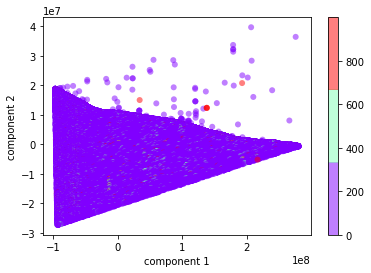

In [106]:
projected = pca.fit_transform(listings)
print(projected.shape)

# plot this PCA projection
plt.scatter(projected[:, 0], projected[:, 1], c=listings['price'],
            edgecolor='none', alpha=0.5,
            cmap=plt.cm.get_cmap('rainbow', 3))
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.colorbar()
plt.show;

# PCA after removing outliers @ price > 400

(75487, 2)


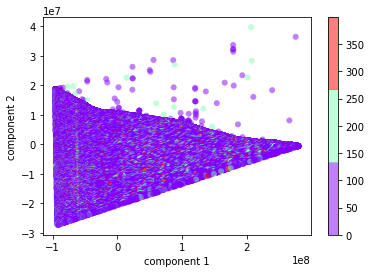

In [87]:
projected = pca.fit_transform(listings)
print(projected.shape)

# plot this PCA projection
plt.scatter(projected[:, 0], projected[:, 1], c=listings['price'],
            edgecolor='none', alpha=0.5,
            cmap=plt.cm.get_cmap('rainbow', 3))
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.colorbar()
plt.show;

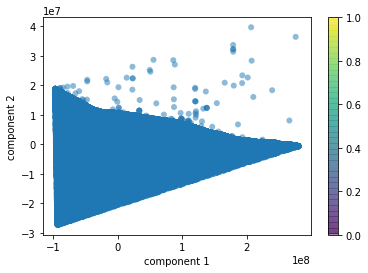

In [107]:
# plot this PCA projection
plt.scatter(projected[:, 0], projected[:, 1],
            edgecolor='none', alpha=0.5,
            cmap=plt.cm.get_cmap('rainbow', 3))
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.colorbar()
plt.show;

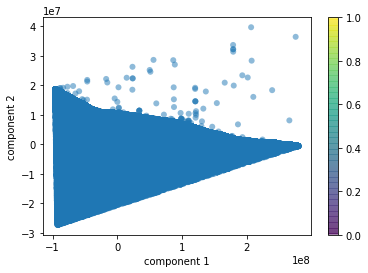

In [88]:
# plot this PCA projection
plt.scatter(projected[:, 0], projected[:, 1],
            edgecolor='none', alpha=0.5,
            cmap=plt.cm.get_cmap('rainbow', 3))
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.colorbar()
plt.show;

(76973, 10)


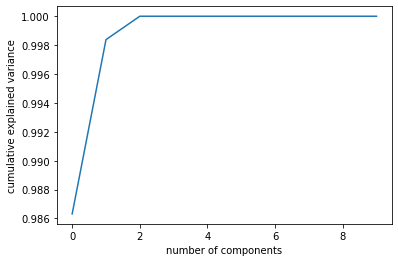

In [38]:


pca = PCA(n_components=10)
pca.fit(X)

projected = pca.fit_transform(listings)
print(projected.shape)

#plot explained varianace against components
plt.figure
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');
plt.show()
plt.close()

(76973, 10)


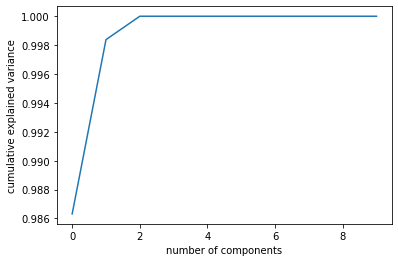

In [39]:

X = listings.drop('price', axis=1)

pca = PCA(n_components=10)
pca.fit(X)

projected = pca.fit_transform(listings)
print(projected.shape)

#plot explained varianace against components
plt.figure
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');
plt.show()
plt.close()



(76973, 5)


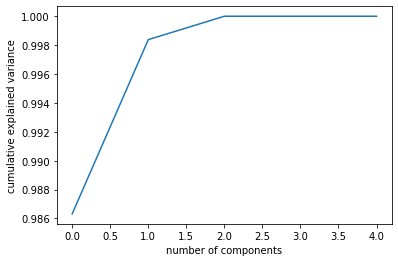

In [113]:
pca = PCA(n_components=5)
pca.fit(listings)

projected = pca.fit_transform(listings)
print(projected.shape)

#plot explained varianace against components
plt.figure
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');
plt.show()
plt.close()

(76973, 3)


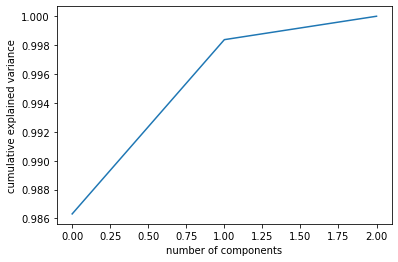

In [115]:
pca = PCA(n_components=3)
pca.fit(listings)

projected = pca.fit_transform(listings)
print(projected.shape)

#plot explained varianace against components
plt.figure
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');
plt.show()
plt.close()

(76973, 2)


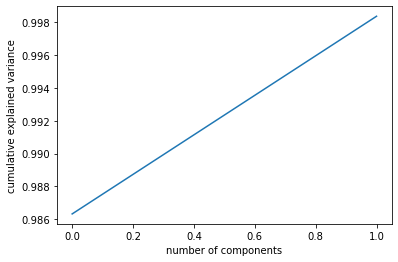

In [116]:
pca = PCA(n_components=2)
pca.fit(listings)

projected = pca.fit_transform(listings)
print(projected.shape)

#plot explained varianace against components
plt.figure
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');
plt.show()
plt.close()

In [ ]:
get_params(deep=True)

<Figure size 3000x2000 with 0 Axes>

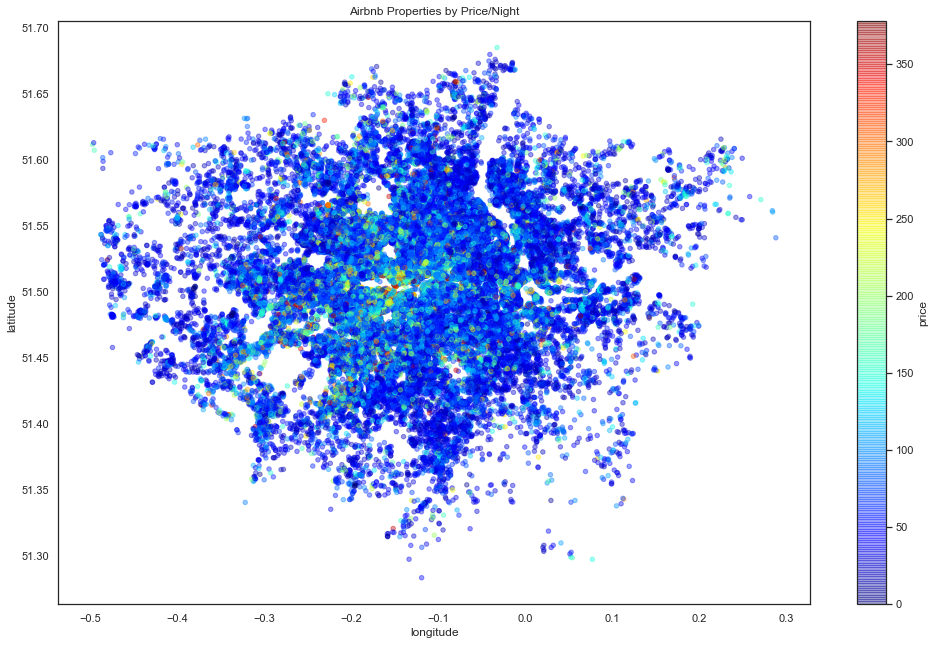

In [102]:
#Map for list Average Price

plt.figure(figsize=(15,10),dpi=200),

listing_map=listings.plot(kind='scatter', x='longitude', y='latitude', c='price', 
                                      cmap=plt.get_cmap('jet'), colorbar=True, alpha=0.4,figsize=(15,10))
plt.title("Airbnb Properties by Price/Night")

plt.show()

In [ ]:
#Map for list Average Price

plt.figure(figsize=(15,10),dpi=200),

listing_map=listings.plot(kind='scatter', x='longitude', y='latitude', c='price', 
                                      cmap=plt.get_cmap('jet'), colorbar=True, alpha=0.4,figsize=(15,10))
plt.title("Airbnb Properties by Price/Night")

plt.show()

In [12]:
'''
A Random Forest Regressor is trained on the input values, to predict Price.

Predictions are made on both training and testing.
'''
X, y = listings.drop('price', axis=1), listings['price'];
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1024);

rf_classifier = RandomForestRegressor(n_estimators=100, max_depth=20, criterion='mse', random_state=1024);
rf_classifier.fit(X_train, y_train)

y_pred = rf_classifier.predict(X_test);
y_pred_tr = rf_classifier.predict(X_train);

In [17]:
test_r2 = r2_score(y_test, y_pred)
train_r2 = r2_score(y_train, y_pred_tr)
test_rmse = mean_squared_error(y_test, y_pred) ** (1/2)
train_rmse = mean_squared_error(y_train, y_pred_tr) ** (1/2)

test_mae = mean_absolute_error(y_test, y_pred)
train_mae = mean_absolute_error(y_train, y_pred_tr)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.5841472370407268
        R2 for train data: 0.9131886073061956
        
        RMSE for test data: 61.67764289528763
        RMSE for train data: 27.806847941967717
        
        Mean Absolute Error for test data: 32.48947530307361
        Mean Absolute Error for train data: 17.007608203872707
    


In [19]:
from sklearn.decomposition import PCA


'''A PCA model is fitted for 60 components on the training data.'''
pca = PCA(n_components=60, random_state=1024);
pca.fit(l_X)

PCA(n_components=60, random_state=1024)

In [29]:
pca = PCA(n_components=70, random_state=1024);
pca.fit(l_X)

PCA(n_components=70, random_state=1024)

In [30]:
listings_pca = pca.transform(l_X);
l_X_p_train, l_X_p_test, l_y_p_train, l_y_p_test = train_test_split(listings_pca, l_y, test_size=0.33, random_state=1024)    

In [31]:
rf_classifier_2 = RandomForestRegressor(n_estimators=100, max_depth=40, criterion='mse', random_state=1024);
rf_classifier_2.fit(l_X_p_train, l_y_p_train)

l_y_p_pred = rf_classifier_2.predict(l_X_p_test);
l_y_p_pred_tr = rf_classifier_2.predict(l_X_p_train);

In [32]:
#70 components

test_r2 = r2_score(l_y_p_test, l_y_p_pred)
train_r2 = r2_score(l_y_p_train, l_y_p_pred_tr)
test_rmse = mean_squared_error(l_y_p_test, l_y_p_pred) ** (1/2)
train_rmse = mean_squared_error(l_y_p_train, l_y_p_pred_tr) ** (1/2)

test_mae = mean_absolute_error(l_y_p_test, l_y_p_pred)
train_mae = mean_absolute_error(l_y_p_train, l_y_p_pred_tr)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.5009951671774691
        R2 for train data: 0.9289805260465092
        
        RMSE for test data: 67.56322138350455
        RMSE for train data: 25.150818652252504
        
        Mean Absolute Error for test data: 37.34439245554988
        Mean Absolute Error for train data: 13.919457866669742
    


In [28]:
#10 components:

test_r2 = r2_score(l_y_p_test, l_y_p_pred)
train_r2 = r2_score(l_y_p_train, l_y_p_pred_tr)
test_rmse = mean_squared_error(l_y_p_test, l_y_p_pred) ** (1/2)
train_rmse = mean_squared_error(l_y_p_train, l_y_p_pred_tr) ** (1/2)

test_mae = mean_absolute_error(l_y_p_test, l_y_p_pred)
train_mae = mean_absolute_error(l_y_p_train, l_y_p_pred_tr)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.22844689651667305
        R2 for train data: 0.8897456872516475
        
        RMSE for test data: 84.01191489010098
        RMSE for train data: 31.337272453385495
        
        Mean Absolute Error for test data: 52.520074075620236
        Mean Absolute Error for train data: 19.57403488058938
    


In [23]:
#60 components:

test_r2 = r2_score(l_y_p_test, l_y_p_pred)
train_r2 = r2_score(l_y_p_train, l_y_p_pred_tr)
test_rmse = mean_squared_error(l_y_p_test, l_y_p_pred) ** (1/2)
train_rmse = mean_squared_error(l_y_p_train, l_y_p_pred_tr) ** (1/2)

test_mae = mean_absolute_error(l_y_p_test, l_y_p_pred)
train_mae = mean_absolute_error(l_y_p_train, l_y_p_pred_tr)


print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.49831934357971164
        R2 for train data: 0.9282921429678435
        
        RMSE for test data: 67.74412699612648
        RMSE for train data: 25.272416609514416
        
        Mean Absolute Error for test data: 37.46697571829519
        Mean Absolute Error for train data: 13.977728792823665
    


# Fitting the Linear Regression model to predict price

In [17]:
#Split into explanatory and response variables
X = listings.drop('price', axis=1)
y = listings['price']

#Split into train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.3, random_state=42)

lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

#Score using your model
test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.4651214223887119
        R2 for train data: 0.4786803484948995
        
        RMSE for test data: 69.00497996150229
        RMSE for train data: 68.58295763771645
        
        Mean Absolute Error for test data: 38.52955397265066
        Mean Absolute Error for train data: 38.00227442626684
    


In [20]:

sc = StandardScaler()
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split

X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

#Score using your model
test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )


        R2 for test data: 0.4651214223887119
        R2 for train data: 0.4786803484948994
        
        RMSE for test data: 69.00497996150229
        RMSE for train data: 68.58295763771645
        
        Mean Absolute Error for test data: 38.529553972650604
        Mean Absolute Error for train data: 38.00227442626678
    


In [24]:

sc = StandardScaler()
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))

	Explained variance: 0.46513177380605664
	Mean absolute error: 38.529553972650604
	R2 score: 0.4651214223887119


In [28]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = GradientBoostingRegressor(random_state=0) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))

	Explained variance: 0.521139439916147
	Mean absolute error: 34.676486403356016
	R2 score: 0.5211314999586214


In [31]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = Lasso(alpha=0.01) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))

	Explained variance: 0.4650414842535976
	Mean absolute error: 38.51125614867906
	R2 score: 0.46503187314141126


C:\Users\hui_z\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5086213.538542122, tolerance: 48614.29268418549
  model = cd_fast.enet_coordinate_descent(


In [32]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = Ridge(alpha=0.01) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))

	Explained variance: 0.4651318046217898
	Mean absolute error: 38.52954905473656
	R2 score: 0.4651214535455176


In [33]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = DecisionTreeRegressor(random_state=0) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))

	Explained variance: 0.11873870818093857
	Mean absolute error: 44.8528494716785
	R2 score: 0.11809883324028592


In [67]:
X = listings.drop('price', axis=1)
y = listings['price']

X_sc = sc.fit_transform(X)

#Splitting the data into train and test split
X_train, X_test, y_train, y_test = train_test_split(X_sc, y, test_size=0.3, random_state=42)

lm_model = xgboost.XGBRegressor() # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

print("\tExplained variance:", explained_variance_score(y_test, y_test_preds))
print("\tMean absolute error:", mean_absolute_error(y_test, y_test_preds))
print("\tR2 score:", r2_score(y_test, y_test_preds))

	Explained variance: 0.5898506059330475
	Mean absolute error: 31.79550978343075
	R2 score: 0.5898379887830136


# Analysis:

LinearRegression(normalize=True):
    Explained variance: 0.46513177380605664
    Mean absolute error: 38.529553972650604
	R2 score: 0.4651214223887119
    
GradientBoostingRegressor(random_state=0):
    Explained variance: 0.521139439916147
	Mean absolute error: 34.676486403356016
	R2 score: 0.5211314999586214

Lasso(alpha=0.01):
    Explained variance: 0.4650414842535976
	Mean absolute error: 38.51125614867906
	R2 score: 0.46503187314141126

Ridge(alpha=0.01):
    Explained variance: 0.4651318046217898
	Mean absolute error: 38.52954905473656
	R2 score: 0.4651214535455176

DecisionTreeRegressor(random_state=0):
    Explained variance: 0.11873870818093857
	Mean absolute error: 44.8528494716785
	R2 score: 0.11809883324028592
    
xgboost.XGBRegressor():
    Explained variance: 0.5898506059330475
	Mean absolute error: 31.79550978343075
	R2 score: 0.5898379887830136
    
XGBoost is the best model. Followed by GradientBoostingRegressor. The worst performer is the DecisionTreeRegressor.    
    
    



In [35]:
parameters = { 'loss' : ['ls', 'lad', 'huber', 'quantile'],
              'learning_rate' : (0.05,0.25,0.50,1),
              'criterion' : ['friedman_mse', 'mse', 'mae'],
              'max_features' : ['auto', 'sqrt', 'log2']
             }

grid = GridSearchCV(GradientBoostingRegressor(),parameters)
model = grid.fit(X_sc,y)

print(model.best_params_,'\n')
print(model.best_estimator_,'\n')

C:\Users\hui_z\anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:1630: FutureWarning: criterion='mae' was deprecated in version 0.24 and will be removed in version 1.1 (renaming of 0.26). The correct way of minimizing the absolute error is to use  loss='lad' instead.
  warnings.warn("criterion='mae' was deprecated in version 0.24 and "


KeyboardInterrupt: 

In [68]:
def coef_weights(coefficients, X_train):
    '''
    INPUT:
    coefficients - the coefficients of the linear model 
    X_train - the training data, so the column names can be used
    OUTPUT:
    coefs_df - a dataframe holding the coefficient, estimate, and abs(estimate)
    
    Provides a dataframe that can be used to understand the most influential coefficients
    in a linear model by providing the coefficient estimates along with the name of the 
    variable attached to the coefficient.
    '''
    coefs_df = pd.DataFrame()
    coefs_df['feature'] = X_train.columns
    coefs_df['coefs'] = lm_model.coef_
    coefs_df['abs_coefs'] = np.abs(lm_model.coef_)
    coefs_df = coefs_df.sort_values('feature', ascending=False)
    return coefs_df

#Use the function
coef_df = coef_weights(lm_model.coef_, X_train)

#A quick look at the top results
coef_df.head(10)

AttributeError: Coefficients are not defined for Booster type None

# Price Prediction using XGBoost

In [10]:


#Instantiate
xgb_model = xgboost.XGBRegressor()
#Fit
xgb_model.fit(X_train, y_train)
#Predict
training_preds_xgb_reg = xgb_model.predict(X_train)
test_preds_xgb_reg = xgb_model.predict(X_test)


print("""
        Training RMSE: {}
        Test RMSE: {}
        
        Training R2: {}
        Test R2: {}
        
        Training Mean Absolute Error: {}
        Test Mean Absolute Error: {}
    """.format(mean_squared_error(y_train, training_preds_xgb_reg) ** (1/2),
               mean_squared_error(y_test, test_preds_xgb_reg) ** (1/2),
               r2_score(y_train, training_preds_xgb_reg),
               r2_score(y_test, test_preds_xgb_reg),
               mean_absolute_error(y_train, training_preds_xgb_reg),
               mean_absolute_error(y_test, test_preds_xgb_reg)
              )
     )

NameError: name 'xgboost' is not defined

# Feature importance

In [65]:
ft_weights_xgb_reg = pd.DataFrame(xgb_model.feature_importances_, columns=['weight'], index=X_train.columns)
ft_weights_xgb_reg = ft_weights_xgb_reg.sort_values('weight')

# Plotting feature importances
plt.figure(figsize=(8, 40))
plt.barh(ft_weights_xgb_reg.index, ft_weights_xgb_reg.weight, align='center') 
plt.xlabel("Feature importance")
plt.margins(y=0.01)
plt.show()
ft_weights_xgb_reg.sort_values(by='weight', ascending=False)[:10]

AttributeError: 'numpy.ndarray' object has no attribute 'columns'

# Top 10 predictors of price (i.e., having the highest weight) were found to be:
1. If the Room type is private room
2. Number of bedrooms
3. Number of persons the property can accommodate
4. Number of bathrooms
5. If the Room type is shared room
6. Review scores related to location is 9/10
7. If the property is in Kensington and Chelsea
8. If the property is in Westminster
9. How many days are available to book out of the next 60?
10. Number of listings per host


In [ ]:
#Split into explanatory and response variables
X = listings.drop('price', axis=1)
y = listings['price']

#Split into train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=42)

lm_model = LinearRegression(normalize=True) # Instantiate
lm_model.fit(X_train, y_train) #Fit

#Predict using your model
y_test_preds = lm_model.predict(X_test)
y_train_preds = lm_model.predict(X_train)

#Score using your model
test_r2 = r2_score(y_test, y_test_preds)
train_r2 = r2_score(y_train, y_train_preds)
test_rmse = mean_squared_error(y_test, y_test_preds) ** (1/2)
train_rmse = mean_squared_error(y_train, y_train_preds) ** (1/2)

test_mae = mean_absolute_error(y_test, y_test_preds)
train_mae = mean_absolute_error(y_train, y_train_preds)

print("""
        R2 for test data: {}
        R2 for train data: {}
        
        RMSE for test data: {}
        RMSE for train data: {}
        
        Mean Absolute Error for test data: {}
        Mean Absolute Error for train data: {}
    """.format(test_r2, train_r2, test_rmse, train_rmse, test_mae, train_mae)
     )

In [ ]:
#Use the function
coef_df = coef_weights(lm_model.coef_, X_train)

#A quick look at the top results
coef_df.head(10)

In [ ]:
#Instantiate
xgb_model = xgboost.XGBRegressor()
#Fit
xgb_model.fit(X_train, y_train)
#Predict
training_preds_xgb_reg = xgb_model.predict(X_train)
test_preds_xgb_reg = xgb_model.predict(X_test)


print("""
        Training RMSE: {}
        Test RMSE: {}
        
        Training R2: {}
        Test R2: {}
        
        Training Mean Absolute Error: {}
        Test Mean Absolute Error: {}
    """.format(mean_squared_error(y_train, training_preds_xgb_reg) ** (1/2),
               mean_squared_error(y_test, test_preds_xgb_reg) ** (1/2),
               r2_score(y_train, training_preds_xgb_reg),
               r2_score(y_test, test_preds_xgb_reg),
               mean_absolute_error(y_train, training_preds_xgb_reg),
               mean_absolute_error(y_test, test_preds_xgb_reg)
              )
     )

# Changing the train/test ratio from 30% to 20% improved the difference very slightly.

At 20% ratio:
    
Training_RMSE: 31.689301450306285
Test_RMSE: 39.05519061852682
Difference = -7.365889168220537
        
Training R2: 0.7824122337376805
Test R2: 0.674449952053068
Difference = 0.10796228168461253

Training Mean Absolute Error: 20.964657084147646
Test Mean Absolute Error: 24.943384564637245
Difference = -3.9787274804895993


At 30% ratio:

Training RMSE: 31.04369042740181
Test RMSE: 39.38049355961975
Difference = -8.336803132217941
        
Training R2: 0.7920110261892446
Test R2: 0.6642749797025237
Difference = 0.12773604648672088
        
Training Mean Absolute Error: 20.688701433547962
Test Mean Absolute Error: 25.140308829905546
Difference = -4.451607396357584




# The result is not very impressive, but this is given that no feature selection was performed on the dataset.
